# Load libraries

In [1]:
LS = !ls
IS_KAGGLE = 'init.sh' not in LS
IS_KAGGLE   

False

In [2]:
import sys

class CFG:
    seed = 4121995

if IS_KAGGLE:
    sys.path.append('/kaggle/input/timm-0-6-9/pytorch-image-models-master')
    CFG.frames_path = ''
    CFG.utils_path = '/kaggle/input/nflutils'
    
    sys.path.insert(0, '../input/nflutils')
    !mkdir -p nflutils
    !cp ../input/nflutils/*.py nflutils/
    
else:
    CFG.frames_path = 'frames/content/work/frames/train'
    CFG.utils_path = 'nflutils'

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pylab as plt

import pickle
import timm
import cv2

from pathlib import Path

from nflutils.dataprep import *

from tqdm.notebook import tqdm

from sklearn.metrics import matthews_corrcoef

from fastai.vision.all import *

pd.set_option('display.max_columns', 500)

# Read Files

In [4]:
if IS_KAGGLE:
    BASE_DIR = Path("../input/nfl-player-contact-detection")
    OUT_DIR = Path("/kaggle/working/")
else:
    BASE_DIR = Path("nfl-player-contact-detection")
    OUT_DIR = Path("nfl-player-contact-detection/frames")

In [5]:
ss = pd.read_csv(BASE_DIR/"sample_submission.csv")

# Player tracking data
te_tracking = pd.read_csv(
    BASE_DIR/"test_player_tracking.csv", parse_dates=["datetime"]
)

# Baseline helmet detection labels
te_helmets = pd.read_csv(BASE_DIR/"test_baseline_helmets.csv")

In [6]:
df_combo = pd.read_parquet(CFG.utils_path+'/df_combo.parquet')
df_combo_with_helmets = pd.read_parquet(CFG.utils_path+'/df_tracking_helmets_below_2.parquet')

In [7]:
kf_dict = pickle.load(open('kf_dict', 'rb'))

# Playground

## Testing runs with smaller size

In [8]:
from torch.utils.data import Dataset, DataLoader
import functools

def get_frames_df(df_combo, kf_dict, split, frames_path, sample_every_n_frame=None, sample_every_n_frame_train=None, sample_every_n_frame_val=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, seed=42):
    
    set_seed(seed, True)
    
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % @sample_every_n_frame == 0')
        val_combo = val_combo.query('(290 - frame) % @sample_every_n_frame == 0')
        
    if sample_every_n_frame_train is not None:
        train_combo = train_combo.query('(290 - frame) % @sample_every_n_frame_train == 0')
        
    if sample_every_n_frame_val is not None:
        val_combo = val_combo.query('(290 - frame) % @sample_every_n_frame_val == 0')
    
    if sample_train is not None:
        train_combo = train_combo.sample(frac=sample_train, random_state=seed)
        
    if sample_val is not None:
        val_combo = val_combo.sample(frac=sample_val, random_state=seed)
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])

    frames_df = pd.concat([train_combo, val_combo], axis=0)
    frames_df.frame = frames_df.frame.astype('int') 
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
        
    frames_df['path'] = frames_df.apply(lambda x: get_frame_path(x, frames_path), axis=1)
        
    return frames_df


def add_helmet_heatmap(frame, row):
    chan1 = cv2.cvtColor(frame.copy(), cv2.COLOR_RGB2GRAY)
    chan2 = np.zeros_like(chan1)
    chan3 = np.zeros_like(chan1)
    
    chan2[int(row.top_1):int(row.top_1+row.height_1), 
          int(row.left_1):int(row.left_1+row.width_1)] = 255
    
    
    if not np.isnan(row.left_2):
        
        chan3[int(row.top_2):int(row.top_2+row.height_2), 
              int(row.left_2):int(row.left_2+row.width_2)] = 255
        
    return np.stack([chan1, chan2, chan3], axis=-1)


def add_helmets(frame, row):
    frame = frame.copy()
    frame = cv2.rectangle(frame, 
                          (int(row.left_1), int(row.top_1)),
                          (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                          (255, 0, 0), 2)
    
    if not np.isnan(row.left_2):
        frame = cv2.rectangle(frame, 
                              (int(row.left_2), int(row.top_2)),
                              (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                              (255, 0, 0), 2)
    return frame

@functools.lru_cache(maxsize=1250)
def _get_frame(path):
    frame = cv2.imread(path)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    return frame


class NFLFrameDataset(Dataset):
    def __init__(self, frames_df, transform=None, crop_size=256, helmets=True):
        self.frames_df = frames_df
        self.helmets = helmets
        self.crop_size = crop_size
        self.transform = transform
        
    def __len__(self):
        return len(self.frames_df)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        frame = self.get_frame(row.path)
        if self.helmets:
            frame = add_helmets(frame, row)
            # frame = add_helmet_heatmap(frame, row)
            
        frame = crop_frame(frame, row.center_x, row.center_y, self.crop_size)
        if self.transform is not None:
            frame = self.transform(image=frame)['image']
        return frame, row.contact
            
    def get_video_readers(self, frames_df, vids_path, views, h, w, ctx):
        video_readers = {}
        for gp in frames_df.game_play.unique():
            for view in views:
                # Each value will contain the video reader and the last seeked frame
                video_readers[(gp, view)] = [VideoReader((BASE_DIR/'train'/f'{gp}_{view}.mp4').as_posix(), ctx=ctx, height=h, width=w), 0]
        return video_readers
    
    def get_frame(self, path):
        return _get_frame(path)
    
def crop_frame(frame, x, y, size):
    size = size // 2
    
    if y-size < 0:
        min_y = 0
        max_y = min_y + 2*size
        
    elif y+size > 719:
        min_y = 719 - 2*size
        max_y = 719
        
    else:
        min_y = y - size
        max_y = y + size
    
    if x-size < 0:
        min_x = 0
        max_x = min_x + 2*size
        
    elif x+size > 1279:
        min_x = 1279 - 2*size
        max_x = 1279
        
    else:
        min_x = x - size
        max_x = x + size
        
    cropped_frame = frame[int(min_y):int(max_y), 
                          int(min_x):int(max_x), :]
    return cropped_frame
    
def visualize_batch(batch, means, stds):
    """
    Visualize a batch of image data using Matplotlib.
    
    Parameters:
        - batch_tensor (torch.Tensor): A batch of image data in the shape (batch_size, channels, height, width).
        - means (tuple): A tuple of means for each channel in the image data.
        - stds (tuple): A tuple of standard deviations for each channel in the image data.
    """
    # Make a copy of the batch tensor so that we don't modify the original data
    batch_tensor = batch[0].clone()
    
    # De-normalize the data using the means and stds
    batch_tensor = batch_tensor * torch.tensor(stds, dtype=batch_tensor.dtype).view(3, 1, 1) + torch.tensor(means, dtype=batch_tensor.dtype).view(3, 1, 1)
    
    # Convert the data to numpy and transpose it to (batch_size, height, width, channels)
    batch_np = batch_tensor.numpy().transpose(0, 2, 3, 1)
    
    # Plot the images
    plt.figure(figsize=(20, 20))
    for i in range(batch_np.shape[0]):
        plt.subplot(batch_np.shape[0] // 5 + 1, 5, i + 1)
        plt.imshow(batch_np[i])
        plt.title(['no contact', 'contact'][batch[1][i].item()])
        plt.axis("off")
    plt.show()

### rgb-bbox-1-128

In [12]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.HorizontalFlip(),
        # A.VerticalFlip(),
        A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5),
        # A.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.1, rotate_limit=45, p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        A.Resize(128, 128),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        A.Resize(128, 128),
        ToTensorV2(),
    ]
)

In [13]:
frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                      kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=6, sample_every_n_frame_val=6, sample_train=None,
                      sample_val=None, undersample_no_contact=True).copy()

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, helmets=True, crop_size=256)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, helmets=True, crop_size=256)

train_loader = DataLoader(
    train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=64, shuffle=False, num_workers=8, pin_memory=True,
)

In [14]:
import wandb
from fastai.callback.wandb import *

In [19]:
name = 'rgb-bbox-1-128'
wandb.init(project='nfl-1st-and-future', group='experiments', name=name, force=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [20]:
seed = 42

set_seed(42, True)

data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                cbs=[
                        WandbCallback(log_preds=False, seed=seed),
                        SaveModelCallback(monitor='matthews_corrcoef', fname=name),
                        # MixUp()
                ]
               ).to_fp16()

In [21]:
learn.fine_tune(5, 1e-3)

Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.372372,0.329743,0.861753,0.544188,0.867731,0.424147,0.569784,08:51


Better model found at epoch 0 with matthews_corrcoef value: 0.544187777777841.
Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.298396,0.290470,0.856266,0.555106,0.911248,0.417071,0.572235,08:36
1,0.270638,0.297425,0.868365,0.570167,0.898674,0.439441,0.590254,08:48
2,0.245000,0.274662,0.880273,0.583032,0.877800,0.464340,0.607385,08:33
3,0.185091,0.254028,0.896130,0.604804,0.851965,0.504582,0.633794,08:47
4,0.154786,0.272246,0.894845,0.603095,0.854617,0.500965,0.631659,08:40


Better model found at epoch 0 with matthews_corrcoef value: 0.555105766899305.
Better model found at epoch 2 with matthews_corrcoef value: 0.5830320237619038.
Better model found at epoch 3 with matthews_corrcoef value: 0.6048038927804101.


### rgb-bbox-1-192

In [ ]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.HorizontalFlip(),
        # A.VerticalFlip(),
        A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5),
        # A.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.1, rotate_limit=45, p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        A.Resize(192, 192),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        A.Resize(192, 192),
        ToTensorV2(),
    ]
)

In [ ]:
frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                      kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=6, sample_every_n_frame_val=6, sample_train=None,
                      sample_val=None, undersample_no_contact=True).copy()

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, helmets=True, crop_size=256)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, helmets=True, crop_size=256)

train_loader = DataLoader(
    train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=64, shuffle=False, num_workers=8, pin_memory=True,
)

In [ ]:
import wandb
from fastai.callback.wandb import *

In [ ]:
name = 'rgb-bbox-1-192'
wandb.init(project='nfl-1st-and-future', group='experiments', name=f'rgb-bbox-1-192', force=True)

accuracy,▂▁▃▅██
epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
f1_score,▁▁▃▅██
lr_0,▁▂▃▅▆▇█▂▂▂▃▃▃▄▄▄▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁
matthews_corrcoef,▁▂▄▅██
mom_0,█▇▆▅▃▂▁██▇▆▅▄▃▂▁▁▁▁▁▁▂▂▂▃▃▄▄▅▅▆▆▆▇▇▇████
precision_score,▂▁▃▅██
raw_loss,█▆▄▃▃▃▄▂▂▂▂▂▂▂▂▂▂▂▃▂▁▂▃▂▂▂▂▂▂▃▂▁▂▁▂▁▁▁▃▁
recall_score,▃█▇▄▁▁
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


In [ ]:
seed = 42

set_seed(42, True)

data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                cbs=[
                        WandbCallback(log_preds=False, seed=seed),
                        SaveModelCallback(monitor='matthews_corrcoef', fname=name),
                        # MixUp()
                ]
               ).to_fp16()

In [ ]:
learn.fine_tune(5, 1e-3)

Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.373248,0.307554,0.869220,0.550453,0.852308,0.438384,0.578974,10:57


Better model found at epoch 0 with matthews_corrcoef value: 0.5504527217401283.
Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.280776,0.309161,0.853447,0.556268,0.923674,0.413010,0.570796,10:49
1,0.255344,0.310509,0.868303,0.573507,0.906238,0.439760,0.592166,11:11
2,0.230412,0.267561,0.884460,0.594203,0.884283,0.474476,0.617580,10:51
3,0.167120,0.239965,0.902208,0.623700,0.864047,0.522080,0.650881,11:08
4,0.136397,0.269166,0.900767,0.617689,0.857613,0.517946,0.645843,19:32


Better model found at epoch 0 with matthews_corrcoef value: 0.5562684344834838.
Better model found at epoch 1 with matthews_corrcoef value: 0.5735070669199543.
Better model found at epoch 2 with matthews_corrcoef value: 0.5942034210898318.
Better model found at epoch 3 with matthews_corrcoef value: 0.6237004236358547.


### rgb-bbox-2-128

In [ ]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.HorizontalFlip(),
        # A.VerticalFlip(),
        # A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5),
        A.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.1, rotate_limit=45, p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        A.Resize(128, 128),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        A.Resize(128, 128),
        ToTensorV2(),
    ]
)

In [ ]:
frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                      kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=6, sample_every_n_frame_val=6, sample_train=None,
                      sample_val=None, undersample_no_contact=True).copy()

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, helmets=True, crop_size=256)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, helmets=True, crop_size=256)

train_loader = DataLoader(
    train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=64, shuffle=False, num_workers=8, pin_memory=True,
)

In [ ]:
import wandb
from fastai.callback.wandb import *

In [ ]:
name = 'rgb-bbox-2-128'
wandb.init(project='nfl-1st-and-future', group='experiments', name=name, force=True)

accuracy,▃▁▃▅██
epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
f1_score,▂▁▃▅██
lr_0,▁▂▃▅▆▇█▂▂▂▃▃▃▄▄▄▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁
matthews_corrcoef,▁▂▃▅█▇
mom_0,█▇▆▅▃▂▁██▇▆▅▄▃▂▁▁▁▁▁▁▂▂▂▃▃▄▄▅▅▆▆▆▇▇▇████
precision_score,▃▁▃▅██
raw_loss,█▆▃▃▂▃▄▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▃▂▂▂▂▁▂▃▁▁▁▁▁▂▁▁▂▁
recall_score,▁█▆▄▂▂
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


In [ ]:
seed = 42

set_seed(42, True)

data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                cbs=[
                        WandbCallback(log_preds=False, seed=seed),
                        SaveModelCallback(monitor='matthews_corrcoef', fname=name),
                        # MixUp()
                ]
               ).to_fp16()

In [ ]:
learn.fine_tune(5, 1e-3)

Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.398508,0.336841,0.854493,0.524921,0.853242,0.409099,0.553037,09:16


Better model found at epoch 0 with matthews_corrcoef value: 0.5249208197022319.
Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.319759,0.311631,0.856587,0.551912,0.903242,0.417045,0.570622,09:29
1,0.307101,0.277228,0.876097,0.572510,0.872348,0.454559,0.597681,08:50
2,0.270444,0.284754,0.872542,0.567856,0.876866,0.446962,0.592110,08:44
3,0.215954,0.244597,0.898052,0.606718,0.846316,0.510155,0.636582,08:51
4,0.189762,0.260928,0.893363,0.600888,0.857024,0.496882,0.629053,19:13


Better model found at epoch 0 with matthews_corrcoef value: 0.5519117019793134.
Better model found at epoch 1 with matthews_corrcoef value: 0.5725095508150534.
Better model found at epoch 3 with matthews_corrcoef value: 0.6067179770534789.


### rgb-bbox-2-192

In [ ]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

resize = 192

train_transform = A.Compose(
    [
        A.HorizontalFlip(),
        # A.VerticalFlip(),
        # A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5),
        A.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.1, rotate_limit=45, p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        A.Resize(resize, resize),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        A.Resize(resize, resize),
        ToTensorV2(),
    ]
)

In [ ]:
frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                      kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=6, sample_every_n_frame_val=6, sample_train=None,
                      sample_val=None, undersample_no_contact=True).copy()

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, helmets=True, crop_size=256)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, helmets=True, crop_size=256)

train_loader = DataLoader(
    train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=64, shuffle=False, num_workers=8, pin_memory=True,
)

In [ ]:
import wandb
from fastai.callback.wandb import *

In [ ]:
name = f'rgb-bbox-2-{resize}'
wandb.init(project='nfl-1st-and-future', group='experiments', name=name, force=True)

Exception in thread SystemMonitor:
Traceback (most recent call last):
  File "/usr/lib/python3.9/threading.py", line 980, in _bootstrap_inner
    self.run()
  File "/usr/lib/python3.9/threading.py", line 917, in run
    self._target(*self._args, **self._kwargs)
  File "/usr/local/lib/python3.9/dist-packages/wandb/sdk/internal/system/system_monitor.py", line 118, in _start
    asset.start()
  File "/usr/local/lib/python3.9/dist-packages/wandb/sdk/internal/system/assets/cpu.py", line 166, in start
    self.metrics_monitor.start()
  File "/usr/local/lib/python3.9/dist-packages/wandb/sdk/internal/system/assets/interfaces.py", line 168, in start
    logger.info(f"Started {self._process.name}")
AttributeError: 'NoneType' object has no attribute 'name'


accuracy,▁▁▄▄█▇
epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
f1_score,▁▂▅▄█▇
lr_0,▁▂▃▅▆▇█▂▂▂▃▃▃▄▄▄▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁
matthews_corrcoef,▁▃▅▅██
mom_0,█▇▆▅▃▂▁██▇▆▅▄▃▂▁▁▁▁▁▁▂▂▂▃▃▄▄▅▅▆▆▆▇▇▇████
precision_score,▁▂▄▄█▇
raw_loss,█▅▃▃▂▂▃▃▂▂▂▂▂▁▂▁▂▂▂▂▁▂▃▂▁▂▂▁▂▃▁▁▂▁▁▁▁▁▂▁
recall_score,▂█▄▅▁▂
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


In [ ]:
seed = 42

set_seed(42, True)

data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                cbs=[
                        WandbCallback(log_preds=False, seed=seed),
                        SaveModelCallback(monitor='matthews_corrcoef', fname=name),
                        # MixUp()
                ]
               ).to_fp16()

In [ ]:
learn.fine_tune(5, 1e-3)

Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.370094,0.309144,0.867376,0.546294,0.850639,0.434365,0.575076,10:53


Better model found at epoch 0 with matthews_corrcoef value: 0.5462942918044257.
Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.298658,0.337752,0.845617,0.545423,0.927063,0.400038,0.558903,10:59
1,0.281746,0.306615,0.863344,0.567181,0.911444,0.430297,0.584601,10:57
2,0.250003,0.271878,0.885880,0.595511,0.880747,0.477843,0.619552,11:16
3,0.196633,0.240737,0.900586,0.620694,0.865766,0.517239,0.647587,11:13
4,0.165594,0.256604,0.899026,0.616265,0.863654,0.512743,0.643466,10:49


Better model found at epoch 0 with matthews_corrcoef value: 0.545423119240328.
Better model found at epoch 1 with matthews_corrcoef value: 0.5671810267674134.
Better model found at epoch 2 with matthews_corrcoef value: 0.5955106402718667.
Better model found at epoch 3 with matthews_corrcoef value: 0.6206935239846016.


### rgb-bbox-3-128

In [ ]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

resize = 128

train_transform = A.Compose(
    [
        A.HorizontalFlip(),
        # A.VerticalFlip(),
        # A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5),
        A.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.1, rotate_limit=45, p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        A.Resize(resize, resize),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        A.Resize(resize, resize),
        ToTensorV2(),
    ]
)

In [ ]:
frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                      kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=6, sample_every_n_frame_val=6, sample_train=None,
                      sample_val=None, undersample_no_contact=True).copy()

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, helmets=True, crop_size=256)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, helmets=True, crop_size=256)

train_loader = DataLoader(
    train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=64, shuffle=False, num_workers=8, pin_memory=True,
)

In [ ]:
import wandb
from fastai.callback.wandb import *

In [ ]:
name = f'rgb-bbox-3-{resize}'
wandb.init(project='nfl-1st-and-future', group='experiments', name=name, force=True)

accuracy,▄▁▃▆██
epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
f1_score,▂▁▃▆██
lr_0,▁▂▃▅▆▇█▂▂▂▃▃▃▄▄▄▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁
matthews_corrcoef,▁▁▃▆██
mom_0,█▇▆▅▃▂▁██▇▆▅▄▃▂▁▁▁▁▁▁▂▂▂▃▃▄▄▅▅▆▆▆▇▇▇████
precision_score,▃▁▃▆██
raw_loss,█▅▄▄▂▂▄▃▂▂▂▂▂▃▂▂▂▂▂▂▁▂▃▂▂▂▂▁▂▃▁▁▂▂▁▂▂▁▂▁
recall_score,▁█▇▄▂▂
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


In [ ]:
seed = 42

set_seed(42, True)

data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                cbs=[
                        WandbCallback(log_preds=False, seed=seed),
                        SaveModelCallback(monitor='matthews_corrcoef', fname=name),
                        # MixUp()
                ]
               ).to_fp16()

In [ ]:
learn.fine_tune(10, 1e-3)

Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.398508,0.336841,0.854493,0.524921,0.853242,0.409099,0.553037,09:06


Better model found at epoch 0 with matthews_corrcoef value: 0.5249208197022319.
Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.305205,0.293038,0.872739,0.572351,0.885953,0.447871,0.594970,08:28
1,0.304139,0.339956,0.848332,0.539966,0.906434,0.402781,0.557730,08:41
2,0.296788,0.313386,0.859572,0.545399,0.878438,0.420725,0.568952,08:26
3,0.270559,0.268589,0.881227,0.575210,0.856090,0.465781,0.603313,08:39
4,0.237816,0.263172,0.884647,0.584248,0.860904,0.474281,0.611616,08:29
5,0.217392,0.288894,0.877833,0.578360,0.877947,0.458733,0.602603,08:43
6,0.174538,0.280993,0.885341,0.586121,0.861935,0.476034,0.613333,08:32
7,0.160220,0.285194,0.898285,0.600816,0.831189,0.511037,0.632931,08:53


Better model found at epoch 0 with matthews_corrcoef value: 0.5723505284435711.
Better model found at epoch 3 with matthews_corrcoef value: 0.5752095440392122.
Better model found at epoch 4 with matthews_corrcoef value: 0.5842475080582928.
Better model found at epoch 6 with matthews_corrcoef value: 0.5861212582786907.
Better model found at epoch 7 with matthews_corrcoef value: 0.600815566970511.


### rgb-bbox-3-192

In [ ]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

resize = 192

train_transform = A.Compose(
    [
        A.HorizontalFlip(),
        # A.VerticalFlip(),
        # A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5),
        A.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.1, rotate_limit=45, p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        A.Resize(resize, resize),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        A.Resize(resize, resize),
        ToTensorV2(),
    ]
)

In [ ]:
frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                      kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=6, sample_every_n_frame_val=6, sample_train=None,
                      sample_val=None, undersample_no_contact=True).copy()

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, helmets=True, crop_size=256)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, helmets=True, crop_size=256)

train_loader = DataLoader(
    train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=64, shuffle=False, num_workers=8, pin_memory=True,
)

In [ ]:
import wandb
from fastai.callback.wandb import *

In [ ]:
name = f'rgb-bbox-3-{resize}'
wandb.init(project='nfl-1st-and-future', group='experiments', name=name, force=True)

In [ ]:
seed = 42

set_seed(42, True)

data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                cbs=[
                        WandbCallback(log_preds=False, seed=seed),
                        SaveModelCallback(monitor='matthews_corrcoef', fname=name),
                        # MixUp()
                ]
               ).to_fp16()

In [ ]:
learn.fine_tune(10, 1e-3)

## Frame with increased aug

In [8]:
from torch.utils.data import Dataset, DataLoader
import functools

def get_frames_df(df_combo, kf_dict, split, frames_path, sample_every_n_frame=None, sample_every_n_frame_train=None, sample_every_n_frame_val=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, seed=42):
    
    set_seed(seed, True)
    
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % @sample_every_n_frame == 0')
        val_combo = val_combo.query('(290 - frame) % @sample_every_n_frame == 0')
        
    if sample_every_n_frame_train is not None:
        train_combo = train_combo.query('(290 - frame) % @sample_every_n_frame_train == 0')
        
    if sample_every_n_frame_val is not None:
        val_combo = val_combo.query('(290 - frame) % @sample_every_n_frame_val == 0')
    
    if sample_train is not None:
        train_combo = train_combo.sample(frac=sample_train, random_state=seed)
        
    if sample_val is not None:
        val_combo = val_combo.sample(frac=sample_val, random_state=seed)
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])

    frames_df = pd.concat([train_combo, val_combo], axis=0)
    frames_df.frame = frames_df.frame.astype('int') 
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
        
    frames_df['path'] = frames_df.apply(lambda x: get_frame_path(x, frames_path), axis=1)
        
    return frames_df


def add_helmet_heatmap(frame, row):
    chan1 = cv2.cvtColor(frame.copy(), cv2.COLOR_RGB2GRAY)
    chan2 = np.zeros_like(chan1)
    chan3 = np.zeros_like(chan1)
    
    chan2[int(row.top_1):int(row.top_1+row.height_1), 
          int(row.left_1):int(row.left_1+row.width_1)] = 255
    
    
    if not np.isnan(row.left_2):
        
        chan3[int(row.top_2):int(row.top_2+row.height_2), 
              int(row.left_2):int(row.left_2+row.width_2)] = 255
        
    return np.stack([chan1, chan2, chan3], axis=-1)


def add_helmets(frame, row):
    frame = frame.copy()
    frame = cv2.rectangle(frame, 
                          (int(row.left_1), int(row.top_1)),
                          (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                          (255, 0, 0), 2)
    
    if not np.isnan(row.left_2):
        frame = cv2.rectangle(frame, 
                              (int(row.left_2), int(row.top_2)),
                              (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                              (255, 0, 0), 2)
    return frame

@functools.lru_cache(maxsize=1250)
def _get_frame(path):
    frame = cv2.imread(path)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    return frame


class NFLFrameDataset(Dataset):
    def __init__(self, frames_df, transform=None, crop_size=256, helmets=True):
        self.frames_df = frames_df
        self.helmets = helmets
        self.crop_size = crop_size
        self.transform = transform
        
    def __len__(self):
        return len(self.frames_df)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        frame = self.get_frame(row.path)
        if self.helmets:
            frame = add_helmets(frame, row)
            # frame = add_helmet_heatmap(frame, row)
            
        frame = crop_frame(frame, row.center_x, row.center_y, self.crop_size)
        if self.transform is not None:
            frame = self.transform(image=frame)['image']
        return frame, row.contact
            
    def get_video_readers(self, frames_df, vids_path, views, h, w, ctx):
        video_readers = {}
        for gp in frames_df.game_play.unique():
            for view in views:
                # Each value will contain the video reader and the last seeked frame
                video_readers[(gp, view)] = [VideoReader((BASE_DIR/'train'/f'{gp}_{view}.mp4').as_posix(), ctx=ctx, height=h, width=w), 0]
        return video_readers
    
    def get_frame(self, path):
        return _get_frame(path)
    
def crop_frame(frame, x, y, size):
    size = size // 2
    
    if y-size < 0:
        min_y = 0
        max_y = min_y + 2*size
        
    elif y+size > 719:
        min_y = 719 - 2*size
        max_y = 719
        
    else:
        min_y = y - size
        max_y = y + size
    
    if x-size < 0:
        min_x = 0
        max_x = min_x + 2*size
        
    elif x+size > 1279:
        min_x = 1279 - 2*size
        max_x = 1279
        
    else:
        min_x = x - size
        max_x = x + size
        
    cropped_frame = frame[int(min_y):int(max_y), 
                          int(min_x):int(max_x), :]
    return cropped_frame
    
def visualize_batch(batch, means, stds):
    """
    Visualize a batch of image data using Matplotlib.
    
    Parameters:
        - batch_tensor (torch.Tensor): A batch of image data in the shape (batch_size, channels, height, width).
        - means (tuple): A tuple of means for each channel in the image data.
        - stds (tuple): A tuple of standard deviations for each channel in the image data.
    """
    # Make a copy of the batch tensor so that we don't modify the original data
    batch_tensor = batch[0].clone()
    
    # De-normalize the data using the means and stds
    batch_tensor = batch_tensor * torch.tensor(stds, dtype=batch_tensor.dtype).view(3, 1, 1) + torch.tensor(means, dtype=batch_tensor.dtype).view(3, 1, 1)
    
    # Convert the data to numpy and transpose it to (batch_size, height, width, channels)
    batch_np = batch_tensor.numpy().transpose(0, 2, 3, 1)
    
    # Plot the images
    plt.figure(figsize=(20, 20))
    for i in range(batch_np.shape[0]):
        plt.subplot(batch_np.shape[0] // 5 + 1, 5, i + 1)
        plt.imshow(batch_np[i])
        plt.title(['no contact', 'contact'][batch[1][i].item()])
        plt.axis("off")
    plt.show()

In [9]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.HorizontalFlip(),
        A.VerticalFlip(),
        A.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.1, rotate_limit=45, p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

In [23]:
frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                      kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=6, sample_every_n_frame_val=6, sample_train=None,
                      sample_val=None, undersample_no_contact=True).copy()

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, helmets=True, crop_size=256)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, helmets=True, crop_size=256)

train_loader = DataLoader(
    train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=64, shuffle=False, num_workers=8, pin_memory=True,
)

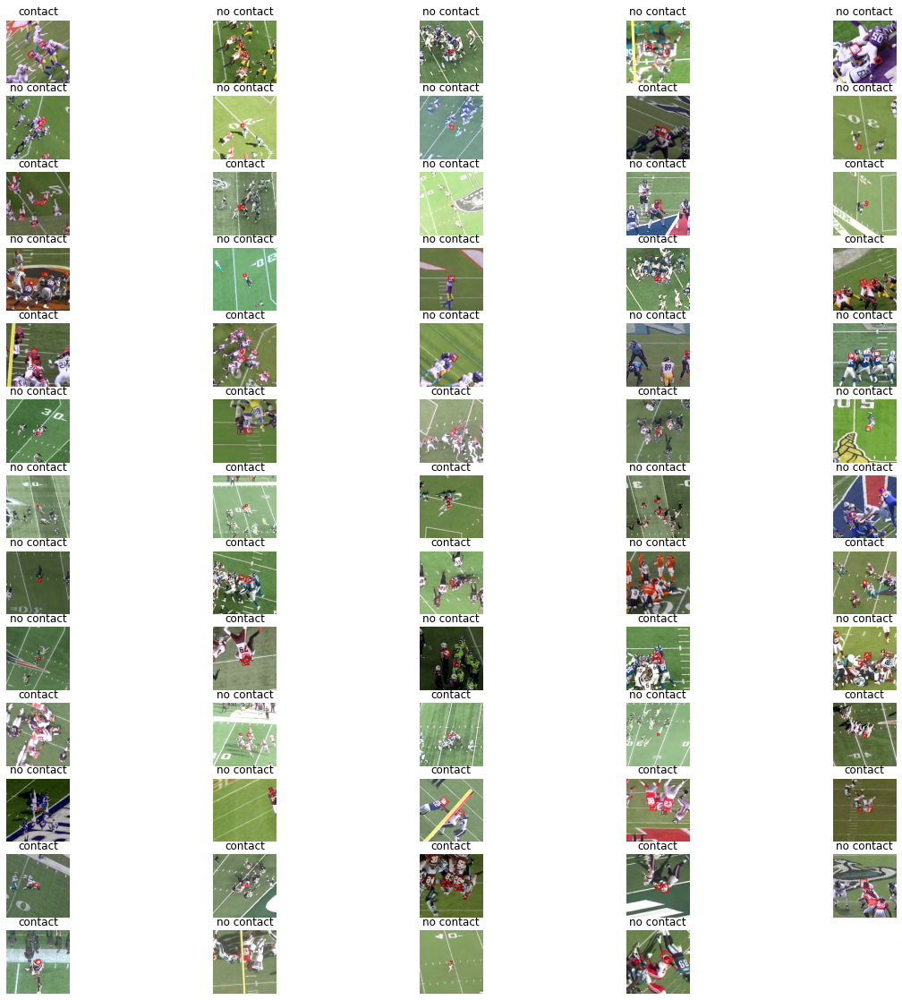

In [24]:
batch = next(iter(train_loader))

means = (0.485, 0.456, 0.406) # the means used to normalize the data
stds = (0.229, 0.224, 0.225) # the stds used to normalize the data
visualize_batch(batch, means, stds)

In [25]:
import wandb
from fastai.callback.wandb import *

In [26]:
wandb.init(project='nfl-1st-and-future', group='experiments', name=f'rgb-bbox-2', force=True)

epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▁▁▁▁▁▁▁▂▂▂▂▂▂▃▃▃▄▄▄▄▅▅▅▅▆▆▆▇▇▇▇▇▇███████
mom_0,███████▇▇▇▇▇▇▆▆▆▅▅▅▅▄▄▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁
raw_loss,█▆▆▅▅▄▇▃▄▃▃▃▂▄▄▃▂▂▂▂▂▂▁▁▁▁▁▂▁▂▂▂▁▁▂▁▁▂▂▁
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,█▇▇▇▆▆▅▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_samples_per_sec,█▇▇▆▆▅▅▅▅▃▅▅▅▄▄▁▅▅▄▅▅▃▅▅▅▄▅▃▃▅▅▅▄▄▅▄▅▅▅▅
wd_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,1.0
eps_0,1e-05


In [27]:
seed = 42
name = 'rgb-bbox-2'

set_seed(42, True)

data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                cbs=[
                        WandbCallback(log_preds=False, seed=seed),
                        SaveModelCallback(monitor='matthews_corrcoef', fname=name),
                        # MixUp()
                ]
               ).to_fp16()

In [28]:
learn.fine_tune(5, 1e-3)

Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.391582,0.422571,0.793368,0.470478,0.920236,0.328771,0.484460,18:00


Better model found at epoch 0 with matthews_corrcoef value: 0.4704781459797519.
Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.306858,0.332779,0.846171,0.541516,0.916945,0.400073,0.557084,18:03
1,0.290143,0.315969,0.860960,0.559413,0.903487,0.425200,0.578259,18:03
2,0.265289,0.249347,0.891191,0.600897,0.867829,0.491133,0.627272,18:05
3,0.222828,0.238524,0.896332,0.614219,0.872986,0.505029,0.639882,18:06
4,0.198454,0.249595,0.893357,0.611658,0.882073,0.496956,0.635739,18:04


Better model found at epoch 0 with matthews_corrcoef value: 0.5415160314051762.
Better model found at epoch 1 with matthews_corrcoef value: 0.5594131858173642.
Better model found at epoch 2 with matthews_corrcoef value: 0.6008966305967747.
Better model found at epoch 3 with matthews_corrcoef value: 0.6142190939109099.


### rgb-bbox-3

In [10]:
frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                      kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_every_n_frame_val=6, sample_train=None,
                      sample_val=None, undersample_no_contact=True).copy()

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, helmets=True, crop_size=256)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, helmets=True, crop_size=256)

train_loader = DataLoader(
    train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=64, shuffle=False, num_workers=8, pin_memory=True,
)

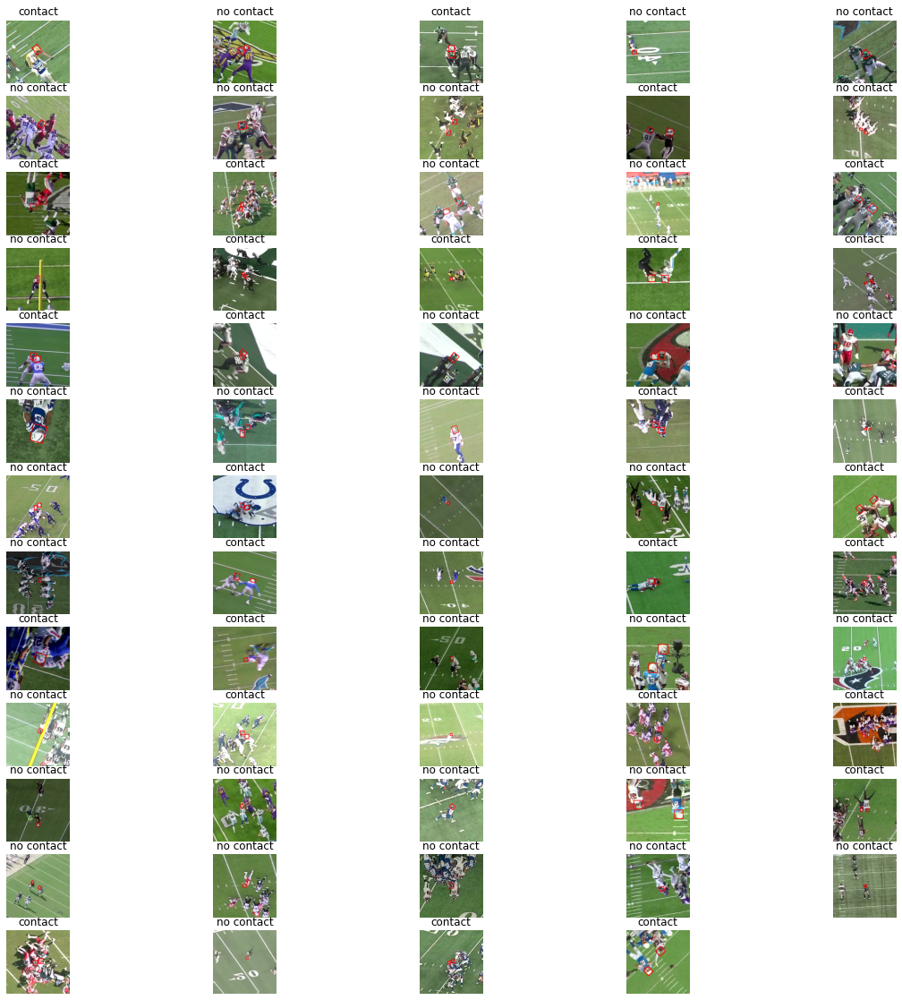

In [11]:
batch = next(iter(train_loader))

means = (0.485, 0.456, 0.406) # the means used to normalize the data
stds = (0.229, 0.224, 0.225) # the stds used to normalize the data
visualize_batch(batch, means, stds)

In [12]:
import wandb
from fastai.callback.wandb import *

In [13]:
wandb.init(project='nfl-1st-and-future', group='experiments', name=f'rgb-bbox-3', force=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [15]:
seed = 42
name = 'rgb-bbox-3'

set_seed(42, True)

data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                cbs=[
                        WandbCallback(log_preds=False, seed=seed),
                        SaveModelCallback(monitor='matthews_corrcoef', fname=name),
                        # MixUp()
                ]
               ).to_fp16()

SuggestedLRs(valley=0.0002290867705596611)

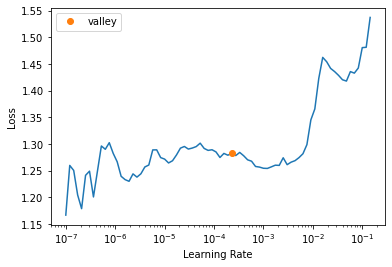

In [16]:
learn.lr_find()

In [ ]:
learn.fine_tune(10, 1e-3)

Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.341736,0.297766,0.866790,0.558744,0.879912,0.435073,0.582251,30:54


Better model found at epoch 0 with matthews_corrcoef value: 0.5587438372105846.
Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.264334,0.238840,0.891409,0.604082,0.874116,0.491766,0.629425,30:56
1,0.255125,0.248896,0.885994,0.599817,0.890029,0.478341,0.622255,30:54
2,0.257061,0.264012,0.878594,0.583791,0.886788,0.460834,0.606493,30:56
3,0.227206,0.266868,0.883056,0.592640,0.887083,0.471197,0.615471,30:57
4,0.211920,0.250011,0.896347,0.607387,0.856876,0.505169,0.635613,31:13
5,0.194413,0.254886,0.897415,0.607931,0.852554,0.508242,0.636839,30:58
6,0.156074,0.219764,0.912406,0.622020,0.798084,0.559500,0.657828,30:58
7,0.136962,0.257426,0.912307,0.615655,0.782809,0.560428,0.653210,30:57


Better model found at epoch 0 with matthews_corrcoef value: 0.6040818156178381.


IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Better model found at epoch 4 with matthews_corrcoef value: 0.607386599197178.
Better model found at epoch 5 with matthews_corrcoef value: 0.6079308700406786.
Better model found at epoch 6 with matthews_corrcoef value: 0.6220200106354898.


## Frame Classification with Mixup

In [8]:
from torch.utils.data import Dataset, DataLoader
import functools

def get_frames_df(df_combo, kf_dict, split, frames_path, sample_every_n_frame=None, sample_every_n_frame_train=None, sample_every_n_frame_val=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, seed=42):
    
    set_seed(seed, True)
    
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % @sample_every_n_frame == 0')
        val_combo = val_combo.query('(290 - frame) % @sample_every_n_frame == 0')
        
    if sample_every_n_frame_train is not None:
        train_combo = train_combo.query('(290 - frame) % @sample_every_n_frame_train == 0')
        
    if sample_every_n_frame_val is not None:
        val_combo = val_combo.query('(290 - frame) % @sample_every_n_frame_val == 0')
    
    if sample_train is not None:
        train_combo = train_combo.sample(frac=sample_train, random_state=seed)
        
    if sample_val is not None:
        val_combo = val_combo.sample(frac=sample_val, random_state=seed)
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])

    frames_df = pd.concat([train_combo, val_combo], axis=0)
    frames_df.frame = frames_df.frame.astype('int') 
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
        
    # frames_df['path'] = frames_df.apply(lambda x: get_frame_path(x, frames_path), axis=1)
        
    return frames_df


def add_helmet_heatmap(frame, row):
    chan1 = cv2.cvtColor(frame.copy(), cv2.COLOR_RGB2GRAY)
    chan2 = np.zeros_like(chan1)
    chan3 = np.zeros_like(chan1)
    
    chan2[int(row.top_1):int(row.top_1+row.height_1), 
          int(row.left_1):int(row.left_1+row.width_1)] = 255
    
    
    if not np.isnan(row.left_2):
        
        chan3[int(row.top_2):int(row.top_2+row.height_2), 
              int(row.left_2):int(row.left_2+row.width_2)] = 255
        
    return np.stack([chan1, chan2, chan3], axis=-1)


def add_helmets(frame, row):
    frame = frame.copy()
    frame = cv2.rectangle(frame, 
                          (int(row.left_1), int(row.top_1)),
                          (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                          (255, 0, 0), 2)
    
    if not np.isnan(row.left_2):
        frame = cv2.rectangle(frame, 
                              (int(row.left_2), int(row.top_2)),
                              (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                              (255, 0, 0), 2)
    return frame

@functools.lru_cache(maxsize=1250)
def _get_frame(path):
    frame = cv2.imread(path)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    return frame


class NFLFrameDataset(Dataset):
    def __init__(self, frames_df, transform=None, crop_size=256, helmets=True):
        self.frames_df = frames_df
        self.helmets = helmets
        self.crop_size = crop_size
        self.transform = transform
        
    def __len__(self):
        return len(self.frames_df)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        frame = self.get_frame(row.path)
        if self.helmets:
            frame = add_helmets(frame, row)
            # frame = add_helmet_heatmap(frame, row)
            
        frame = crop_frame(frame, row.center_x, row.center_y, self.crop_size)
        if self.transform is not None:
            frame = self.transform(image=frame)['image']
        return frame, row.contact
            
    def get_video_readers(self, frames_df, vids_path, views, h, w, ctx):
        video_readers = {}
        for gp in frames_df.game_play.unique():
            for view in views:
                # Each value will contain the video reader and the last seeked frame
                video_readers[(gp, view)] = [VideoReader((BASE_DIR/'train'/f'{gp}_{view}.mp4').as_posix(), ctx=ctx, height=h, width=w), 0]
        return video_readers
    
    def get_frame(self, path):
        return _get_frame(path)
    
def crop_frame(frame, x, y, size):
    size = size // 2
    
    if y-size < 0:
        min_y = 0
        max_y = min_y + 2*size
        
    elif y+size > 719:
        min_y = 719 - 2*size
        max_y = 719
        
    else:
        min_y = y - size
        max_y = y + size
    
    if x-size < 0:
        min_x = 0
        max_x = min_x + 2*size
        
    elif x+size > 1279:
        min_x = 1279 - 2*size
        max_x = 1279
        
    else:
        min_x = x - size
        max_x = x + size
        
    cropped_frame = frame[int(min_y):int(max_y), 
                          int(min_x):int(max_x), :]
    return cropped_frame
    
def visualize_batch(batch, means, stds):
    """
    Visualize a batch of image data using Matplotlib.
    
    Parameters:
        - batch_tensor (torch.Tensor): A batch of image data in the shape (batch_size, channels, height, width).
        - means (tuple): A tuple of means for each channel in the image data.
        - stds (tuple): A tuple of standard deviations for each channel in the image data.
    """
    # Make a copy of the batch tensor so that we don't modify the original data
    batch_tensor = batch[0].clone()
    
    # De-normalize the data using the means and stds
    batch_tensor = batch_tensor * torch.tensor(stds, dtype=batch_tensor.dtype).view(3, 1, 1) + torch.tensor(means, dtype=batch_tensor.dtype).view(3, 1, 1)
    
    # Convert the data to numpy and transpose it to (batch_size, height, width, channels)
    batch_np = batch_tensor.numpy().transpose(0, 2, 3, 1)
    
    # Plot the images
    plt.figure(figsize=(20, 20))
    for i in range(batch_np.shape[0]):
        plt.subplot(batch_np.shape[0] // 5 + 1, 5, i + 1)
        plt.imshow(batch_np[i])
        plt.title(['no contact', 'contact'][batch[1][i].item()])
        plt.axis("off")
    plt.show()

In [ ]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.HorizontalFlip(),
        A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

In [ ]:
frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                      kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_every_n_frame_val=6, sample_train=None,
                      sample_val=None, undersample_no_contact=True).copy()

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, helmets=True, crop_size=256)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, helmets=True, crop_size=256)

train_loader = DataLoader(
    train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
)

In [ ]:
batch = next(iter(train_loader))

means = (0.485, 0.456, 0.406) # the means used to normalize the data
stds = (0.229, 0.224, 0.225) # the stds used to normalize the data
visualize_batch(batch, means, stds)

AttributeError: Caught AttributeError in DataLoader worker process 0.
Original Traceback (most recent call last):
  File "/usr/local/lib/python3.9/dist-packages/torch/utils/data/_utils/worker.py", line 302, in _worker_loop
    data = fetcher.fetch(index)
  File "/usr/local/lib/python3.9/dist-packages/torch/utils/data/_utils/fetch.py", line 49, in fetch
    data = [self.dataset[idx] for idx in possibly_batched_index]
  File "/usr/local/lib/python3.9/dist-packages/torch/utils/data/_utils/fetch.py", line 49, in <listcomp>
    data = [self.dataset[idx] for idx in possibly_batched_index]
  File "/tmp/ipykernel_609/1741755805.py", line 102, in __getitem__
    frame = self.get_frame(row.path)
  File "/usr/local/lib/python3.9/dist-packages/pandas/core/generic.py", line 5575, in __getattr__
    return object.__getattribute__(self, name)
AttributeError: 'Series' object has no attribute 'path'


In [13]:
import wandb
from fastai.callback.wandb import *

In [14]:
wandb.init(project='nfl-1st-and-future', group='experiments', name=f'rgb-bbox-mixup', force=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [15]:
seed = 42
name = 'rgb-bbox-mixup'

set_seed(42, True)

data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                cbs=[
                        WandbCallback(log_preds=False, seed=seed),
                        SaveModelCallback(monitor='matthews_corrcoef', fname=name),
                        MixUp()
                ]
               ).to_fp16()

Downloading: "https://dl.fbaipublicfiles.com/convnext/convnext_tiny_1k_224_ema.pth" to /root/.cache/torch/hub/checkpoints/convnext_tiny_1k_224_ema.pth


SuggestedLRs(valley=0.0002754228771664202)

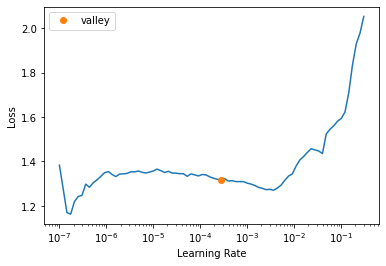

In [16]:
learn.lr_find()

In [17]:
learn.fit_one_cycle(1, 1e-3)

Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.411424,0.282112,0.877211,0.591897,0.910806,0.458737,0.610161,21:16


Better model found at epoch 0 with matthews_corrcoef value: 0.5918966332119873.


SuggestedLRs(valley=0.00013182566908653826)

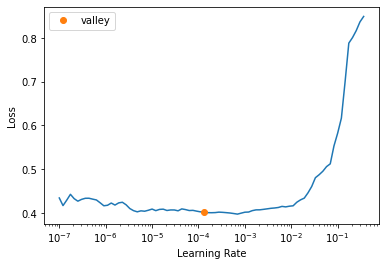

In [ ]:
learn.unfreeze()
learn.lr_find()

In [20]:
learn.fit_one_cycle(12, 1e-4)

Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.410585,0.237085,0.896819,0.620233,0.884627,0.506297,0.644009,21:17
1,0.393497,0.254794,0.889393,0.612513,0.903291,0.486960,0.632787,21:28
2,0.380726,0.234269,0.900514,0.626783,0.880697,0.516729,0.651314,21:36
3,0.366733,0.258407,0.888528,0.611789,0.905697,0.484855,0.631593,22:12
4,0.363053,0.235498,0.901985,0.626256,0.871415,0.521226,0.652291,21:43
5,0.351932,0.265246,0.891186,0.614009,0.898183,0.491414,0.635263,21:58
6,0.343426,0.248592,0.898664,0.621833,0.878782,0.511492,0.646621,21:31
7,0.328636,0.269777,0.895896,0.616779,0.881238,0.503791,0.641083,21:47
8,0.317972,0.258219,0.901068,0.621260,0.864489,0.518683,0.648359,21:39
9,0.312001,0.265076,0.902472,0.619935,0.853536,0.523166,0.648711,21:46


Better model found at epoch 0 with matthews_corrcoef value: 0.6202325033537409.
Better model found at epoch 2 with matthews_corrcoef value: 0.6267832791932344.


In [10]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.HorizontalFlip(),
        A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)


frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                      kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=None,
                      sample_val=None, undersample_no_contact=True).copy()

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, helmets=True, crop_size=256)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, helmets=True, crop_size=256)

train_loader = DataLoader(
    train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
)

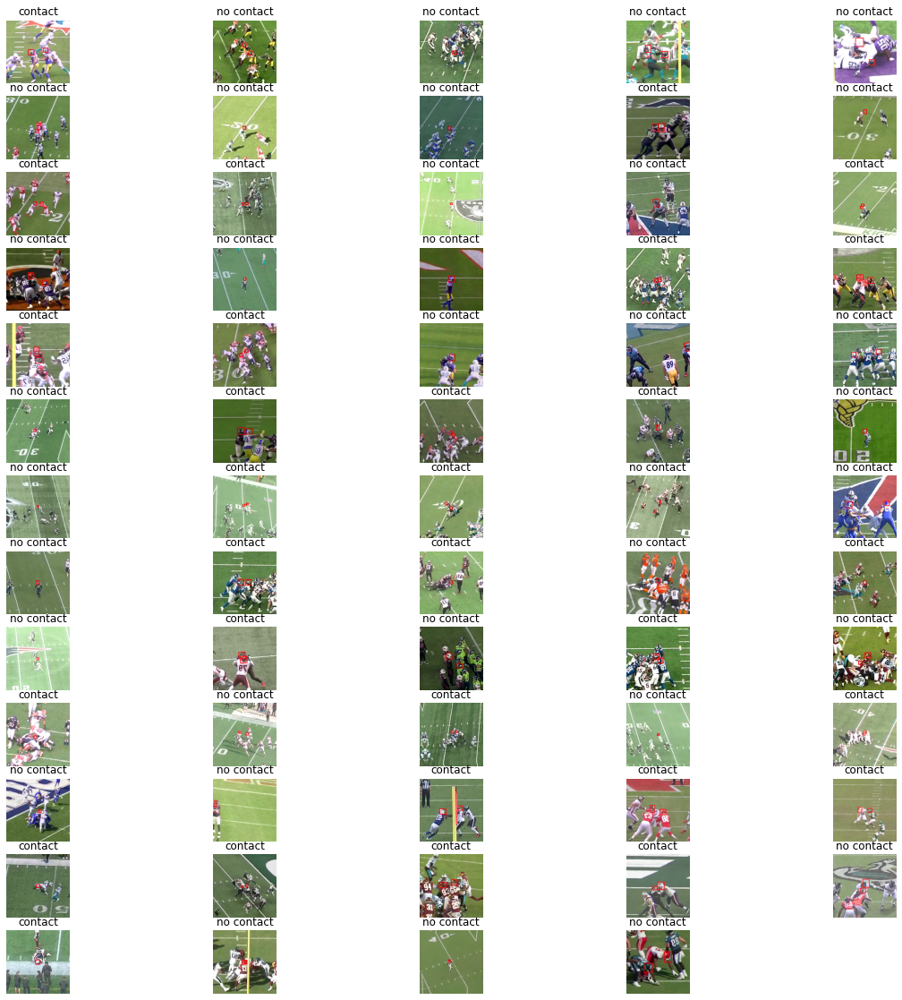

In [11]:
batch = next(iter(train_loader))

means = (0.485, 0.456, 0.406) # the means used to normalize the data
stds = (0.229, 0.224, 0.225) # the stds used to normalize the data
visualize_batch(batch, means, stds)

In [12]:
import wandb
from fastai.callback.wandb import *

In [13]:
name = 'rgb-bbox-mixup-convnext-base'

wandb.init(project='nfl-1st-and-future', group='experiments', name=f'rgb-bbox-mixup', force=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [14]:
seed = 42

set_seed(42, True)

data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_base', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                cbs=[
                        WandbCallback(log_preds=False, seed=seed),
                        SaveModelCallback(monitor='f1_score', fname=name),
                        MixUp()
                ]
               ).to_fp16()

Downloading: "https://dl.fbaipublicfiles.com/convnext/convnext_base_1k_224_ema.pth" to /root/.cache/torch/hub/checkpoints/convnext_base_1k_224_ema.pth


In [ ]:
learn.fine_tune(10, 1e-3)

Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.472680,0.336467,0.843409,0.517945,0.876424,0.391771,0.541490,38:12


Better model found at epoch 0 with f1_score value: 0.5414902817606627.
Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.406091,0.252039,0.887673,0.606311,0.897102,0.482601,0.627588,38:55
1,0.403521,0.290013,0.860784,0.570648,0.928487,0.426592,0.584593,38:22
2,0.389452,0.270015,0.880382,0.592848,0.899361,0.465384,0.613372,38:54
3,0.384222,0.232600,0.897239,0.616302,0.873183,0.507551,0.641956,45:54
4,0.360414,0.261548,0.890658,0.608134,0.887132,0.489950,0.631263,38:29
5,0.353136,0.231960,0.901747,0.624829,0.869303,0.520574,0.651189,38:59
6,0.313221,0.284432,0.893922,0.611372,0.878585,0.498453,0.636052,38:17


Better model found at epoch 0 with f1_score value: 0.6275877471781744.
Better model found at epoch 3 with f1_score value: 0.6419556935743045.


## New 2.5D Pipeline

Each row passed to the dataloader should contain images of the 6 channels, and I'll do as if it was frame classification, but will just add frames before and after.

In [4]:
def get_frame_path(row, frames_path, split=None):
    frames = tuple()
    not_found = None
    shifts = [-4, -3, -2, -1, 0, 1, 2, 3, 4]
    for s in shifts:
        frame = row['frame']+s if len(str(row['frame'])) > 3 else f'0{row["frame"]+s}'
        game_play = row['game_play']
        view = row['view']
        frame_path = f'{frames_path}/{game_play}_{view}.mp4_{frame}.jpg'
        if os.path.exists(frame_path):
            frames += tuple([frame_path])
        else:
            not_found = s
    if not_found is not None:
        if not_found > 0:
            frames_path = frames_path + frames_path[-1:]*(len(frames_path)-len(shifts))
        else:
            frames_path = frames_path[:1]*(len(frames_path)-len(shifts)) + frames_path
    
    return frames

In [5]:
def get_frames_df(df_combo, kf_dict, split, frames_path, sample_every_n_frame=None, sample_every_n_frame_train=None, sample_every_n_frame_val=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, seed=42):
    
    set_seed(seed, True)
    
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % @sample_every_n_frame == 0')
        val_combo = val_combo.query('(290 - frame) % @sample_every_n_frame == 0')
        
    if sample_every_n_frame_train is not None:
        train_combo = train_combo.query('(290 - frame) % @sample_every_n_frame_train == 0')
        
    if sample_every_n_frame_val is not None:
        val_combo = val_combo.query('(290 - frame) % @sample_every_n_frame_val == 0')
    
    if sample_train is not None:
        train_combo = train_combo.sample(frac=sample_train, random_state=seed)
        
    if sample_val is not None:
        val_combo = val_combo.sample(frac=sample_val, random_state=seed)
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])

    frames_df = pd.concat([train_combo, val_combo], axis=0)
    frames_df.frame = frames_df.frame.astype('int') 
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
        
    # frames_df['path'] = frames_df.apply(lambda x: get_frame_path(x, frames_path), axis=1)
        
    return frames_df

In [7]:
from torch.utils.data import Dataset, DataLoader
import functools

@functools.lru_cache(maxsize=1200)
def _get_frame(path):
    frame = cv2.imread(path)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    return frame


def add_helmets(frame, row):
    frame = frame.copy()
    frame = cv2.rectangle(frame, 
                          (int(row.left_1), int(row.top_1)),
                          (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                          (255, 0, 0), 2)
    
    if not np.isnan(row.left_2):
        frame = cv2.rectangle(frame, 
                              (int(row.left_2), int(row.top_2)),
                              (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                              (255, 0, 0), 2)
    return frame



class NFL25DDataset(Dataset):
    def __init__(self, frames_df, transform=None, crop_size=256, helmets=True, sample=1):
        self.frames_df = frames_df
        self.helmets = helmets
        self.crop_size = crop_size
        self.transform = transform
        self.sample = sample
        
    def __len__(self):
        return int(len(self.frames_df)*self.sample)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        
        # Read frames
        frames = []
        not_found = None
        shifts = [-1, 0, 1]
        for s in shifts:
            frame = row['frame']+s if len(str(row['frame'])) > 3 else f'0{row["frame"]+s}'
            game_play = row['game_play']
            view = row['view']
            frame_path = f'{CFG.frames_path}/{game_play}_{view}.mp4_{frame}.jpg'
            if os.path.exists(frame_path):
                frames += [add_helmets(self.get_frame(frame_path), row)]
            else:
                not_found = s
        if not_found is not None:
            if not_found > 0:
                frames = frames + frames[-1:]*(len(shifts)-len(frames))
            else:
                frames = frames[:1]*(len(shifts)-len(frames)) + frames
                
        # Convert all frames to gray scale and stack them
        frame = np.concatenate(frames, axis=-1)
        frame = crop_frame(frame, row.center_x, row.center_y, self.crop_size)
        
        if self.transform is not None:
            frame = self.transform(image=frame)['image']
            
        return frame, row.contact
    
    def get_frame(self, path):
        return _get_frame(path)
    
def crop_frame(frame, x, y, size):
    size = size // 2
    
    if y-size < 0:
        min_y = 0
        max_y = min_y + 2*size
        
    elif y+size > 719:
        min_y = 719 - 2*size
        max_y = 719
        
    else:
        min_y = y - size
        max_y = y + size
    
    if x-size < 0:
        min_x = 0
        max_x = min_x + 2*size
        
    elif x+size > 1279:
        min_x = 1279 - 2*size
        max_x = 1279
        
    else:
        min_x = x - size
        max_x = x + size
        
    cropped_frame = frame[int(min_y):int(max_y), 
                          int(min_x):int(max_x), :]
    return cropped_frame
    
    
def visualize_batch(batch, means, stds):
    """
    Visualize a batch of image data using Matplotlib.
    
    Parameters:
        - batch_tensor (torch.Tensor): A batch of image data in the shape (batch_size, channels, height, width).
        - means (tuple): A tuple of means for each channel in the image data.
        - stds (tuple): A tuple of standard deviations for each channel in the image data.
    """
    # Make a copy of the batch tensor so that we don't modify the original data
    batch_tensor = batch[0].clone()
    
    # Get batch channels no
    channels = batch_tensor.shape[1]
    
    # De-normalize the data using the means and stds
    batch_tensor = batch_tensor * torch.tensor(stds[:channels], dtype=batch_tensor.dtype).view(channels, 1, 1) + torch.tensor(means[:channels], dtype=batch_tensor.dtype).view(channels, 1, 1)
    
    # Convert the data to numpy and transpose it to (batch_size, height, width, channels)
    batch_np = batch_tensor.numpy().transpose(0, 2, 3, 1)
    
    # Plot the images
    plt.figure(figsize=(20, 20))
    for i in range(batch_np.shape[0]):
        plt.subplot(batch_np.shape[0] // 5 + 1, 5, i + 1)
        plt.imshow(batch_np[i][..., [1, 2, 3]])
        plt.title(['no contact', 'contact'][batch[1][i].item()])
        plt.axis("off")
    plt.show()

In [8]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

channels = 9

means = [0.485, 0.456, 0.406]*3
stds = [0.229, 0.224, 0.225]*3

train_transform = A.Compose(
    [
        # A.Resize(crop_size, crop_size),
        A.HorizontalFlip(),
        A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        # A.Resize(crop_size, crop_size),
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)

In [22]:
frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                          kf_dict,
                          split=0,
                          frames_path=CFG.frames_path, 
                          sample_every_n_frame_train=3,
                          sample_every_n_frame_val=3, 
                          sample_train=None,
                          sample_val=0.07,
                          undersample_no_contact=True)

In [23]:
train_ds = NFL25DDataset(frames_df.query('~is_valid'), transform=train_transform, crop_size=256)
val_ds = NFL25DDataset(frames_df.query('is_valid'), transform=val_transform, crop_size=256)

In [24]:
train_loader = DataLoader(
    train_ds, batch_size=32, shuffle=True, num_workers=8, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=32, shuffle=False, num_workers=8, pin_memory=True,
)

# batch = next(iter(train_loader))
# visualize_batch(batch, means, stds)

In [25]:
import wandb
from fastai.callback.wandb import *

In [26]:
name = '2.5D-3-rgb-frames-convnext-tiny'
wandb.init(project='nfl-1st-and-future', group='experiments', name=name, force=True)

epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇██
mom_0,█████████▇▇▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▁▁
raw_loss,█▆█▆▆▅▇▅▅▆▅▅▅▄▃▄▃▃▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,██▇▇▇▇▇▆▆▆▆▅▅▄▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_samples_per_sec,█▁▇▆▇█▇█▃█▇▆▆▇▇▃▅▄▇▇▇▆▅▅▇█▇▅▅▄▆▇▃▆▄▇▄█▅▆
wd_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,0.58641
eps_0,1e-05


In [27]:
set_seed(42, True)

data = DataLoaders(train_loader, val_loader)
    
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=channels)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                cbs=[
                    WandbCallback(log_preds=False, seed=42),
                    SaveModelCallback(monitor='matthews_corrcoef', fname=name, every_epoch=True),
                    GradientAccumulation(64),
                    # MixUp()
                ]
               ).to_fp16()

SuggestedLRs(valley=0.0010000000474974513)

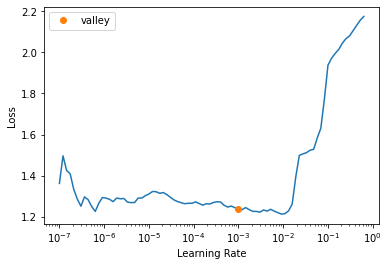

In [20]:
learn.lr_find()

In [ ]:
learn.fine_tune(5, 1e-3)

Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.320221,0.248389,0.893026,0.598714,0.849116,0.499286,0.628821,1:16:02


Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.228704,0.309926,0.865339,0.573399,0.913285,0.437303,0.591420,1:17:10
1,0.239599,0.261095,0.876370,0.586043,0.896982,0.459407,0.607613,1:17:53


## RAFT

### Create frames_df with 10% of training data and full validation

In [8]:
def get_frame_path(row, frames_path, split=None):
    frames = tuple()
    not_found = None
    shifts = [-1, 0, 1]
    for s in shifts:
        frame = row['frame']+s if len(str(row['frame'])) > 3 else f'0{row["frame"]+s}'
        game_play = row['game_play']
        view = row['view']
        frame_path = f'{frames_path}/{game_play}_{view}.mp4_{frame}.jpg'
        if os.path.exists(frame_path):
            frames += tuple([frame_path])
        else:
            not_found = s
    if not_found is not None:
        if not_found > s:
            frames_path = frames_path + frames_path[-1:]*(len(frames_path)-len(shifts))
        else:
            frames_path = frames_path[:1]*(len(frames_path)-len(shifts)) + frames_path
    
    return frames

In [9]:
from torch.utils.data import Dataset, DataLoader
import functools

def get_frames_df(df_combo, kf_dict, split, frames_path, sample_every_n_frame=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, seed=42):
    
    set_seed(seed, True)
    
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % 6 == 0')
        val_combo = val_combo.query('(290 - frame) % 6 == 0')
    
    if sample_train is not None:
        train_combo = train_combo.sample(frac=sample_train, random_state=seed)
        
    if sample_val is not None:
        val_combo = val_combo.sample(frac=sample_val, random_state=seed)
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])

    frames_df = pd.concat([train_combo, val_combo], axis=0)
    frames_df.frame = frames_df.frame.astype('int') 
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
        
    frames_df['path'] = frames_df.apply(lambda x: get_frame_path(x, frames_path), axis=1)
        
    return frames_df


In [10]:
frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                          kf_dict,
                          split=0,
                          frames_path=CFG.frames_path, 
                          sample_every_n_frame=3, 
                          sample_train=0.1,
                          sample_val=None,
                          undersample_no_contact=True).copy()

In [11]:
print(frames_df.shape)
frames_df = frames_df.drop_duplicates('path').sort_values(['game_play', 'frame'])
print(frames_df.shape)

(209933, 33)
(19464, 33)


### Create RAFT Dataloader

In [19]:
from torchvision.transforms import ToTensor

@functools.lru_cache(maxsize=1200)
def _get_frame(path):
    frame = cv2.imread(path)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    return frame


class NFLRaftDataset(Dataset):
    def __init__(self, frames_df, transform=None):
        self.frames_df = frames_df
        self.transform = None
        
    def __len__(self):
        return len(self.frames_df)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        
        frames = [self.get_frame(p) for p in row.path]
        frames = [ToTensor()(f) for f in frames]
        
        frames_1 = torch.stack([frames[0], frames[1]], axis=0)
        frames_2 = torch.stack([frames[1], frames[2]], axis=0)
        
        if self.transform is not None:
            frames_1, frames_2 = self.transform(frames_1, frames_2)
        
        return frames_1, frames_2

    def get_frame(self, path):
        return _get_frame(path)
    
def collate_fn(batch):
    batch_1 = torch.concat([item[0] for item in batch], axis=0)
    batch_2 = torch.concat([item[1] for item in batch], axis=0)
    
    return [batch_1, batch_2]
    
def visualize_raft_batch(batch):
    """
    Visualize a batch of image data using Matplotlib.
    
    Parameters:
        - batch_tensor (torch.Tensor): A batch of image data in the shape (batch_size, channels, height, width).
        - means (tuple): A tuple of means for each channel in the image data.
        - stds (tuple): A tuple of standard deviations for each channel in the image data.
    """
    # Make a copy of the batch tensor so that we don't modify the original data
    batch_tensor_0 = batch[0].clone()
    batch_tensor_1 = batch[1].clone()
        
    # Convert the data to numpy and transpose it to (batch_size, height, width, channels)
    batch_np_0 = batch_tensor_0.numpy().transpose(0, 2, 3, 1)
    batch_np_1 = batch_tensor_1.numpy().transpose(0, 2, 3, 1)
    
    # Plot the images
    plt.figure(figsize=(20, 20))
    for i in range(batch_np_0.shape[0]):
        plt.subplot(batch_np_0.shape[0] // 5 + 1, 5, i + 1)
        plt.imshow(np.concatenate((batch_np_0[i], batch_np_1[i]), axis=1))
        plt.axis("off")
    plt.show()

In [13]:
raft_ds = NFLRaftDataset(frames_df)
raft_dl = DataLoader(raft_ds, batch_size=2, shuffle=False, num_workers=8, pin_memory=True, collate_fn=collate_fn)

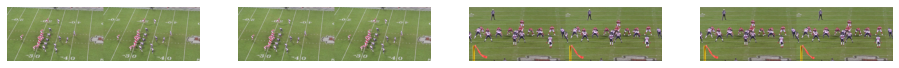

In [14]:
batch = next(iter(raft_dl))
visualize_raft_batch(batch)

### Run Inference

In [20]:
from torchvision.models.optical_flow import Raft_Small_Weights, raft_small

weights = Raft_Small_Weights.DEFAULT
transforms = weights.transforms()

device = "cuda" if torch.cuda.is_available() else "cpu"

model = raft_small(weights=weights, progress=False).to(device)
model = model.eval()

In [23]:
raft_ds = NFLRaftDataset(frames_df, transform=transforms)
raft_dl = DataLoader(raft_ds, batch_size=1, shuffle=False, num_workers=1, pin_memory=True, collate_fn=collate_fn)

In [24]:
batch = next(iter(raft_dl))
batch[0].shape, batch[1].shape

(torch.Size([2, 3, 720, 1280]), torch.Size([2, 3, 720, 1280]))

In [25]:
import gc

for i, b in enumerate(tqdm(raft_dl)):
    b_0, b_1 = b[0].cuda(), b[1].cuda()
    flow = model(b_0, b_1)[-1]
    row = frames_df.iloc[i]
    
    # Get flow frames names
    flow_path_1 = 'raft_output/'+row.path[1].split('/')[-1] + '_' + row.path[0].split('/')[-1]
    flow_path_2 = 'raft_output/'+row.path[1].split('/')[-1] + '_' + row.path[-1].split('/')[-1]
        
    # Convert flow to numpy
    flow_1 = np.concatenate([flow[0].permute(1,2,0).detach().cpu().numpy(), np.zeros((720, 1280, 1))], axis=-1)
    flow_2 = np.concatenate([flow[1].permute(1,2,0).detach().cpu().numpy(), np.zeros((720, 1280, 1))], axis=-1)
    
    # Save flow
    cv2.imwrite(flow_path_1, flow_1)
    cv2.imwrite(flow_path_2, flow_2)
    
    del b_0, b_1, flow, flow_1, flow_2
    
    gc.collect()

  0%|          | 0/19464 [00:00<?, ?it/s]

### Train a model using raft optical flow in input

In [10]:
@functools.lru_cache(maxsize=1200)
def _get_frame(path):
    frame = cv2.imread(path)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    return frame


def add_helmets(frame, row):
    frame = frame.copy()
    frame = cv2.rectangle(frame, 
                          (int(row.left_1), int(row.top_1)),
                          (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                          (255, 0, 0), 2)
    
    if not np.isnan(row.left_2):
        frame = cv2.rectangle(frame, 
                              (int(row.left_2), int(row.top_2)),
                              (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                              (255, 0, 0), 2)
    return frame



class NFLFrameDataset(Dataset):
    def __init__(self, frames_df, transform=None, crop_size=256, helmets=True):
        self.frames_df = frames_df
        self.helmets = helmets
        self.crop_size = crop_size
        self.transform = transform
        
    def __len__(self):
        return len(self.frames_df)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        
        # Read frames
        frames = [self.get_frame(p) for p in row.path]
        
        # Read optical flows
        flow_path_1 = 'raft_output/'+row.path[1].split('/')[-1] + '_' + row.path[0].split('/')[-1]
        flow_path_2 = 'raft_output/'+row.path[1].split('/')[-1] + '_' + row.path[-1].split('/')[-1]
        
        flow_1 = cv2.cvtColor(cv2.imread(flow_path_1), cv2.COLOR_BGR2RGB)[..., :-1]
        flow_2 = cv2.cvtColor(cv2.imread(flow_path_2), cv2.COLOR_BGR2RGB)[..., :-1]
        
        # Create remaps
        warped_frame_1 = cv2.remap(frames[0], flow_1, None, cv2.INTER_LINEAR)
        warped_frame_2 = cv2.remap(frames[1], flow_2, None, cv2.INTER_LINEAR)
        
        # Convert all frames to gray scale and stack them
        frame = np.stack([
            cv2.cvtColor(warped_frame_1, cv2.COLOR_RGB2GRAY),
            cv2.cvtColor(frame, cv2.COLOR_RGB2GRAY),
            cv2.cvtColor(warped_frame_2, cv2.COLOR_RGB2GRAY)
        ])
        
        # Add helmet bbox
        frame = add_helmets(frame, row)
        frame = crop_frame(frame, row.center_x, row.center_y, self.crop_size)
        if self.transform is not None:
            frame = self.transform(image=frame)['image']
        return frame, row.contact
    
    def get_frame(self, path):
        return _get_frame(path)
    
    
def visualize_batch(batch, means, stds):
    """
    Visualize a batch of image data using Matplotlib.
    
    Parameters:
        - batch_tensor (torch.Tensor): A batch of image data in the shape (batch_size, channels, height, width).
        - means (tuple): A tuple of means for each channel in the image data.
        - stds (tuple): A tuple of standard deviations for each channel in the image data.
    """
    # Make a copy of the batch tensor so that we don't modify the original data
    batch_tensor = batch[0].clone()
    
    # Get batch channels no
    channels = batch_tensor.shape[1]
    
    # De-normalize the data using the means and stds
    batch_tensor = batch_tensor * torch.tensor(stds[:channels], dtype=batch_tensor.dtype).view(channels, 1, 1) + torch.tensor(means[:channels], dtype=batch_tensor.dtype).view(channels, 1, 1)
    
    # Convert the data to numpy and transpose it to (batch_size, height, width, channels)
    batch_np = batch_tensor.numpy().transpose(0, 2, 3, 1)
    
    # Plot the images
    plt.figure(figsize=(20, 20))
    for i in range(batch_np.shape[0]):
        plt.subplot(batch_np.shape[0] // 5 + 1, 5, i + 1)
        plt.imshow(batch_np[i][..., 0])
        plt.title(['no contact', 'contact'][batch[1][i].item()])
        plt.axis("off")
    plt.show()

In [14]:
seed = 42
channels = 3
sample_train = 0.1
sample_val = None
bs = 2

frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                          kf_dict, 
                          0, 
                          frames_path=CFG.frames_path, 
                          sample_every_n_frame=3, 
                          sample_train=sample_train,
                          sample_val=sample_val,
                          undersample_no_contact=True,
                          seed=seed).copy()

In [15]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

means = [0.485, 0.456, 0.406]*2
stds = [0.229, 0.224, 0.225]*2

train_transform = A.Compose(
    [
        # A.Resize(crop_size, crop_size),
        A.HorizontalFlip(),
        A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        # A.Resize(crop_size, crop_size),
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)

In [16]:
train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, crop_size=256)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, crop_size=256)

In [18]:
train_loader = DataLoader(
    train_ds, batch_size=bs, shuffle=True, num_workers=8, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=bs, shuffle=True, num_workers=8, pin_memory=True,
)

batch = next(iter(train_loader))
visualize_batch(batch, means, stds)

error: Caught error in DataLoader worker process 0.
Original Traceback (most recent call last):
  File "/usr/local/lib/python3.9/dist-packages/torch/utils/data/_utils/worker.py", line 302, in _worker_loop
    data = fetcher.fetch(index)
  File "/usr/local/lib/python3.9/dist-packages/torch/utils/data/_utils/fetch.py", line 49, in fetch
    data = [self.dataset[idx] for idx in possibly_batched_index]
  File "/usr/local/lib/python3.9/dist-packages/torch/utils/data/_utils/fetch.py", line 49, in <listcomp>
    data = [self.dataset[idx] for idx in possibly_batched_index]
  File "/tmp/ipykernel_2224/3721386266.py", line 48, in __getitem__
    warped_frame_1 = cv2.remap(frames[0], flow_1, None, cv2.INTER_LINEAR)
cv2.error: OpenCV(4.7.0) /io/opencv/modules/imgproc/src/imgwarp.cpp:1814: error: (-215:Assertion failed) ((map1.type() == CV_32FC2 || map1.type() == CV_16SC2) && map2.empty()) || (map1.type() == CV_32FC1 && map2.type() == CV_32FC1) in function 'remap'



In [14]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
import wandb
from fastai.callback.wandb import *

def run_experiment(config, channels, name, bs=8, crop_size=128, sample_train=0.1, sample_val=0.07, seed=4121995):
    
    set_seed(seed, True)

    means = [0.485, 0.456, 0.406]*2
    stds = [0.229, 0.224, 0.225]*2

    train_transform = A.Compose(
        [
            # A.Resize(crop_size, crop_size),
            A.HorizontalFlip(),
            A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5),
            A.RandomBrightnessContrast(p=0.5),
            A.Normalize(mean=means[:channels], std=stds[:channels]),
            ToTensorV2(),
        ]
    )

    val_transform = A.Compose(
        [
            # A.Resize(crop_size, crop_size),
            A.Normalize(mean=means[:channels], std=stds[:channels]),
            ToTensorV2(),
        ]
    )


    frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                          kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=sample_train,
                          sample_val=sample_val, undersample_no_contact=True, seed=seed).copy()

    train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, crop_size=256, config=config)
    val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, crop_size=256, config=config)

    train_loader = DataLoader(
        train_ds, batch_size=bs, shuffle=True, num_workers=8, pin_memory=True,
    )

    val_loader = DataLoader(
        val_ds, batch_size=bs, shuffle=True, num_workers=8, pin_memory=True,
    )
    
    # batch = next(iter(train_loader))
    # visualize_batch(batch, means, stds)
    
    data = DataLoaders(train_loader, val_loader)
    
    model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=channels)
    learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                    cbs=[
                        # WandbCallback(log_preds=False, seed=seed),
                        SaveModelCallback(monitor='matthews_corrcoef', fname=name)
                    ]
                   ).to_fp16()
    
    return learn

## 2D gray scale with helmet heatmaps

In [10]:
from torch.utils.data import Dataset, DataLoader
import functools

def get_frames_df(df_combo, kf_dict, split, frames_path, sample_every_n_frame=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, seed=42):
    
    set_seed(seed, True)
    
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % 6 == 0')
        val_combo = val_combo.query('(290 - frame) % 6 == 0')
    
    if sample_train is not None:
        train_combo = train_combo.sample(frac=sample_train, random_state=seed)
        
    if sample_val is not None:
        val_combo = val_combo.sample(frac=sample_val, random_state=seed)
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])

    frames_df = pd.concat([train_combo, val_combo], axis=0)
    frames_df.frame = frames_df.frame.astype('int') 
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
        
    frames_df['path'] = frames_df.apply(lambda x: get_frame_path(x, frames_path), axis=1)
        
    return frames_df

def add_helmet_heatmap(frame, row):
    chan1 = cv2.cvtColor(frame.copy(), cv2.COLOR_RGB2GRAY)
    chan2 = np.zeros_like(chan1)
    chan3 = np.zeros_like(chan1)
    
    chan2[int(row.top_1):int(row.top_1+row.height_1), 
          int(row.left_1):int(row.left_1+row.width_1)] = 255
    
    
    if not np.isnan(row.left_2):
        
        chan3[int(row.top_2):int(row.top_2+row.height_2), 
              int(row.left_2):int(row.left_2+row.width_2)] = 255
        
    return np.stack([chan1, chan2, chan3], axis=-1)


def add_helmets(frame, row):
    frame = frame.copy()
    frame = cv2.rectangle(frame, 
                          (int(row.left_1), int(row.top_1)),
                          (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                          (255, 0, 0), 2)
    
    if not np.isnan(row.left_2):
        frame = cv2.rectangle(frame, 
                              (int(row.left_2), int(row.top_2)),
                              (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                              (255, 0, 0), 2)
    return frame

@functools.lru_cache(maxsize=1200)
def _get_frame(path):
    frame = cv2.imread(path)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    return frame


class NFLFrameDataset(Dataset):
    def __init__(self, frames_df, transform=None, crop_size=256, helmets=True):
        self.frames_df = frames_df
        self.helmets = helmets
        self.crop_size = crop_size
        self.transform = transform
        
    def __len__(self):
        return len(self.frames_df)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        frame = self.get_frame(row.path)
        if self.helmets:
            # frame = add_helmets(frame, row)
            frame = add_helmet_heatmap(frame, row)
            
        frame = crop_frame(frame, row.center_x, row.center_y, self.crop_size)
        if self.transform is not None:
            frame = self.transform(image=frame)['image']
        return frame, row.contact
            
    def get_video_readers(self, frames_df, vids_path, views, h, w, ctx):
        video_readers = {}
        for gp in frames_df.game_play.unique():
            for view in views:
                # Each value will contain the video reader and the last seeked frame
                video_readers[(gp, view)] = [VideoReader((BASE_DIR/'train'/f'{gp}_{view}.mp4').as_posix(), ctx=ctx, height=h, width=w), 0]
        return video_readers
    
    def get_frame(self, path):
        return _get_frame(path)
    
def crop_frame(frame, x, y, size):
    size = size // 2
    
    if y-size < 0:
        min_y = 0
        max_y = min_y + 2*size
        
    elif y+size > 719:
        min_y = 719 - 2*size
        max_y = 719
        
    else:
        min_y = y - size
        max_y = y + size
    
    if x-size < 0:
        min_x = 0
        max_x = min_x + 2*size
        
    elif x+size > 1279:
        min_x = 1279 - 2*size
        max_x = 1279
        
    else:
        min_x = x - size
        max_x = x + size
        
    cropped_frame = frame[int(min_y):int(max_y), 
                          int(min_x):int(max_x), :]
    return cropped_frame
    
def visualize_batch(batch, means, stds):
    """
    Visualize a batch of image data using Matplotlib.
    
    Parameters:
        - batch_tensor (torch.Tensor): A batch of image data in the shape (batch_size, channels, height, width).
        - means (tuple): A tuple of means for each channel in the image data.
        - stds (tuple): A tuple of standard deviations for each channel in the image data.
    """
    # Make a copy of the batch tensor so that we don't modify the original data
    batch_tensor = batch[0].clone()
    
    # De-normalize the data using the means and stds
    batch_tensor = batch_tensor * torch.tensor(stds, dtype=batch_tensor.dtype).view(3, 1, 1) + torch.tensor(means, dtype=batch_tensor.dtype).view(3, 1, 1)
    
    # Convert the data to numpy and transpose it to (batch_size, height, width, channels)
    batch_np = batch_tensor.numpy().transpose(0, 2, 3, 1)
    
    # Plot the images
    plt.figure(figsize=(20, 20))
    for i in range(batch_np.shape[0]):
        plt.subplot(batch_np.shape[0] // 5 + 1, 5, i + 1)
        plt.imshow(batch_np[i])
        plt.title(['no contact', 'contact'][batch[1][i].item()])
        plt.axis("off")
    plt.show()

In [11]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.HorizontalFlip(),
        A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)


frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                      kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=None,
                      sample_val=None, undersample_no_contact=True).copy()

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, helmets=True, crop_size=256)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, helmets=True, crop_size=256)

train_loader = DataLoader(
    train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
)

In [ ]:
batch = next(iter(train_loader))

means = (0.485, 0.456, 0.406) # the means used to normalize the data
stds = (0.229, 0.224, 0.225) # the stds used to normalize the data
visualize_batch(batch, means, stds)

In [ ]:
wandb.init(project='nfl-1st-and-future', group='helmet-channel', name=f'gray-image-2-helmet-channels', force=True)

In [ ]:
data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                cbs=WandbCallback()
               ).to_fp16()

learn.fine_tune(5, 1e-3)

I want to test different configurations:
1. RGB with one channel for helmets
2. RGB with two channels for helmets
3. RGB with one channels for helmets and bboxes
4. RGB with two channels for helmets and bboxes
5. Gray with one channel for helmets
6. Gray with two channels for helmets
7. Gray with one channels for helmets and bboxes
8. Gray with two channels for helmets and bboxes

### RGB with channel for helmets

In [12]:
def add_rgb_one_helmet_heatmap(frame, row):
    chan4 = np.zeros((*frame.shape[:2], 1))
    
    chan4[int(row.top_1):int(row.top_1+row.height_1), 
          int(row.left_1):int(row.left_1+row.width_1)] = 255
    
    
    if not np.isnan(row.left_2):
        
        chan4[int(row.top_2):int(row.top_2+row.height_2), 
              int(row.left_2):int(row.left_2+row.width_2)] = 255
        
    return np.concatenate([frame, chan4], axis=-1).astype(np.uint8)

def add_rgb_two_helmet_heatmap(frame, row):
    chan4 = np.zeros((*frame.shape[:2], 1))
    chan5 = np.zeros((*frame.shape[:2], 1))
    
    chan4[int(row.top_1):int(row.top_1+row.height_1), 
          int(row.left_1):int(row.left_1+row.width_1)] = 255
    
    
    if not np.isnan(row.left_2):
        
        chan5[int(row.top_2):int(row.top_2+row.height_2), 
              int(row.left_2):int(row.left_2+row.width_2)] = 255
        
    return np.concatenate([frame, chan4, chan5], axis=-1).astype(np.uint8)


def add_one_helmet_heatmap(frame, row):
    chan1 = cv2.cvtColor(frame.copy(), cv2.COLOR_RGB2GRAY)
    chan2 = np.zeros_like(chan1)
    
    chan2[int(row.top_1):int(row.top_1+row.height_1), 
          int(row.left_1):int(row.left_1+row.width_1)] = 255
    
    
    if not np.isnan(row.left_2):
        
        chan2[int(row.top_2):int(row.top_2+row.height_2), 
              int(row.left_2):int(row.left_2+row.width_2)] = 255
        
    return np.stack([chan1, chan2, chan2], axis=-1)

def add_two_helmet_heatmap(frame, row):
    chan1 = cv2.cvtColor(frame.copy(), cv2.COLOR_RGB2GRAY)
    chan2 = np.zeros_like(chan1)
    chan3 = np.zeros_like(chan1)
    
    chan2[int(row.top_1):int(row.top_1+row.height_1), 
          int(row.left_1):int(row.left_1+row.width_1)] = 255
    
    
    if not np.isnan(row.left_2):
        
        chan3[int(row.top_2):int(row.top_2+row.height_2), 
              int(row.left_2):int(row.left_2+row.width_2)] = 255
        
    return np.stack([chan1, chan2, chan3], axis=-1)

In [13]:
class NFLFrameDataset(Dataset):
    def __init__(self, frames_df, transform=None, crop_size=256, helmets=True, config=0):
        self.frames_df = frames_df
        self.helmets = helmets
        self.crop_size = crop_size
        self.transform = transform
        
    def __len__(self):
        return len(self.frames_df)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        frame = self.get_frame(row.path)
        
        if config == 0:
            frame = add_helmets(frame, row)
        elif config == 1:
            frame = add_rgb_one_helmet_heatmap(frame, row)
        elif config == 2:
            frame = add_rgb_two_helmet_heatmap(frame, row)
        elif config == 3:
            frame = add_helmets(frame, row)
            frame = add_rgb_one_helmet_heatmap(frame, row)
        elif config == 4:
            frame = add_helmets(frame, row)
            frame = add_rgb_two_helmet_heatmap(frame, row)
        elif config == 5:
            frame = add_one_helmet_heatmap(frame, row)
        elif config == 6:
            frame = add_two_helmet_heatmap(frame, row)
        elif config == 7:
            frame = add_helmets(frame, row)
            frame = add_one_helmet_heatmap(frame, row)
        elif config == 8:
            frame = add_helmets(frame, row)
            frame = add_two_helmet_heatmap(frame, row)
                
        frame = crop_frame(frame, row.center_x, row.center_y, self.crop_size)
        if self.transform is not None:
            frame = self.transform(image=frame)['image']
        return frame, row.contact
    
    def get_frame(self, path):
        return _get_frame(path)
    
    
def visualize_batch(batch, means, stds):
    """
    Visualize a batch of image data using Matplotlib.
    
    Parameters:
        - batch_tensor (torch.Tensor): A batch of image data in the shape (batch_size, channels, height, width).
        - means (tuple): A tuple of means for each channel in the image data.
        - stds (tuple): A tuple of standard deviations for each channel in the image data.
    """
    # Make a copy of the batch tensor so that we don't modify the original data
    batch_tensor = batch[0].clone()
    
    # Get batch channels no
    channels = batch_tensor.shape[1]
    
    # De-normalize the data using the means and stds
    batch_tensor = batch_tensor * torch.tensor(stds[:channels], dtype=batch_tensor.dtype).view(channels, 1, 1) + torch.tensor(means[:channels], dtype=batch_tensor.dtype).view(channels, 1, 1)
    
    # Convert the data to numpy and transpose it to (batch_size, height, width, channels)
    batch_np = batch_tensor.numpy().transpose(0, 2, 3, 1)
    
    # Plot the images
    plt.figure(figsize=(20, 20))
    for i in range(batch_np.shape[0]):
        plt.subplot(batch_np.shape[0] // 5 + 1, 5, i + 1)
        plt.imshow(batch_np[i][..., :3])
        plt.title(['no contact', 'contact'][batch[1][i].item()])
        plt.axis("off")
    plt.show()

In [14]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
import wandb
from fastai.callback.wandb import *

def run_experiment(config, channels, bs=8, crop_size=128, sample_train=0.1, sample_val=0.07, seed=4121995):
    
    set_seed(seed, True)

    means = [0.485, 0.456, 0.406]*2
    stds = [0.229, 0.224, 0.225]*2

    train_transform = A.Compose(
        [
            # A.Resize(crop_size, crop_size),
            A.HorizontalFlip(),
            A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5),
            A.RandomBrightnessContrast(p=0.5),
            A.Normalize(mean=means[:channels], std=stds[:channels]),
            ToTensorV2(),
        ]
    )

    val_transform = A.Compose(
        [
            # A.Resize(crop_size, crop_size),
            A.Normalize(mean=means[:channels], std=stds[:channels]),
            ToTensorV2(),
        ]
    )


    frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                          kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=sample_train,
                          sample_val=sample_val, undersample_no_contact=True, seed=seed).copy()

    train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, crop_size=256)
    val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, crop_size=256)

    train_loader = DataLoader(
        train_ds, batch_size=bs, shuffle=True, num_workers=8, pin_memory=True,
    )

    val_loader = DataLoader(
        val_ds, batch_size=bs, shuffle=True, num_workers=8, pin_memory=True,
    )
    
    # batch = next(iter(train_loader))
    # visualize_batch(batch, means, stds)
    
    data = DataLoaders(train_loader, val_loader)
    
    model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=channels)
    learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                    # cbs=WandbCallback(log_preds=False, seed=seed)
                   ).to_fp16()
    
    learn.fine_tune(5, 1e-3)

In [ ]:
configs = [
    # (0, 3, 'rgb-bbox'),
    # (1, 4, 'rgb-one-channel'),
    (2, 5, 'rgb-two-channels'),
    # (3, 4, 'rgb-one-channels-bbox'),
    (4, 5, 'rgb-two-channels-bbox'),
    # (5, 3, 'gray-one-channel'),
    (6, 3, 'gray-two-channels'),
    (7, 3, 'gray-one-channel-bbox'),
    (8, 3, 'gray-two-channels-bbox')
]

#### Second run

In [ ]:
for config, channels, name in configs:
    print(f'   {name}   '.center(150, '='))
    # wandb.init(project='nfl-1st-and-future', group='helmet-channel', name=name, force=True)
    run_experiment(config, channels, sample_val=None, bs=64, sample_train=0.1)

#### First run

In [ ]:
for config, channels, name in configs:
    # wandb.init(project='nfl-1st-and-future', group='helmet-channel', name=name, force=True)
    run_experiment(config, channels)

In [ ]:
import wandb
from fastai.callback.wandb import *


for config, channels, name in configs:
    wandb.init(project='nfl-1st-and-future', group='helmet-channel', name=name, force=True)
    run_experiment(config, channels)

### Final experiment

In [15]:
def add_one_helmet_heatmap(frame, row):
    chan1 = cv2.cvtColor(frame.copy(), cv2.COLOR_RGB2GRAY)
    chan2 = np.zeros_like(chan1)
    
    chan2[int(row.top_1):int(row.top_1+row.height_1), 
          int(row.left_1):int(row.left_1+row.width_1)] = 255
    
    
    if not np.isnan(row.left_2):
        
        chan2[int(row.top_2):int(row.top_2+row.height_2), 
              int(row.left_2):int(row.left_2+row.width_2)] = 255
        
    return np.stack([chan1, chan2, chan2], axis=-1)

In [16]:
@functools.lru_cache(maxsize=666)
def _get_frame(path):
    frame = cv2.imread(path)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    return frame



class NFLFrameDataset(Dataset):
    def __init__(self, frames_df, transform=None, crop_size=256, helmets=True, config=0):
        self.frames_df = frames_df
        self.helmets = helmets
        self.crop_size = crop_size
        self.transform = transform
        self.config = config
        
    def __len__(self):
        return len(self.frames_df)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        frame = self.get_frame(row.path)
        
        if self.config == 0:
            frame = add_helmets(frame, row)
        elif self.config == 1:
            frame = add_rgb_one_helmet_heatmap(frame, row)
        elif self.config == 2:
            frame = add_rgb_two_helmet_heatmap(frame, row)
        elif self.config == 3:
            frame = add_helmets(frame, row)
            frame = add_rgb_one_helmet_heatmap(frame, row)
        elif self.config == 4:
            frame = add_helmets(frame, row)
            frame = add_rgb_two_helmet_heatmap(frame, row)
        elif self.config == 5:
            frame = add_one_helmet_heatmap(frame, row)
        elif self.config == 6:
            frame = add_two_helmet_heatmap(frame, row)
        elif self.config == 7:
            frame = add_helmets(frame, row)
            frame = add_one_helmet_heatmap(frame, row)
        elif self.config == 8:
            frame = add_helmets(frame, row)
            frame = add_two_helmet_heatmap(frame, row)
        elif self.config == 9:
            frame = add_helmets(frame, row)
            frame = cv2.cvtColor(frame, cv2.COLOR_RGB2GRAY)[..., None]
                
        frame = crop_frame(frame, row.center_x, row.center_y, self.crop_size)
        if self.transform is not None:
            frame = self.transform(image=frame)['image']
        return frame, row.contact
    
    def get_frame(self, path):
        return _get_frame(path)
    
    
def visualize_batch(batch, means, stds):
    """
    Visualize a batch of image data using Matplotlib.
    
    Parameters:
        - batch_tensor (torch.Tensor): A batch of image data in the shape (batch_size, channels, height, width).
        - means (tuple): A tuple of means for each channel in the image data.
        - stds (tuple): A tuple of standard deviations for each channel in the image data.
    """
    # Make a copy of the batch tensor so that we don't modify the original data
    batch_tensor = batch[0].clone()
    
    # Get batch channels no
    channels = batch_tensor.shape[1]
    
    # De-normalize the data using the means and stds
    batch_tensor = batch_tensor * torch.tensor(stds[:channels], dtype=batch_tensor.dtype).view(channels, 1, 1) + torch.tensor(means[:channels], dtype=batch_tensor.dtype).view(channels, 1, 1)
    
    # Convert the data to numpy and transpose it to (batch_size, height, width, channels)
    batch_np = batch_tensor.numpy().transpose(0, 2, 3, 1)
    
    # Plot the images
    plt.figure(figsize=(20, 20))
    for i in range(batch_np.shape[0]):
        plt.subplot(batch_np.shape[0] // 5 + 1, 5, i + 1)
        plt.imshow(batch_np[i][..., 0])
        plt.title(['no contact', 'contact'][batch[1][i].item()])
        plt.axis("off")
    plt.show()

In [17]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
import wandb
from fastai.callback.wandb import *

def run_experiment(config, channels, name, bs=8, crop_size=128, sample_train=0.1, sample_val=0.07, seed=4121995):
    
    set_seed(seed, True)

    means = [0.485, 0.456, 0.406]*2
    stds = [0.229, 0.224, 0.225]*2

    train_transform = A.Compose(
        [
            # A.Resize(crop_size, crop_size),
            A.HorizontalFlip(),
            A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5),
            A.RandomBrightnessContrast(p=0.5),
            A.Normalize(mean=means[:channels], std=stds[:channels]),
            ToTensorV2(),
        ]
    )

    val_transform = A.Compose(
        [
            # A.Resize(crop_size, crop_size),
            A.Normalize(mean=means[:channels], std=stds[:channels]),
            ToTensorV2(),
        ]
    )


    frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                          kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=sample_train,
                          sample_val=sample_val, undersample_no_contact=True, seed=seed).copy()

    train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, crop_size=256, config=config)
    val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, crop_size=256, config=config)

    train_loader = DataLoader(
        train_ds, batch_size=bs, shuffle=True, num_workers=8, pin_memory=True,
    )

    val_loader = DataLoader(
        val_ds, batch_size=bs, shuffle=True, num_workers=8, pin_memory=True,
    )
    
    # batch = next(iter(train_loader))
    # visualize_batch(batch, means, stds)
    
    data = DataLoaders(train_loader, val_loader)
    
    model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=channels)
    learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                    cbs=[
                        # WandbCallback(log_preds=False, seed=seed),
                        SaveModelCallback(monitor='matthews_corrcoef', fname=name)
                    ]
                   ).to_fp16()
    
    return learn

SuggestedLRs(valley=0.0006918309954926372)

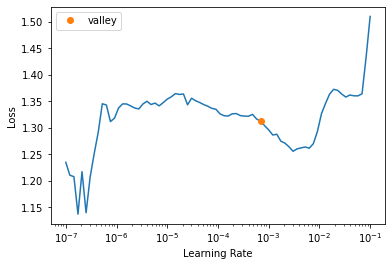

In [14]:
learn = run_experiment(7, 3, bs=64, sample_train=None)
learn.lr_find()

In [15]:
wandb.init(project='nfl-1st-and-future', group='submission-experiments', name='gray-one-channel-bbox-1', force=True)
learn.fine_tune(10, 1e-3, cbs=WandbCallback(log_preds=False, seed=4121995))

wandb: Currently logged in as: ahmedsamirio. Use `wandb login --relogin` to force relogin


Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.359762,0.343947,0.855060,0.533886,0.862140,0.417054,0.562165,16:14


Better model found at epoch 0 with matthews_corrcoef value: 0.5338858536081471.
Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.281623,0.283810,0.873418,0.577533,0.886145,0.455571,0.601770,15:43
1,0.276713,0.245539,0.887408,0.592261,0.857339,0.487710,0.621736,16:03
2,0.255187,0.260849,0.882745,0.596056,0.887517,0.476787,0.620326,16:32
3,0.235804,0.296686,0.869346,0.576906,0.901235,0.447700,0.598224,15:38
4,0.217902,0.225276,0.898068,0.601424,0.824417,0.517434,0.635811,14:52
5,0.188248,0.293987,0.882153,0.585170,0.865569,0.474793,0.613217,15:09
6,0.145572,0.284650,0.900289,0.611195,0.835391,0.523871,0.643933,15:21
7,0.112905,0.320658,0.894663,0.603958,0.848422,0.507175,0.634847,15:49
8,0.070239,0.350424,0.902509,0.611569,0.823731,0.531181,0.645873,15:18
9,0.054099,0.374445,0.900585,0.608439,0.827160,0.525033,0.642344,15:37


Better model found at epoch 0 with matthews_corrcoef value: 0.5775325520010217.
Better model found at epoch 1 with matthews_corrcoef value: 0.5922614619758012.
Better model found at epoch 2 with matthews_corrcoef value: 0.5960557178116085.


IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Better model found at epoch 6 with matthews_corrcoef value: 0.6111946329896917.
Better model found at epoch 8 with matthews_corrcoef value: 0.6115689254307952.


In [19]:
learn = run_experiment(0, 3, bs=64, name='rgb-bbox-1', sample_train=None, sample_val=None, seed=42)
wandb.init(project='nfl-1st-and-future', group='submission-experiments', name='rgb-bbox-1', force=True)
learn.fine_tune(5, 1e-3, cbs=WandbCallback(log_preds=False, seed=42))

wandb: Currently logged in as: ahmedsamirio. Use `wandb login --relogin` to force relogin


Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.349055,0.322743,0.856416,0.547662,0.894745,0.416075,0.568012,27:49


Better model found at epoch 0 with matthews_corrcoef value: 0.5476619553000164.
Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.275852,0.273466,0.874174,0.584224,0.906336,0.451969,0.603157,27:39
1,0.245886,0.222362,0.906706,0.625833,0.843369,0.536829,0.656058,27:53
2,0.217878,0.228680,0.902845,0.626872,0.868124,0.523874,0.653432,27:30
3,0.173133,0.266278,0.895197,0.613771,0.877750,0.501896,0.638626,27:09
4,0.130662,0.290755,0.898482,0.616722,0.867633,0.511125,0.643288,27:22


Better model found at epoch 0 with matthews_corrcoef value: 0.5842235337010158.


IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [ ]:
learn = run_experiment(9, 1, bs=64, name='gray-bbox-1', sample_train=None, sample_val=None, seed=42)
wandb.init(project='nfl-1st-and-future', group='submission-experiments', name='gray-bbox-1', force=True)
learn.fine_tune(5, 1e-3, cbs=WandbCallback(log_preds=False, seed=42))

Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.376930,0.296064,0.867733,0.547720,0.852308,0.435229,0.576215,28:20


Better model found at epoch 0 with matthews_corrcoef value: 0.5477202894310595.
Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.296926,0.269784,0.879999,0.582846,0.878585,0.463732,0.607052,28:29


Better model found at epoch 0 with matthews_corrcoef value: 0.5828461916522247.


In [ ]:
learn = run_experiment(8, 3, bs=64, name='gray-two-channels-bbox-1', sample_train=None, sample_val=None, seed=42)
wandb.init(project='nfl-1st-and-future', group='submission-experiments', name='gray-two-channels-bbox-1', force=True)
learn.fine_tune(5, 1e-3, cbs=WandbCallback(log_preds=False, seed=42))

Downloading: "https://dl.fbaipublicfiles.com/convnext/convnext_tiny_1k_224_ema.pth" to /root/.cache/torch/hub/checkpoints/convnext_tiny_1k_224_ema.pth
wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.351607,0.366988,0.829455,0.513752,0.911297,0.373621,0.529963,23:59


Better model found at epoch 0 with matthews_corrcoef value: 0.5137517038078946.
Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,recall_score,precision_score,f1_score,time
0,0.282337,0.308192,0.858395,0.562688,0.919941,0.421590,0.578202,23:50
1,0.251959,0.237693,0.895233,0.611731,0.872790,0.502006,0.637397,23:46


Better model found at epoch 1 with matthews_corrcoef value: 0.6117305538623493.


### Validation

In [18]:
set_seed(42, True)
name = 'rgb-bbox-1'
config = 0
channels = 3
sample_train = 0.001
sample_val = None
seed = 42
bs = 64

means = [0.485, 0.456, 0.406]*2
stds = [0.229, 0.224, 0.225]*2


val_transform = A.Compose(
    [
        # A.Resize(crop_size, crop_size),
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)


frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                      kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=sample_train,
                      sample_val=sample_val, undersample_no_contact=True, seed=seed).copy()

val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, crop_size=256, config=0)

val_loader = DataLoader(
    val_ds, batch_size=bs, shuffle=False, num_workers=8, pin_memory=True,
)

data = DataLoaders(val_loader, val_loader)
    
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                cbs=[
                    # WandbCallback(log_preds=False, seed=seed),
                    # SaveModelCallback(monitor='matthews_corrcoef', fname=name)
                ]
               ).to_fp16()

learn = learn.load('rgb-bbox-1')

Downloading: "https://dl.fbaipublicfiles.com/convnext/convnext_tiny_1k_224_ema.pth" to /root/.cache/torch/hub/checkpoints/convnext_tiny_1k_224_ema.pth
/usr/local/lib/python3.9/dist-packages/fastai/learner.py:58: UserWarning: Saved filed doesn't contain an optimizer state.
  elif with_opt: warn("Saved filed doesn't contain an optimizer state.")


In [19]:
learn.export('nflutils/rgb-bbox-1.pkl')

AttributeError: 'DataLoader' object has no attribute 'new'

In [ ]:
val_df = frames_df.query('is_valid').copy()
preds, _ = learn.get_preds(dl=val_loader)

In [ ]:
    (7, 3, ''),
    (8, 3, 'gray-two-channels-bbox')

In [14]:
set_seed(42, True)
name = 'gray-one-channel-bbox-1'
config = 7
channels = 3
sample_train = 0.001
sample_val = None
seed = 42
bs = 64

means = [0.485, 0.456, 0.406]*2
stds = [0.229, 0.224, 0.225]*2


val_transform = A.Compose(
    [
        # A.Resize(crop_size, crop_size),
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)


frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                      kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=sample_train,
                      sample_val=sample_val, undersample_no_contact=True, seed=seed).copy()

val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, crop_size=256, config=0)

val_loader = DataLoader(
    val_ds, batch_size=bs, shuffle=False, num_workers=8, pin_memory=True,
)

data = DataLoaders(val_loader, val_loader)
    
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                cbs=[
                    # WandbCallback(log_preds=False, seed=seed),
                    # SaveModelCallback(monitor='matthews_corrcoef', fname=name)
                ]
               ).to_fp16()

learn = learn.load(name)

/usr/local/lib/python3.9/dist-packages/fastai/learner.py:58: UserWarning: Saved filed doesn't contain an optimizer state.
  elif with_opt: warn("Saved filed doesn't contain an optimizer state.")


In [16]:
val_df = frames_df.query('is_valid').copy()
preds, _ = learn.get_preds(dl=val_loader)

In [17]:
val_df['preds_0'] = preds.detach().cpu().numpy()[:, 0]
val_df['preds_1'] = preds.detach().cpu().numpy()[:, 1]

val_df.to_csv(f'{name}.csv', index=False)

In [19]:
set_seed(42, True)
name = 'gray-two-channels-bbox-1'
config = 8
channels = 3
sample_train = 0.001
sample_val = None
seed = 42
bs = 64

means = [0.485, 0.456, 0.406]*2
stds = [0.229, 0.224, 0.225]*2


val_transform = A.Compose(
    [
        # A.Resize(crop_size, crop_size),
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)


frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                      kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=sample_train,
                      sample_val=sample_val, undersample_no_contact=True, seed=seed).copy()

val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, crop_size=256, config=0)

val_loader = DataLoader(
    val_ds, batch_size=bs, shuffle=False, num_workers=8, pin_memory=True,
)

data = DataLoaders(val_loader, val_loader)
    
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                cbs=[
                    # WandbCallback(log_preds=False, seed=seed),
                    # SaveModelCallback(monitor='matthews_corrcoef', fname=name)
                ]
               ).to_fp16()

learn = learn.load(name)

/usr/local/lib/python3.9/dist-packages/fastai/learner.py:58: UserWarning: Saved filed doesn't contain an optimizer state.
  elif with_opt: warn("Saved filed doesn't contain an optimizer state.")


In [20]:
val_df = frames_df.query('is_valid').copy()
preds, _ = learn.get_preds(dl=val_loader)

In [21]:
val_df['preds_0'] = preds.detach().cpu().numpy()[:, 0]
val_df['preds_1'] = preds.detach().cpu().numpy()[:, 1]

val_df.to_csv(f'{name}.csv', index=False)

In [8]:
rgb_bbox_1 = pd.read_csv('rgb-bbox-1.csv')
gray_one_channel_bbox_1 = pd.read_csv('gray-one-channel-bbox-1.csv')
gray_two_channel_bbox_1 = pd.read_csv('gray-two-channels-bbox-1.csv')

In [15]:
rgb_bbox_1['contact_pred'] = rgb_bbox_1['preds_1']
gray_one_channel_bbox_1['contact_pred'] = gray_one_channel_bbox_1['preds_1']
gray_two_channel_bbox_1['contact_pred'] = gray_two_channel_bbox_1['preds_1']

<AxesSubplot:xlabel='step'>

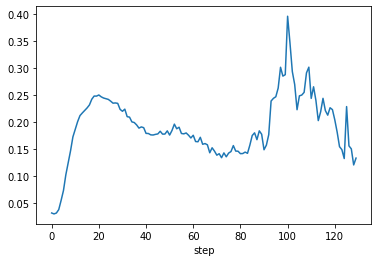

In [10]:
rgb_bbox_1.groupby('step').preds_1.mean().plot()

<AxesSubplot:xlabel='step'>

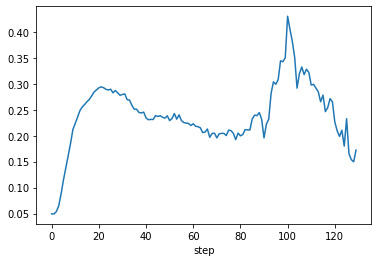

In [11]:
gray_one_channel_bbox_1.groupby('step').preds_1.mean().plot()

<AxesSubplot:xlabel='step'>

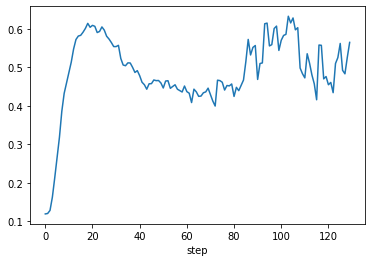

In [12]:
gray_two_channel_bbox_1.groupby('step').preds_1.mean().plot()

In [13]:
from nflutils.validation import *

from sklearn.metrics import matthews_corrcoef

In [33]:
def get_matthews_corrcoef(val_dist_agg, pred_col='contact_pred_rolling', thresh=0.5):
    out = np.where(val_dist_agg['contact_pred'].isna(),
                   val_dist_agg['distance'] <= 1, 
                   val_dist_agg[pred_col] > thresh).astype(int)
    
    return matthews_corrcoef(val_dist_agg['contact'], out)

def smooth_predictions(val_df, w, center):
    val_df_new = pd.DataFrame()
    for group, group_df in tqdm(val_df.groupby(['game_play', 'nfl_player_id_1', 'nfl_player_id_2', 'view'])):
        group_df['contact_pred_rolling'] = group_df.contact_pred.rolling(w, center=center).mean().bfill().ffill().fillna(0)
        # group_df['contact_pred_rolling'] = np.where(group_df.contact_pred_rolling.isna(), group_df.contact_pred, group_df.contact_pred_rolling)
        val_df_new = pd.concat([val_df_new, group_df])
    return val_df_new

In [34]:
rgb_bbox_1 = smooth_predictions(rgb_bbox_1, 5, True)

  0%|          | 0/6365 [00:00<?, ?it/s]

In [35]:
rgb_combo = merge_combo_val(df_combo, rgb_bbox_1, pred_col='contact_pred_rolling')

In [47]:
get_matthews_corrcoef(rgb_combo, 'contact_pred_rolling', thresh=0.64)

0.708660530417308

In [51]:
gray_one_channel_bbox_1 = smooth_predictions(gray_one_channel_bbox_1, 5, True)

  0%|          | 0/6365 [00:00<?, ?it/s]

In [52]:
gray_combo_1 = merge_combo_val(df_combo, gray_one_channel_bbox_1, pred_col='contact_pred_rolling')

In [62]:
get_matthews_corrcoef(gray_combo_1, 'contact_pred_rolling', thresh=0.69)

0.7034224506927914

In [67]:
gray_two_channel_bbox_1 = smooth_predictions(gray_two_channel_bbox_1, 5, True)

  0%|          | 0/6365 [00:00<?, ?it/s]

In [68]:
gray_combo_2 = merge_combo_val(df_combo, gray_two_channel_bbox_1, pred_col='contact_pred_rolling')

In [74]:
get_matthews_corrcoef(gray_combo_2, 'contact_pred_rolling', thresh=0.7)

0.3097479394613827

## General 2D experiments

In [1]:
from torch.utils.data import Dataset, DataLoader
import functools

def get_frames_df(df_combo, kf_dict, split, frames_path, sample_every_n_frame=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, seed=42):
    set_seed(seed, True)
    
    # Add game_play with frame identifier for sampling
    df_combo['game_play_frame'] = df_combo.game_play + '_' + df_combo.frame.astype(str)
    
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % 6 == 0')
        val_combo = val_combo.query('(290 - frame) % 6 == 0')
    
    if sample_train is not None:
        train_frames = train_combo.game_play_frame.unique()
        train_frames_sample = np.random.choice(train_frames, int(sample_train*len(train_frames)), replace=False)
        train_combo = train_combo.query('game_play_frame in @train_frames_sample')
        
    if sample_val is not None:
        val_frames = val_combo.game_play_frame.unique()
        val_frames_sample = np.random.choice(val_frames, int(sample_val*len(val_frames)), replace=False)
        val_combo = val_combo.query('game_play_frame in @val_frames_sample')
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])

    frames_df = pd.concat([train_combo, val_combo], axis=0)
    frames_df.frame = frames_df.frame.astype('int') 
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
        
    frames_df['path'] = frames_df.apply(lambda x: get_frame_path(x, frames_path), axis=1)
        
    return frames_df


def add_helmets(frame, row):
    frame = frame.copy()
    frame = cv2.rectangle(frame, 
                          (int(row.left_1), int(row.top_1)),
                          (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                          (255, 0, 0), 2)
    if not np.isnan(row.left_2):
        frame = cv2.rectangle(frame, 
                              (int(row.left_2), int(row.top_2)),
                              (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                              (255, 0, 0), 2)
    return frame

@functools.lru_cache(maxsize=1000)
def _get_frame(path):
    frame = cv2.imread(path)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    return frame


class NFLFrameDataset(Dataset):
    def __init__(self, frames_df, transform=None, crop_size=256, helmets=True):
        self.frames_df = frames_df
        self.helmets = helmets
        self.crop_size = crop_size
        self.transform = transform
        
    def __len__(self):
        return len(self.frames_df)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        frame = self.get_frame(row.path)
        if self.helmets:
            frame = add_helmets(frame, row)
        frame = crop_frame(frame, row.center_x, row.center_y, self.crop_size)
        if self.transform is not None:
            frame = self.transform(image=frame)['image']
        return frame, row.contact
            
    def get_video_readers(self, frames_df, vids_path, views, h, w, ctx):
        video_readers = {}
        for gp in frames_df.game_play.unique():
            for view in views:
                # Each value will contain the video reader and the last seeked frame
                video_readers[(gp, view)] = [VideoReader((BASE_DIR/'train'/f'{gp}_{view}.mp4').as_posix(), ctx=ctx, height=h, width=w), 0]
        return video_readers
    
    def get_frame(self, path):
        return _get_frame(path)
    
def crop_frame(frame, x, y, size):
    size = size // 2
    
    if y-size < 0:
        min_y = 0
        max_y = min_y + 2*size
        
    elif y+size > 719:
        min_y = 719 - 2*size
        max_y = 719
        
    else:
        min_y = y - size
        max_y = y + size
    
    if x-size < 0:
        min_x = 0
        max_x = min_x + 2*size
        
    elif x+size > 1279:
        min_x = 1279 - 2*size
        max_x = 1279
        
    else:
        min_x = x - size
        max_x = x + size
        
    cropped_frame = frame[int(min_y):int(max_y), 
                          int(min_x):int(max_x), :]
    return cropped_frame
    
def visualize_batch(batch, means, stds):
    """
    Visualize a batch of image data using Matplotlib.
    
    Parameters:
        - batch_tensor (torch.Tensor): A batch of image data in the shape (batch_size, channels, height, width).
        - means (tuple): A tuple of means for each channel in the image data.
        - stds (tuple): A tuple of standard deviations for each channel in the image data.
    """
    # Make a copy of the batch tensor so that we don't modify the original data
    batch_tensor = batch[0].clone()
    
    # De-normalize the data using the means and stds
    batch_tensor = batch_tensor * torch.tensor(stds, dtype=batch_tensor.dtype).view(3, 1, 1) + torch.tensor(means, dtype=batch_tensor.dtype).view(3, 1, 1)
    
    # Convert the data to numpy and transpose it to (batch_size, height, width, channels)
    batch_np = batch_tensor.numpy().transpose(0, 2, 3, 1)
    
    # Plot the images
    plt.figure(figsize=(20, 20))
    for i in range(batch_np.shape[0]):
        plt.subplot(batch_np.shape[0] // 5 + 1, 5, i + 1)
        plt.imshow(batch_np[i])
        plt.title(['no contact', 'contact'][batch[1][i].item()])
        plt.axis("off")
    plt.show()

In [2]:
import wandb

from fastai.callback.wandb import *

### Sample sizes

#### Sampling total frame data

In [11]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)


def run_experiment(sample_train):
    frames_df = get_frames_df(df_combo_with_helmets[df_combo_with_helmets.left_2.notnull()].copy(),
                          kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=sample_train,
                          sample_val=None, undersample_no_contact=True).copy()

    frames_df = frames_df.query('nfl_player_id_2 != "G"')

    train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform)
    val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform)

    train_loader = DataLoader(
        train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
    )

    val_loader = DataLoader(
        val_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
    )
    
    
    data = DataLoaders(train_loader, val_loader)
    model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
    learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef()],
                    cbs=WandbCallback()
                   ).to_fp16()
    
    learn.fit_one_cycle(1, 1e-3)

In [13]:
for s in [0.1, 0.3, 0.5]:
    wandb.init(project='nfl-1st-and-future', group='train-samples', name=f'{s}-frames', force=True)
    run_experiment(s)

epoch,▁▁▂▂▂▃▃▃▄▄▄▅▅▅▆▆▆▇▇▇██
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▁▁▁▁▁▁▂▂▂▂▃▃▄▄▄▅▅▆▆▇▇█
mom_0,██████▇▇▇▇▆▆▅▅▅▄▄▃▃▂▂▁
raw_loss,▆▇▄▇▄█▅▃▄▆▄▁▂▁▄█▂▄▄▃▃▄
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,▇█▆▇▆▇▆▅▅▅▄▃▂▂▂▂▂▂▂▁▁▁
train_samples_per_sec,▁█████████████████████
wd_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,0.10577
eps_0,1e-05


Could not gather input dimensions
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'NFLFrameDataset' object has no attribute 'items'


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.679259,0.533650,0.737084,0.443481,03:45


accuracy,▁
epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▁▁▂▃▄▅▆▇███████▇▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁
matthews_corrcoef,▁
mom_0,██▇▇▆▄▃▂▂▁▁▁▁▁▁▂▂▂▂▃▃▃▄▄▄▅▅▅▆▆▆▇▇▇▇█████
raw_loss,▇█▃█▅▆▅▇▄▄▅▅▄▆▃▃▂▃▂▄▂▂▃▂▄▃▁▂▁▂▂▂▂▃▂▃▃▂▃▂
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,██▆▆▆▆▆▆▅▅▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
train_samples_per_sec,█▆▆▆▂▅▅▅▅▅▅▅▅▄▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▁▅▅▅▅▅▅▄▅▂
valid_loss,▁


Could not gather input dimensions
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'NFLFrameDataset' object has no attribute 'items'


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.451079,0.428817,0.800347,0.537953,05:53


accuracy,▁
epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▁▁▂▃▄▅▆▇███████▇▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁
matthews_corrcoef,▁
mom_0,██▇▆▅▄▃▂▁▁▁▁▁▁▁▂▂▂▂▃▃▃▄▄▄▅▅▅▆▆▆▇▇▇▇█████
raw_loss,▇▇██▆█▇▄▇▄▃▄▃▄▂▃▂▄▂▃▁▂▃▃▂▂▂▃▁▂▂▃▂▁▂▂▂▃▂▁
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,██▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
train_samples_per_sec,▇▇███▇▅▄▇▇▇▅▇▆▆▆▆▅▆▆▄▆▆▅▅▅▆▅▆▆▆▅▅▅▆▅▅▆▆▁
valid_loss,▁


Could not gather input dimensions
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'NFLFrameDataset' object has no attribute 'items'


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.411880,0.377972,0.828461,0.566781,07:53


#### Sampling totally random data

In [9]:
def get_frames_df(df_combo, kf_dict, split, frames_path, sample_every_n_frame=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, seed=42):
    
    set_seed(seed, True)
    
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % 6 == 0')
        val_combo = val_combo.query('(290 - frame) % 6 == 0')
    
    if sample_train is not None:
        train_combo = train_combo.sample(frac=sample_train, random_state=seed)
        
    if sample_val is not None:
        val_combo = val_combo.sample(frac=sample_val, random_state=seed)
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])

    frames_df = pd.concat([train_combo, val_combo], axis=0)
    frames_df.frame = frames_df.frame.astype('int') 
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
        
    frames_df['path'] = frames_df.apply(lambda x: get_frame_path(x, frames_path), axis=1)
        
    return frames_df


In [15]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)


def run_experiment(sample_train):
    frames_df = get_frames_df(df_combo_with_helmets[df_combo_with_helmets.left_2.notnull()].copy(),
                          kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=sample_train,
                          sample_val=None, undersample_no_contact=True).copy()

    frames_df = frames_df.query('nfl_player_id_2 != "G"')

    train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform)
    val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform)

    train_loader = DataLoader(
        train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
    )

    val_loader = DataLoader(
        val_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
    )
    
    
    data = DataLoaders(train_loader, val_loader)
    model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
    learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef()],
                    cbs=WandbCallback()
                   ).to_fp16()
    
    learn.fit_one_cycle(1, 1e-3)

In [16]:
for s in [0.1, 0.3, 0.5]:
    wandb.init(project='nfl-1st-and-future', group='train-samples', name=f'{s}-random', force=True)
    run_experiment(s)

accuracy,▁
epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▁▂▂▃▄▅▆▇███████▇▇▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁
matthews_corrcoef,▁
mom_0,██▇▆▅▄▃▂▁▁▁▁▁▁▁▂▂▂▂▂▃▃▄▄▄▅▅▅▆▆▆▇▇▇▇█████
raw_loss,█▅▅▅▃▄▄▃▃▂▃▃▁▁▃▂▁▂▁▂▂▂▁▁▂▂▁▁▁▂▁▂▁▂▁▁▁▁▂▂
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,█▆▆▆▅▅▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_samples_per_sec,▇█▇▅▆▇▅▆▅▄▅▅▅▅▃▄▂▅▅▅▄▄▄▅▄▄▂▄▅▅▄▁▅▄▅▆▅▅▅▅
valid_loss,▁


Could not gather input dimensions
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'NFLFrameDataset' object has no attribute 'items'


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.655989,0.542837,0.759109,0.470178,03:45


accuracy,▁
epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▁▁▂▃▄▅▆▇▇███████▇▇▇▆▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁
matthews_corrcoef,▁
mom_0,██▇▇▅▅▃▂▂▁▁▁▁▁▁▁▂▂▂▃▃▃▃▄▄▅▅▅▆▆▆▇▇▇▇█████
raw_loss,▅█▇▄▅▆▆▅▄▄▃▅▃▅█▆▃▂▄▃▂▃▄▃▂▁▄▃▃▅▂▂▂▁▁▁▂▃▁▁
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,▆██▇▇▇▇▆▆▆▅▅▅▅▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁
train_samples_per_sec,▁▇████▆▆██▇▇▅▆▇▇▇▅▆▇▇▇▇▆▅▆▆▅▆▅▆▅▅▅▅▆▆▆▅▄
valid_loss,▁


Could not gather input dimensions
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'NFLFrameDataset' object has no attribute 'items'


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.455447,0.444079,0.787118,0.526549,05:48


accuracy,▁
epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▁▁▂▃▄▅▆▇███████▇▇▇▇▆▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁
matthews_corrcoef,▁
mom_0,██▇▆▅▄▃▂▁▁▁▁▁▁▁▂▂▂▂▃▃▃▃▄▄▅▅▅▆▆▆▇▇▇▇█████
raw_loss,▇▆▇▇▆▆█▆▄▅▃▄▃▅▃▂▂▄▃▂▂▂▂▃▂▂▂▃▃▂▂▁▂▂▁▂▃▂▂▃
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,██▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
train_samples_per_sec,▆▆█▇▆▄▆▆▆▆▆▅▅▅▃▄▄▃▄▄▄▄▄▄▄▂▃▁▃▃▄▄▃▃▃▃▃▃▄▄
valid_loss,▁


Could not gather input dimensions
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'NFLFrameDataset' object has no attribute 'items'


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.433010,0.369485,0.824306,0.567261,08:00


### Helmets effect

In [17]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)


def run_experiment(helmets):
    frames_df = get_frames_df(df_combo_with_helmets[df_combo_with_helmets.left_2.notnull()].copy(),
                          kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=0.1,
                          sample_val=None, undersample_no_contact=True).copy()

    frames_df = frames_df.query('nfl_player_id_2 != "G"')

    train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, helmets=helmets)
    val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, helmets=helmets)

    train_loader = DataLoader(
        train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
    )

    val_loader = DataLoader(
        val_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
    )
    
    
    data = DataLoaders(train_loader, val_loader)
    model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
    learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef()],
                    cbs=WandbCallback()
                   ).to_fp16()
    
    learn.fit_one_cycle(2, 1e-3)

In [18]:
wandb.init(project='nfl-1st-and-future', group='Helmets-effect', name=f'with-helmets', force=True)
run_experiment(True)

accuracy,▁
epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▁▂▂▃▄▅▆▇▇██████▇▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁
matthews_corrcoef,▁
mom_0,██▇▆▆▄▃▂▂▁▁▁▁▁▁▂▂▂▂▃▃▃▄▄▄▅▅▅▆▆▆▇▇▇▇█████
raw_loss,▆▆▄▅▄▅▃▄▃▃▃▃▃▂▂▃▁▂▂▂▁▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▂█
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,█▇▆▆▆▅▄▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_samples_per_sec,███████████████████████████████████████▁
valid_loss,▁


Could not gather input dimensions
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'NFLFrameDataset' object has no attribute 'items'


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.682478,0.521720,0.758952,0.464738,03:45
1,0.486212,0.452310,0.781727,0.507704,03:45


In [19]:
wandb.init(project='nfl-1st-and-future', group='Helmets-effect', name=f'without-helmets', force=True)
run_experiment(False)

accuracy,▁█
epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▁▁▂▃▄▅▆▇▇██████▇▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁
matthews_corrcoef,▁█
mom_0,██▇▇▅▄▃▂▂▁▁▁▁▁▁▂▂▂▂▃▃▃▄▄▄▅▅▅▆▆▆▇▇▇▇█████
raw_loss,█▅▅▅▅▄▄▅▄▄▃▄▂▄▃▂▃▂▂▂▁▂▁▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,██▇▇▇▇▆▆▆▆▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
train_samples_per_sec,▁██▇▇▇▆▅▇▅▆▆▆▆▆▅▆▅▆▅▆▆▆▆▆▆▆▆▅▆▅▄▅▅▅▅▃▃▅▃
valid_loss,█▁


Could not gather input dimensions
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'NFLFrameDataset' object has no attribute 'items'


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.861136,0.578343,0.675674,0.302508,03:42
1,0.633521,0.545289,0.715018,0.380242,03:39


### Sizes

In [23]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)


def run_experiment(crop_size):
    frames_df = get_frames_df(df_combo_with_helmets[df_combo_with_helmets.left_2.notnull()].copy(),
                          kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=0.1,
                          sample_val=None, undersample_no_contact=True).copy()

    frames_df = frames_df.query('nfl_player_id_2 != "G"')

    train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, helmets=True, crop_size=crop_size)
    val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, helmets=True, crop_size=crop_size)

    train_loader = DataLoader(
        train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
    )

    val_loader = DataLoader(
        val_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
    )
    
    
    data = DataLoaders(train_loader, val_loader)
    model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
    learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef()],
                    cbs=WandbCallback()
                   ).to_fp16()
    
    learn.fit_one_cycle(2, 1e-3)

In [24]:
for size in [128, 224, 384]:
    wandb.init(project='nfl-1st-and-future', group='Sizes', name=f'{size}', force=True)
    run_experiment(size)

accuracy,▁█
epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▁▁▂▃▄▅▆▇▇██████▇▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁
matthews_corrcoef,▁█
mom_0,██▇▇▅▄▃▂▂▁▁▁▁▁▁▂▂▂▂▃▃▃▄▄▄▅▅▅▆▆▆▇▇▇▇█████
raw_loss,█▅▅▆▄▄▅▅▄▃▅▄▅▄▄▃▃▂▃▄▂▂▂▃▂▂▂▂▂▃▂▂▂▂▂▂▂▂▂▁
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,██▇▇▇▆▇▆▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
train_samples_per_sec,▄███▆█▆▇▅▇▆▄▆▄▆▆▅▅▅▅▅▁▆▇▆▄▅▆▆▅▄▅▄▆▆▅▃▄▅▃
valid_loss,█▁


Could not gather input dimensions
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'NFLFrameDataset' object has no attribute 'items'


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.684509,0.471306,0.768761,0.450367,02:58
1,0.517433,0.466995,0.772825,0.490177,02:59


accuracy,▁█
epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▁▁▂▃▄▅▆▇▇██████▇▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁
matthews_corrcoef,▁█
mom_0,██▇▇▅▄▃▂▂▁▁▁▁▁▁▂▂▂▂▃▃▃▄▄▄▅▅▅▆▆▆▇▇▇▇█████
raw_loss,▇▅▆▅▆█▅▆▅▅▅▃▂▄▄▁▂▂▂▃▃▂▃▂▂▂▂▂▂▂▂▃▂▂▂▁▂▂▂▁
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,██▇▇▇▆▆▆▅▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_samples_per_sec,▅▅▃▇▁▁▆▆▆▅▄▆▆▇▅▇▇▃▅█▃▅▃▄██▅▄▂▃▅▇▃▆▇▃▅▅▇█
valid_loss,█▁


Could not gather input dimensions
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'NFLFrameDataset' object has no attribute 'items'


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.706592,0.409097,0.809657,0.452599,03:25
1,0.524271,0.470983,0.781346,0.494106,03:31


accuracy,█▁
epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▁▁▂▃▄▅▆▇▇██████▇▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁
matthews_corrcoef,▁█
mom_0,██▇▇▅▄▃▂▂▁▁▁▁▁▁▂▂▂▂▃▃▃▄▄▄▅▅▅▆▆▆▇▇▇▇█████
raw_loss,█▆▆▅▆▃▅▄▄▄▃▅▂▆▄▃▄▂▂▃▃▃▃▃▂▂▃▂▃▂▃▂▃▃▂▂▂▂▃▁
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,████▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁
train_samples_per_sec,███▇█▇▇▇█▇█▇█▇▇▇▇▇▇█▁▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇
valid_loss,▁█


Could not gather input dimensions
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'NFLFrameDataset' object has no attribute 'items'


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.762775,0.519103,0.756098,0.387389,05:44
1,0.532293,0.485527,0.766657,0.480537,05:45


### Ground data

In [10]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.HorizontalFlip(),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)


def run_experiment(crop_size):
    frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                          kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=None,
                          sample_val=None, undersample_no_contact=True).copy()

    # frames_df = frames_df.query('nfl_player_id_2 != "G"')

    train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, helmets=True, crop_size=crop_size)
    val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, helmets=True, crop_size=crop_size)

    train_loader = DataLoader(
        train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
    )

    val_loader = DataLoader(
        val_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
    )
    
    
    data = DataLoaders(train_loader, val_loader)
    model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
    learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef()],
                    cbs=WandbCallback()
                   ).to_fp16()
    
    learn.fine_tune(5, 1e-3)

In [14]:
wandb.init(project='nfl-1st-and-future', group='Sizes', name=f'256-with-ground', force=True)
run_experiment(256)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


Downloading: "https://dl.fbaipublicfiles.com/convnext/convnext_tiny_1k_224_ema.pth" to /root/.cache/torch/hub/checkpoints/convnext_tiny_1k_224_ema.pth


Could not gather input dimensions
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'NFLFrameDataset' object has no attribute 'items'


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.339554,0.325935,0.854219,0.548103,20:51


Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.262464,0.279618,0.869345,0.575707,20:50
1,0.229746,0.223743,0.905136,0.623470,20:45
2,0.188010,0.230303,0.898648,0.615267,20:47
3,0.120729,0.291241,0.899234,0.616216,20:44
4,0.056816,0.357628,0.898244,0.614795,20:45


In [ ]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.HorizontalFlip(),
        A.RandomBrightnessContrast(p=0.5),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)


def run_experiment(crop_size):
    frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                          kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=None,
                          sample_val=0.7, undersample_no_contact=True).copy()

    # frames_df = frames_df.query('nfl_player_id_2 != "G"')

    train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, helmets=True, crop_size=crop_size)
    val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, helmets=True, crop_size=crop_size)

    train_loader = DataLoader(
        train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
    )

    val_loader = DataLoader(
        val_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
    )
    
    
    data = DataLoaders(train_loader, val_loader)
    model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
    learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef()],
                    cbs=WandbCallback()
                   ).to_fp16()
    
    learn.fine_tune(5, 1e-3)

In [ ]:
wandb.init(project='nfl-1st-and-future', group='Sizes', name=f'256-with-ground-extra-aug', force=True)
run_experiment(256)

accuracy,▁▃█▇▇▇
epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▁▂▃▅▆▇█▂▂▂▃▃▃▄▄▄▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁
matthews_corrcoef,▁▄█▇▇▇
mom_0,█▇▆▅▃▂▁██▇▆▅▄▃▂▁▁▁▁▁▁▂▂▂▃▃▄▄▅▅▆▆▆▇▇▇████
raw_loss,█▅▇▄▃▃▄▂▃▃▄▃▄▂▃▃▃▂▂▂▂▂▂▂▃▃▃▂▂▂▁▃▂▁▂▂▁▁▂▁
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,█▅▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
train_samples_per_sec,█▆▆▅▁▆▆▅▆▆▅▅▆▆▆▆▄▆▄▆▅▄▅▆▂▆▃▆▅▆▆▆▃▄▄▄▅▆▆▅
valid_loss,▆▄▁▁▅█


Could not gather input dimensions
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'NFLFrameDataset' object has no attribute 'items'


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.344936,0.292300,0.868048,0.564042,18:41


Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.264786,0.250252,0.889271,0.602105,18:35
1,0.235204,0.236394,0.903277,0.625580,18:38
2,0.192821,0.255461,0.895142,0.611773,18:43
3,0.124371,0.294489,0.896800,0.610504,18:31
4,0.067938,0.355595,0.898695,0.612874,18:30


In [ ]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.HorizontalFlip(),
        A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)


def run_experiment(crop_size):
    frames_df = get_frames_df(df_combo_with_helmets[(df_combo_with_helmets.left_2.notnull()) | (df_combo_with_helmets.nfl_player_id_2 == "G")].copy(),
                          kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=None,
                          sample_val=None, undersample_no_contact=True).copy()

    # frames_df = frames_df.query('nfl_player_id_2 != "G"')

    train_ds = NFLFrameDataset(frames_df.query('~is_valid'), transform=train_transform, helmets=True, crop_size=crop_size)
    val_ds = NFLFrameDataset(frames_df.query('is_valid'), transform=val_transform, helmets=True, crop_size=crop_size)

    train_loader = DataLoader(
        train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
    )

    val_loader = DataLoader(
        val_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
    )
    
    
    data = DataLoaders(train_loader, val_loader)
    model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
    learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef()],
                    cbs=WandbCallback()
                   ).to_fp16()
    
    learn.fine_tune(5, 1e-3)

In [ ]:
wandb.init(project='nfl-1st-and-future', group='Sizes', name=f'256-with-ground-extra-aug-2', force=True)
run_experiment(256)

accuracy,▁▅█▆▇▇
epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▁▂▃▅▆▇█▂▂▂▃▃▃▄▄▄▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁
matthews_corrcoef,▁▅█▆▆▇
mom_0,█▇▆▅▃▂▁██▇▆▅▄▃▂▁▁▁▁▁▁▂▂▂▃▃▄▄▅▅▆▆▆▇▇▇████
raw_loss,█▅▄▃▃▃▄▂▃▂▃▃▃▂▃▃▂▂▂▂▂▂▂▂▂▃▃▂▂▂▂▃▂▂▁▂▁▁▂▁
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,█▅▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁
train_samples_per_sec,▇▄▇▇▆▃▆▆▆▇▇▆▆█▄▆▅▇▇▇▅▇▆▇▇▅▁▆▅█▇▆▆▇▆▇▆▆▄▆
valid_loss,▄▂▁▂▄█


Could not gather input dimensions
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'NFLFrameDataset' object has no attribute 'items'


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.349055,0.322743,0.856416,0.547662,20:43


Could not gather input dimensions


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.275852,0.273466,0.874174,0.584224,20:47
1,0.245886,0.222362,0.906706,0.625833,20:41


## Testing caching in PyTorch Dataloaders

In [8]:
import wandb

In [9]:
from fastai.callback.wandb import *

### With caching and smart shuffling

In [10]:
wandb.init(project='nfl-1st-and-future', group='caching-experiment', name='caching_and_smart_shuffling_bs_64')

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [11]:
from torch.utils.data import Dataset, DataLoader
import functools


def add_helmets(frame, row):
    frame = frame.copy()

    if row.left_1 != np.nan:
        frame = cv2.rectangle(frame, 
                              (int(row.left_1), int(row.top_1)),
                              (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                              (255, 0, 0), 2)
    if row.left_2 != np.nan:
        frame = cv2.rectangle(frame, 
                              (int(row.left_2), int(row.top_2)),
                              (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                              (255, 0, 0), 2)
    return frame

@functools.lru_cache(maxsize=1000)
def _get_frame(path):
    frame = cv2.imread(path)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    return frame


class NFLFrameDataset(Dataset):
    def __init__(self, frames_df, vids_path, transform=None, views=['Sideline', 'Endzone'], h=720, w=1280, crop_size=256, ctx=cpu()):
        self.frames_df = frames_df
        self.video_readers = self.get_video_readers(frames_df, vids_path, views, h, w, ctx)
        self.crop_size = crop_size
        self.transform = transform
        
    def __len__(self):
        return len(self.frames_df)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        # frame = self.get_frame(row.game_play, row['view'], row.frame)
        frame = self.get_frame(row.path)
        frame = add_helmets(frame, row)
        frame = crop_frame(frame, row.center_x, row.center_y, self.crop_size)
        if self.transform is not None:
            frame = self.transform(image=frame)['image']
        return frame, row.contact
            
    def get_video_readers(self, frames_df, vids_path, views, h, w, ctx):
        video_readers = {}
        for gp in frames_df.game_play.unique():
            for view in views:
                # Each value will contain the video reader and the last seeked frame
                video_readers[(gp, view)] = [VideoReader((BASE_DIR/'train'/f'{gp}_{view}.mp4').as_posix(), ctx=ctx, height=h, width=w), 0]
        return video_readers
    
    def get_frame(self, path):
        return _get_frame(path)
    
def crop_frame(frame, x, y, size):
    size = size // 2
    
    if y-size < 0:
        min_y = 0
        max_y = min_y + 2*size
        
    elif y+size > 719:
        min_y = 719 - 2*size
        max_y = 719
        
    else:
        min_y = y - size
        max_y = y + size
    
    if x-size < 0:
        min_x = 0
        max_x = min_x + 2*size
        
    elif x+size > 1279:
        min_x = 1279 - 2*size
        max_x = 1279
        
    else:
        min_x = x - size
        max_x = x + size
        
    cropped_frame = frame[int(min_y):int(max_y), 
                          int(min_x):int(max_x), :]
    return cropped_frame
    
def visualize_batch(batch, means, stds):
    """
    Visualize a batch of image data using Matplotlib.
    
    Parameters:
        - batch_tensor (torch.Tensor): A batch of image data in the shape (batch_size, channels, height, width).
        - means (tuple): A tuple of means for each channel in the image data.
        - stds (tuple): A tuple of standard deviations for each channel in the image data.
    """
    # Make a copy of the batch tensor so that we don't modify the original data
    batch_tensor = batch[0].clone()
    
    # De-normalize the data using the means and stds
    batch_tensor = batch_tensor * torch.tensor(stds, dtype=batch_tensor.dtype).view(3, 1, 1) + torch.tensor(means, dtype=batch_tensor.dtype).view(3, 1, 1)
    
    # Convert the data to numpy and transpose it to (batch_size, height, width, channels)
    batch_np = batch_tensor.numpy().transpose(0, 2, 3, 1)
    
    # Plot the images
    plt.figure(figsize=(20, 20))
    for i in range(batch_np.shape[0]):
        plt.subplot(batch_np.shape[0] // 5 + 1, 5, i + 1)
        plt.imshow(batch_np[i])
        plt.title(['no contact', 'contact'][batch[1][i].item()])
        plt.axis("off")
    plt.show()

In [12]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

frames_df = get_frames_df(df_combo_with_helmets[df_combo_with_helmets.left_2.notnull()].copy(),
                          kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=None,
                          sample_val=None, undersample_no_contact=True).copy()

unique_frames = frames_df.frame.unique()
rand_ids = np.arange(0, len(unique_frames))
np.random.shuffle(rand_ids)
frame_id_map = {unique_frames[i]: rand_ids[i] for i in range(len(rand_ids))}

frames_df.loc[:, 'frame_id'] = frames_df['frame'].replace(frame_id_map)
frames_df = frames_df.sort_values('frame_id')

frames_df = frames_df.query('nfl_player_id_2 != "G"')

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), BASE_DIR, transform=train_transform)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), BASE_DIR, transform=val_transform)

train_loader = DataLoader(
    train_ds, batch_size=64, shuffle=False, num_workers=8, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=64, shuffle=False, num_workers=8, pin_memory=True,
)

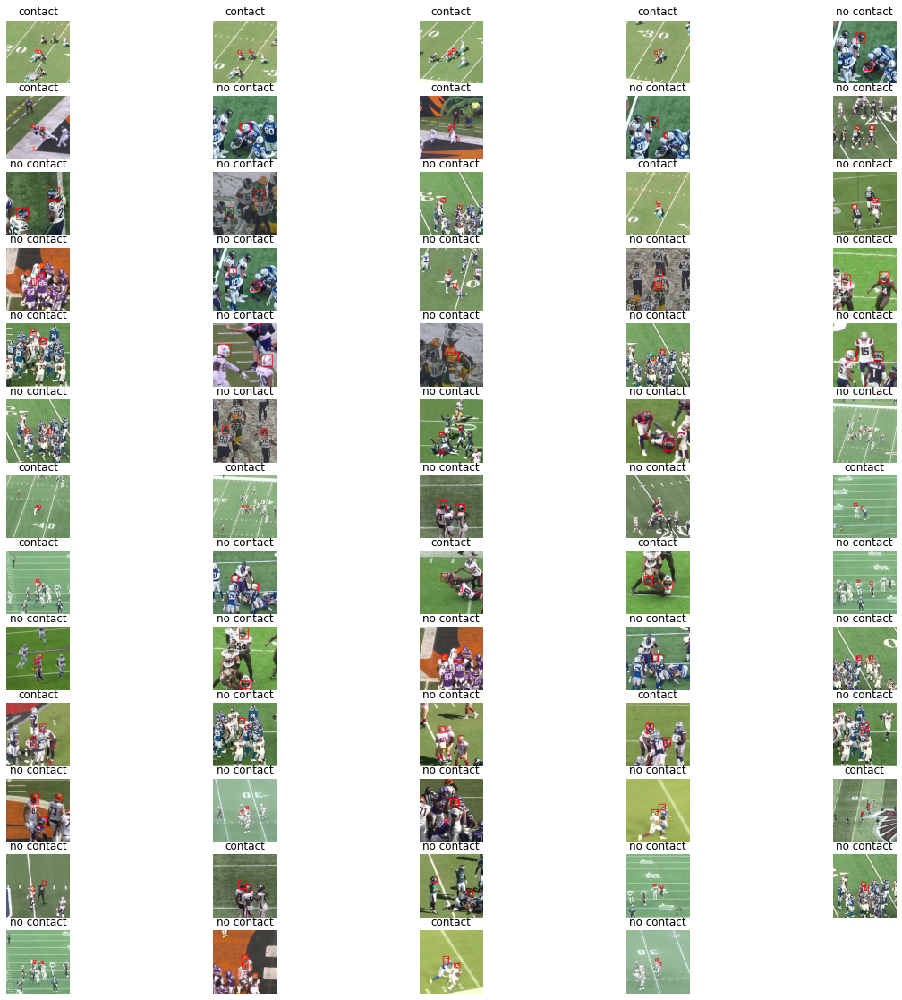

In [13]:
batch = next(iter(train_loader))

means = (0.485, 0.456, 0.406) # the means used to normalize the data
stds = (0.229, 0.224, 0.225) # the stds used to normalize the data
visualize_batch(batch, means, stds)

In [14]:
data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef()], cbs=WandbCallback()).to_fp16()

In [15]:
learn.fit_one_cycle(1, 1e-3)

Could not gather input dimensions
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'NFLFrameDataset' object has no attribute 'items'


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.484675,0.399365,0.817205,0.546901,12:02


### With caching only

In [16]:
wandb.init(project='nfl-1st-and-future', group='caching-experiment', name='caching_only_bs_64')

accuracy,▁
epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▁▂▂▃▄▅▆▇▇██████▇▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁
matthews_corrcoef,▁
mom_0,██▇▆▅▄▃▂▂▁▁▁▁▁▁▂▂▂▂▃▃▃▄▄▄▅▅▅▆▆▆▇▇▇▇█████
raw_loss,▄▆▆▅█▅▄▂▃▂▃▄▂▁▂▂▁▁▂▂▂▂▂▂▂▁▁▂▃▂▁▁▃▁▁▁▃▁▂▂
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,█▇▇▇▆▆▅▄▃▃▂▃▃▂▂▂▂▂▂▂▂▁▂▂▂▂▁▁▁▁▁▁▂▂▁▁▂▁▂▁
train_samples_per_sec,█▇▆▅▅▅▄▃▄▄▄▃▂▄▄▃▄▃▃▂▃▂▃▂▂▃▁▃▃▃▃▃▃▃▃▃▄▂▃▃
valid_loss,▁


In [17]:
from torch.utils.data import Dataset, DataLoader
from decord import VideoReader
from decord import cpu, gpu
import methodtools
import functools


def add_helmets(frame, row):
    frame = frame.copy()

    if row.left_1 != np.nan:
        frame = cv2.rectangle(frame, 
                              (int(row.left_1), int(row.top_1)),
                              (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                              (255, 0, 0), 2)
    if row.left_2 != np.nan:
        frame = cv2.rectangle(frame, 
                              (int(row.left_2), int(row.top_2)),
                              (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                              (255, 0, 0), 2)
    return frame

@functools.lru_cache(maxsize=1000)
def _get_frame(path):
    frame = cv2.imread(path)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    return frame


class NFLFrameDataset(Dataset):
    def __init__(self, frames_df, vids_path, transform=None, views=['Sideline', 'Endzone'], h=720, w=1280, crop_size=256, ctx=cpu()):
        self.frames_df = frames_df
        self.video_readers = self.get_video_readers(frames_df, vids_path, views, h, w, ctx)
        self.crop_size = crop_size
        self.transform = transform
        
    def __len__(self):
        return len(self.frames_df)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        # frame = self.get_frame(row.game_play, row['view'], row.frame)
        frame = self.get_frame(row.path)
        frame = add_helmets(frame, row)
        frame = crop_frame(frame, row.center_x, row.center_y, self.crop_size)
        if self.transform is not None:
            frame = self.transform(image=frame)['image']
        return frame, row.contact
            
    def get_video_readers(self, frames_df, vids_path, views, h, w, ctx):
        video_readers = {}
        for gp in frames_df.game_play.unique():
            for view in views:
                # Each value will contain the video reader and the last seeked frame
                video_readers[(gp, view)] = [VideoReader((BASE_DIR/'train'/f'{gp}_{view}.mp4').as_posix(), ctx=ctx, height=h, width=w), 0]
        return video_readers
    
    def get_frame(self, path):
        return _get_frame(path)
    
def crop_frame(frame, x, y, size):
    size = size // 2
    
    if y-size < 0:
        min_y = 0
        max_y = min_y + 2*size
        
    elif y+size > 719:
        min_y = 719 - 2*size
        max_y = 719
        
    else:
        min_y = y - size
        max_y = y + size
    
    if x-size < 0:
        min_x = 0
        max_x = min_x + 2*size
        
    elif x+size > 1279:
        min_x = 1279 - 2*size
        max_x = 1279
        
    else:
        min_x = x - size
        max_x = x + size
        
    cropped_frame = frame[int(min_y):int(max_y), 
                          int(min_x):int(max_x), :]
    return cropped_frame
    
def visualize_batch(batch, means, stds):
    """
    Visualize a batch of image data using Matplotlib.
    
    Parameters:
        - batch_tensor (torch.Tensor): A batch of image data in the shape (batch_size, channels, height, width).
        - means (tuple): A tuple of means for each channel in the image data.
        - stds (tuple): A tuple of standard deviations for each channel in the image data.
    """
    # Make a copy of the batch tensor so that we don't modify the original data
    batch_tensor = batch[0].clone()
    
    # De-normalize the data using the means and stds
    batch_tensor = batch_tensor * torch.tensor(stds, dtype=batch_tensor.dtype).view(3, 1, 1) + torch.tensor(means, dtype=batch_tensor.dtype).view(3, 1, 1)
    
    # Convert the data to numpy and transpose it to (batch_size, height, width, channels)
    batch_np = batch_tensor.numpy().transpose(0, 2, 3, 1)
    
    # Plot the images
    plt.figure(figsize=(20, 20))
    for i in range(batch_np.shape[0]):
        plt.subplot(batch_np.shape[0] // 5 + 1, 5, i + 1)
        plt.imshow(batch_np[i])
        plt.title(['no contact', 'contact'][batch[1][i].item()])
        plt.axis("off")
    plt.show()

In [18]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

frames_df = get_frames_df(df_combo_with_helmets[df_combo_with_helmets.left_2.notnull()].copy(),
                          kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=None,
                          sample_val=None, undersample_no_contact=True).copy()

# unique_frames = frames_df.frame.unique()
# rand_ids = np.arange(0, len(unique_frames))
# np.random.shuffle(rand_ids)
# frame_id_map = {unique_frames[i]: rand_ids[i] for i in range(len(rand_ids))}

# frames_df.loc[:, 'frame_id'] = frames_df['frame'].replace(frame_id_map)
# frames_df = frames_df.sort_values('frame_id')

frames_df = frames_df.query('nfl_player_id_2 != "G"')

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), BASE_DIR, transform=train_transform)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), BASE_DIR, transform=val_transform)

train_loader = DataLoader(
    train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=64, shuffle=False, num_workers=8, pin_memory=True,
)

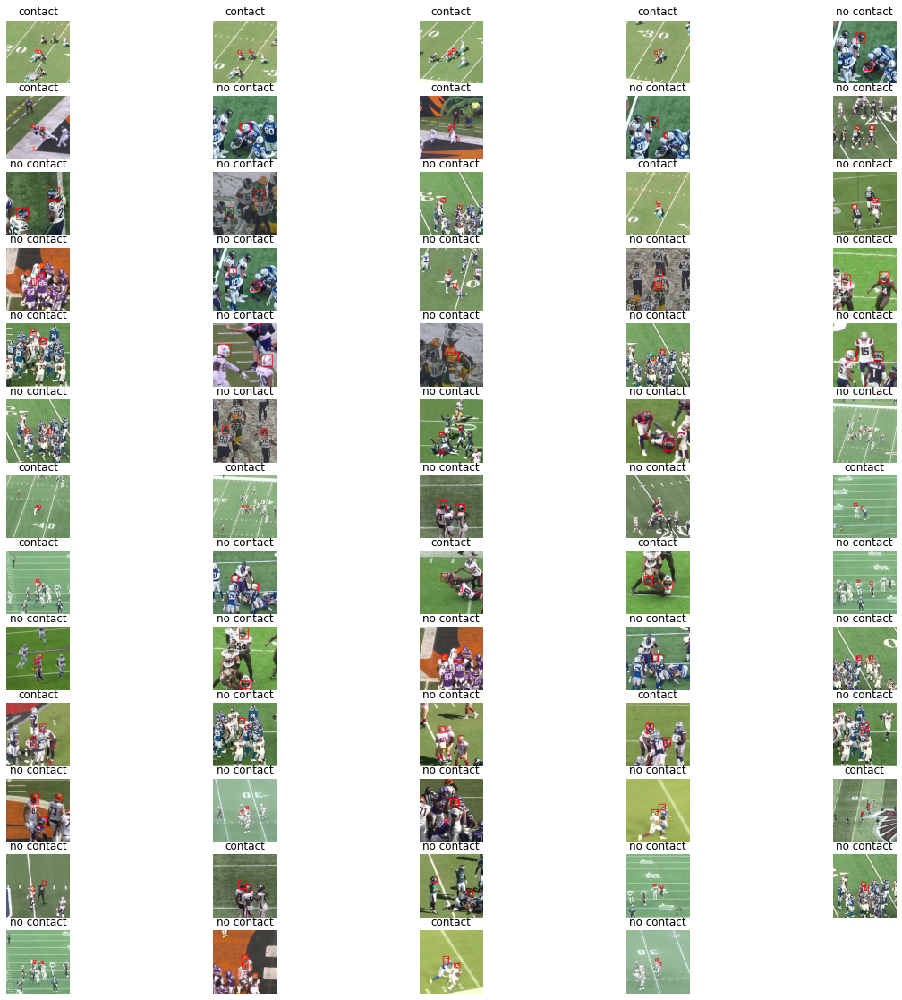

In [26]:
batch = next(iter(train_loader))

means = (0.485, 0.456, 0.406) # the means used to normalize the data
stds = (0.229, 0.224, 0.225) # the stds used to normalize the data
visualize_batch(batch, means, stds)

In [19]:
data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef()], cbs=WandbCallback()).to_fp16()

In [20]:
learn.fit_one_cycle(1, 1e-3)

Could not gather input dimensions
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'NFLFrameDataset' object has no attribute 'items'


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.390688,0.374090,0.828803,0.577764,12:08


### Negative test (No caching or smart shuffling)

In [21]:
wandb.init(project='nfl-1st-and-future', group='caching-experiment', name='negative_bs_64')

accuracy,▁
epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▁▂▂▃▄▅▆▇▇██████▇▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁
matthews_corrcoef,▁
mom_0,██▇▆▅▄▃▂▂▁▁▁▁▁▁▂▂▂▂▃▃▃▄▄▄▅▅▅▆▆▆▇▇▇▇█████
raw_loss,█▆▅▅▂▃▁▄▁▂▂▃▂▂▂▁▂▂▁▁▂▂▂▁▂▃▁▁▁▁▁▁▁▁▁▁▁▁▂▁
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,█▇▆▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_samples_per_sec,█▇▄▂▅▃▄▂▄▄▄▄▄▁▃▄▄▅▅▅▄▅▄▅▄▅▄▅▄▄▅▅▄▄▄▅▅▅▁▄
valid_loss,▁


In [22]:
from torch.utils.data import Dataset, DataLoader
from decord import VideoReader
from decord import cpu, gpu
import methodtools
import functools


def add_helmets(frame, row):
    frame = frame.copy()

    if row.left_1 != np.nan:
        frame = cv2.rectangle(frame, 
                              (int(row.left_1), int(row.top_1)),
                              (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                              (255, 0, 0), 2)
    if row.left_2 != np.nan:
        frame = cv2.rectangle(frame, 
                              (int(row.left_2), int(row.top_2)),
                              (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                              (255, 0, 0), 2)
    return frame

def _get_frame(path):
    frame = cv2.imread(path)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    return frame


class NFLFrameDataset(Dataset):
    def __init__(self, frames_df, vids_path, transform=None, views=['Sideline', 'Endzone'], h=720, w=1280, crop_size=256, ctx=cpu()):
        self.frames_df = frames_df
        self.video_readers = self.get_video_readers(frames_df, vids_path, views, h, w, ctx)
        self.crop_size = crop_size
        self.transform = transform
        
    def __len__(self):
        return len(self.frames_df)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        # frame = self.get_frame(row.game_play, row['view'], row.frame)
        frame = self.get_frame(row.path)
        frame = add_helmets(frame, row)
        frame = crop_frame(frame, row.center_x, row.center_y, self.crop_size)
        if self.transform is not None:
            frame = self.transform(image=frame)['image']
        return frame, row.contact
            
    def get_video_readers(self, frames_df, vids_path, views, h, w, ctx):
        video_readers = {}
        for gp in frames_df.game_play.unique():
            for view in views:
                # Each value will contain the video reader and the last seeked frame
                video_readers[(gp, view)] = [VideoReader((BASE_DIR/'train'/f'{gp}_{view}.mp4').as_posix(), ctx=ctx, height=h, width=w), 0]
        return video_readers
    
    def get_frame(self, path):
        return _get_frame(path)
    
def crop_frame(frame, x, y, size):
    size = size // 2
    
    if y-size < 0:
        min_y = 0
        max_y = min_y + 2*size
        
    elif y+size > 719:
        min_y = 719 - 2*size
        max_y = 719
        
    else:
        min_y = y - size
        max_y = y + size
    
    if x-size < 0:
        min_x = 0
        max_x = min_x + 2*size
        
    elif x+size > 1279:
        min_x = 1279 - 2*size
        max_x = 1279
        
    else:
        min_x = x - size
        max_x = x + size
        
    cropped_frame = frame[int(min_y):int(max_y), 
                          int(min_x):int(max_x), :]
    return cropped_frame
    
def visualize_batch(batch, means, stds):
    """
    Visualize a batch of image data using Matplotlib.
    
    Parameters:
        - batch_tensor (torch.Tensor): A batch of image data in the shape (batch_size, channels, height, width).
        - means (tuple): A tuple of means for each channel in the image data.
        - stds (tuple): A tuple of standard deviations for each channel in the image data.
    """
    # Make a copy of the batch tensor so that we don't modify the original data
    batch_tensor = batch[0].clone()
    
    # De-normalize the data using the means and stds
    batch_tensor = batch_tensor * torch.tensor(stds, dtype=batch_tensor.dtype).view(3, 1, 1) + torch.tensor(means, dtype=batch_tensor.dtype).view(3, 1, 1)
    
    # Convert the data to numpy and transpose it to (batch_size, height, width, channels)
    batch_np = batch_tensor.numpy().transpose(0, 2, 3, 1)
    
    # Plot the images
    plt.figure(figsize=(20, 20))
    for i in range(batch_np.shape[0]):
        plt.subplot(batch_np.shape[0] // 5 + 1, 5, i + 1)
        plt.imshow(batch_np[i])
        plt.title(['no contact', 'contact'][batch[1][i].item()])
        plt.axis("off")
    plt.show()

In [23]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

frames_df = get_frames_df(df_combo_with_helmets[df_combo_with_helmets.left_2.notnull()].copy(),
                          kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=None,
                          sample_val=None, undersample_no_contact=True).copy()

# unique_frames = frames_df.frame.unique()
# rand_ids = np.arange(0, len(unique_frames))
# np.random.shuffle(rand_ids)
# frame_id_map = {unique_frames[i]: rand_ids[i] for i in range(len(rand_ids))}

# frames_df.loc[:, 'frame_id'] = frames_df['frame'].replace(frame_id_map)
# frames_df = frames_df.sort_values('frame_id')

frames_df = frames_df.query('nfl_player_id_2 != "G"')

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), BASE_DIR, transform=train_transform)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), BASE_DIR, transform=val_transform)

train_loader = DataLoader(
    train_ds, batch_size=64, shuffle=True, num_workers=8, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=64, shuffle=False, num_workers=8, pin_memory=True,
)

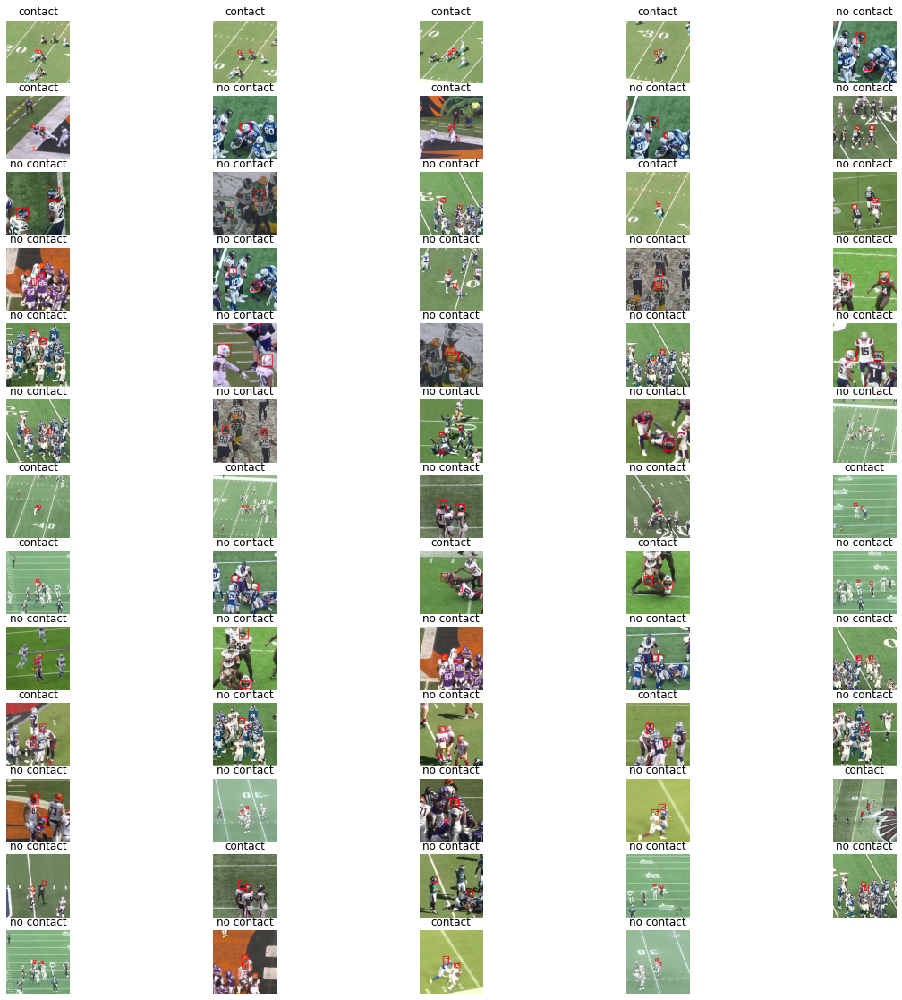

In [26]:
batch = next(iter(train_loader))

means = (0.485, 0.456, 0.406) # the means used to normalize the data
stds = (0.229, 0.224, 0.225) # the stds used to normalize the data
visualize_batch(batch, means, stds)

In [24]:
data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef()], cbs=WandbCallback()).to_fp16()

In [25]:
learn.fit_one_cycle(1, 1e-3)

Could not gather input dimensions
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'NFLFrameDataset' object has no attribute 'items'


epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.390688,0.374090,0.828803,0.577764,13:43


## PyTorch Dataloaders using Decord

My goal right now is to create a PyTorch dataloader that loads images using Decord it's easy since I already have the data.

The way I did was by creating a frame_df, let's take a look into it again.

In [8]:
def get_frames_df(df_combo, kf_dict, split, sample_every_n_frame=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, shuffle=True, seed=42):
    set_seed(seed, True)
    
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % 6 == 0')
        val_combo = val_combo.query('(290 - frame) % 6 == 0')
    
    if sample_train is not None:
        train_combo = train_combo.sample(frac=sample_train, random_state=seed)
        
    if sample_val is not None:
        val_combo = val_combo.sample(frac=sample_val, random_state=seed)
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])
        
    if shuffle:
        rand_id = np.arange(0, len(train_combo))
        np.random.shuffle(rand_id)
        
        train_combo['rand_id'] = rand_id
        train_combo = train_combo.sort_values(['frame', 'rand_id'])
        train_combo = train_combo.drop('rand_id', axis=1)

    frames_df = pd.concat([train_combo, val_combo], axis=0)
    frames_df.frame = frames_df.frame.astype('int') 
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
        
    return frames_df

It seems that I created the frame path wihtin the dataframe, but I'd rather not do that now. I'll get the frames within the dataloader to enable more versatility later on. 

I'll also introduce a new concept of shuffling game_plays only instead of shuffling all the frames. This would enable easier loading of images through caching.

In [10]:
frames_df = get_frames_df(df_combo_with_helmets, kf_dict, 0, undersample_no_contact=True)

In [9]:
def crop_frame(frame, x, y, size):
    size = size // 2
    
    if y-size < 0:
        min_y = 0
        max_y = min_y + 2*size
        
    elif y+size > 719:
        min_y = 719 - 2*size
        max_y = 719
        
    else:
        min_y = y - size
        max_y = y + size
    
    if x-size < 0:
        min_x = 0
        max_x = min_x + 2*size
        
    elif x+size > 1279:
        min_x = 1279 - 2*size
        max_x = 1279
        
    else:
        min_x = x - size
        max_x = x + size
        
    cropped_frame = frame[int(min_y):int(max_y), 
                          int(min_x):int(max_x), :]
    return cropped_frame

In [10]:
from decord import VideoReader
from decord import cpu, gpu

v = VideoReader('nfl-player-contact-detection/train/58168_003392_All29.mp4')

In [38]:
%%time

# Test seeking behavior

v.seek_accurate(100)
f1 = v.next().asnumpy()
f2 = v[100].asnumpy()

assert (f1 == f2).sum() == f1.shape[0]*f1.shape[1]*f1.shape[2]

CPU times: user 284 ms, sys: 25.1 ms, total: 309 ms
Wall time: 113 ms


In [46]:
%%time

# Test skipping behavior

v.seek_accurate(100)
f1 = v.next().asnumpy()
f2 = v[100].asnumpy()

assert (f1 == f2).sum() == f1.shape[0]*f1.shape[1]*f1.shape[2]

v.skip_frames(1)
f1 = v.next().asnumpy()
f2 = v[102].asnumpy()

assert (f1 == f2).sum() == f1.shape[0]*f1.shape[1]*f1.shape[2]

CPU times: user 498 ms, sys: 17.8 ms, total: 516 ms
Wall time: 184 ms


So skip works by skipping from the current position, while seek doesn't care. 

Is there a difference in speed?

In [23]:
v = VideoReader('nfl-player-contact-detection/train/58168_003392_All29.mp4')

In [16]:
%%time

def get_frame():
    # v = VideoReader('nfl-player-contact-detection/train/58168_003392_All29.mp4')
    # v.skip_frames(100)
    # f = v.next().asnumpy()
    # v.seek(0)
    f = v.get_batch([1])
    return f

_ = get_frame()

CPU times: user 123 ms, sys: 13.6 ms, total: 137 ms
Wall time: 52.8 ms


In [53]:
%%time

def get_frame():
    v.seek_accurate(100)
    return v.next().asnumpy()

_ = get_frame()

CPU times: user 136 ms, sys: 28 ms, total: 164 ms
Wall time: 56.8 ms


In [91]:
%%time


_ = v.get_batch([101, 102, 103, 104, 105, 107])

CPU times: user 165 ms, sys: 544 µs, total: 166 ms
Wall time: 68.4 ms


In [85]:
%%time

# v.seek(101)
_ = v.next()

CPU times: user 2.08 ms, sys: 205 µs, total: 2.28 ms
Wall time: 1.28 ms


In [10]:
from torch.utils.data import Dataset, DataLoader
from decord import VideoReader
from decord import cpu, gpu
from functools import lru_cache

class NFLFrameDataset(Dataset):
    def __init__(self, frames_df, vids_path, transform=None, views=['Sideline', 'Endzone'], h=720, w=1280, crop_size=256, ctx=cpu()):
        self.frames_df = frames_df
        self.video_readers = self.get_video_readers(frames_df, vids_path, views, h, w, ctx)
        self.crop_size = crop_size
        self.transform = transform
        
    def __len__(self):
        return len(self.frames_df)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        frame = self.get_frame(row.game_play, row['view'], row.frame)
        frame = crop_frame(frame, row.center_x, row.center_y, self.crop_size)
        if self.transform is not None:
            frame = self.transform(image=frame)['image']
        return frame, row.contact
            
    def get_video_readers(self, frames_df, vids_path, views, h, w, ctx):
        video_readers = {}
        for gp in frames_df.game_play.unique():
            for view in views:
                # Each value will contain the video reader and the last seeked frame
                video_readers[(gp, view)] = [VideoReader((BASE_DIR/'train'/f'{gp}_{view}.mp4').as_posix(), ctx=ctx, height=h, width=w), 0]
        return video_readers
    
    @lru_cache(maxsize=500)
    def get_frame(self, game_play, view, frame_no):
        video_reader, cur_frame = self.video_readers[(game_play, view)]
#         if frame_no == cur_frame:
#             frame = video_reader.next()
#         else:
#             video_reader.seek_accurate(frame_no)
#             frame = video_reader.next()
            
#         self.video_readers[(game_play, view)][1] = frame_no + 1
        frame = video_reader[frame_no]
        video_reader.seek(0)
        return frame.asnumpy()

I should create a test for this dataset to make sure that it's working.

In [16]:
frames_df = get_frames_df(df_combo_with_helmets, kf_dict, 0, sample_every_n_frame=3, sample_train=0.1, sample_val=0.07, undersample_no_contact=True)
ds = NFLFrameDataset(frames_df, BASE_DIR)

In [17]:
import unittest

class TestNFLDataset2D(unittest.TestCase):    
    def test_ds_get_frame(self):
        random_game_play = np.random.choice(frames_df.game_play.unique())
        random_view = np.random.choice(['Sideline', 'Endzone'])
        random_frame = np.random.choice(frames_df.query('game_play == @random_game_play and view == @random_view').frame.unique())
        
        v = VideoReader(f'nfl-player-contact-detection/train/{random_game_play}_{random_view}.mp4')
        f1 = v[random_frame].asnumpy()
        f2 = ds.get_frame(random_game_play, random_view, random_frame)
        
        self.assertEqual((f1 == f2).sum(), f1.shape[0]*f1.shape[1]*f1.shape[2])
        
    def test_ds_seek_back(self):
        random_game_play = np.random.choice(frames_df.game_play.unique())
        random_view = np.random.choice(['Sideline', 'Endzone'])        
        _ = ds.get_frame(random_game_play, random_view, 100)
        
        frame_no = 50
        v = VideoReader(f'nfl-player-contact-detection/train/{random_game_play}_{random_view}.mp4')
        f1 = v[frame_no].asnumpy()
        f2 = ds.get_frame(random_game_play, random_view, frame_no)
        
        self.assertEqual((f1 == f2).sum(), f1.shape[0]*f1.shape[1]*f1.shape[2])
        
        
unittest.main(argv=[''], verbosity=2, exit=False)

test_ds_get_frame (__main__.TestNFLDataset2D) ... ok
test_ds_seek_back (__main__.TestNFLDataset2D) ... ok

----------------------------------------------------------------------
Ran 2 tests in 0.550s

OK


Now let's test adding albumentations to this.

In [11]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

frames_df = get_frames_df(df_combo_with_helmets, kf_dict, 0, sample_every_n_frame=3, sample_train=0.1, sample_val=0.07, undersample_no_contact=True)
train_ds = NFLFrameDataset(frames_df.query('~is_valid'), BASE_DIR, transform=train_transform)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), BASE_DIR, transform=val_transform)

In [13]:
frame, label = train_ds[0]

In [16]:
frame.shape, frame.dtype, type(frame)

(torch.Size([3, 256, 256]), torch.float32, torch.Tensor)

Let's visualize a batch. Function created by ChatGPT

In [44]:
def visualize_batch(batch, means, stds):
    """
    Visualize a batch of image data using Matplotlib.
    
    Parameters:
        - batch_tensor (torch.Tensor): A batch of image data in the shape (batch_size, channels, height, width).
        - means (tuple): A tuple of means for each channel in the image data.
        - stds (tuple): A tuple of standard deviations for each channel in the image data.
    """
    # Make a copy of the batch tensor so that we don't modify the original data
    batch_tensor = batch[0].clone()
    
    # De-normalize the data using the means and stds
    batch_tensor = batch_tensor * torch.tensor(stds, dtype=batch_tensor.dtype).view(3, 1, 1) + torch.tensor(means, dtype=batch_tensor.dtype).view(3, 1, 1)
    
    # Convert the data to numpy and transpose it to (batch_size, height, width, channels)
    batch_np = batch_tensor.numpy().transpose(0, 2, 3, 1)
    
    # Plot the images
    plt.figure(figsize=(20, 20))
    for i in range(batch_np.shape[0]):
        plt.subplot(batch_np.shape[0] // 5 + 1, 5, i + 1)
        plt.imshow(batch_np[i])
        plt.title(['no contact', 'contact'][batch[1][i].item()])
        plt.axis("off")
    plt.show()

In [13]:
train_loader = DataLoader(
    train_ds, batch_size=16, shuffle=False, num_workers=0, pin_memory=False,
)

val_loader = DataLoader(
    val_ds, batch_size=16, shuffle=False, num_workers=0, pin_memory=False,
)

In [18]:
frames_df.query('~is_valid').contact.value_counts()

0    8949
1    8949
Name: contact, dtype: int64

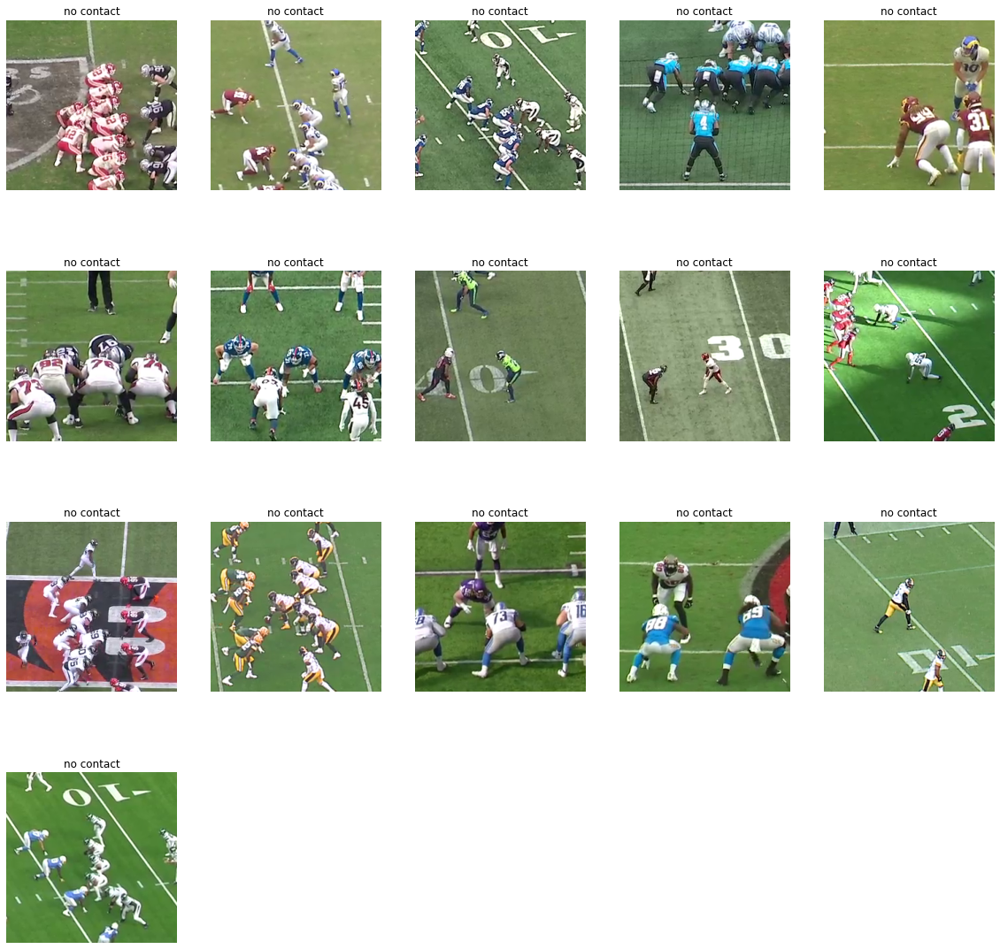

In [14]:
batch = next(iter(train_loader))

means = (0.485, 0.456, 0.406) # the means used to normalize the data
stds = (0.229, 0.224, 0.225) # the stds used to normalize the data
visualize_batch(batch, means, stds)

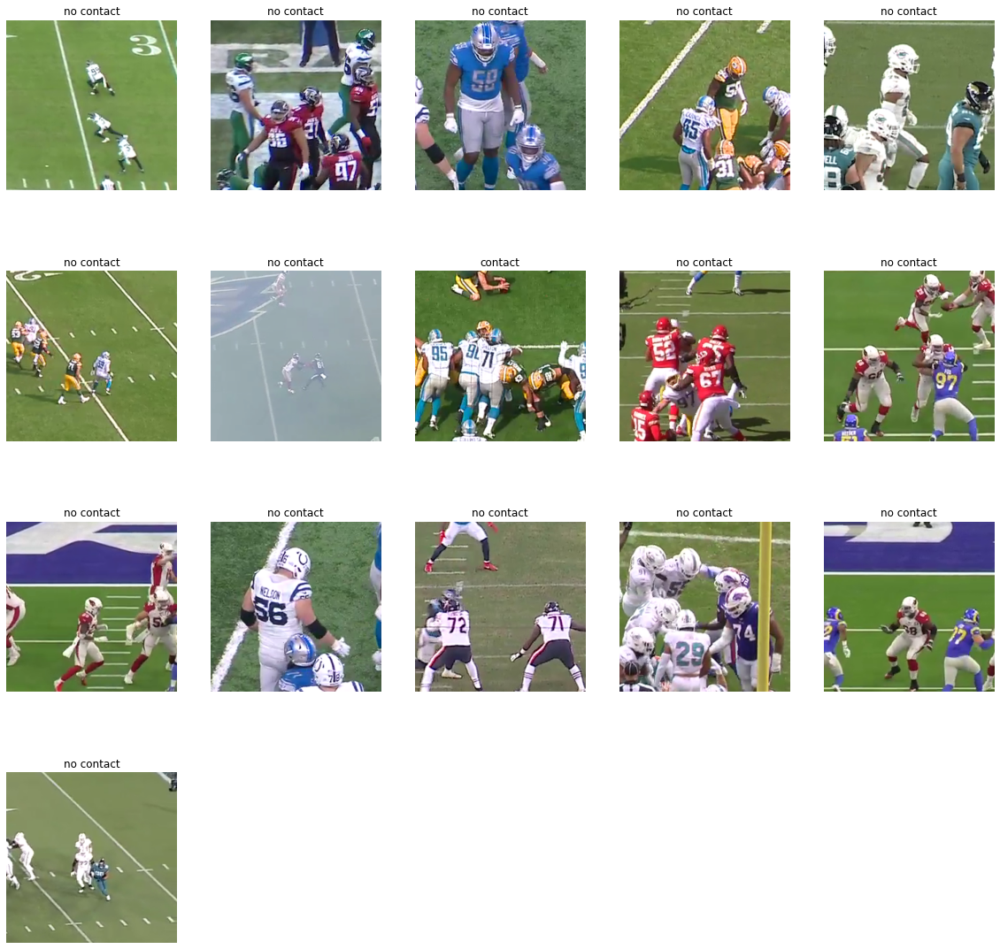

In [16]:
batch = next(iter(val_loader))

means = (0.485, 0.456, 0.406) # the means used to normalize the data
stds = (0.229, 0.224, 0.225) # the stds used to normalize the data
visualize_batch(batch, means, stds)

In [21]:
data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=1, n_in=3)
learn = Learner(data, model, BCEWithLogitsLossFlat(), metrics=MatthewsCorrCoef())

In [ ]:
learn.fit_one_cycle(1, 1e-3)

epoch,train_loss,valid_loss,matthews_corrcoef,time


It seems that the training speed is still a problem. 

Let me summarize what is exactly the problem so far:
1. My dataset is a bunch of videos in which I have to classify segments of it (steps) into contact or no contact
2. The dataset can be loaded in two ways, the first is by using a video reader, and the second by extracting the frames
3. Using the videoreader is good for inference, while so far using it for training isn't as good as I thought
4. Whether I use the video reader or extracted frames for loading the data has another problem, and that is cropping for every pair of players and single player in the dataset
5. If I read the frame in question in order to crop for every pair and single player, then that will be a lot of I/O operations (Possibly 400 for every frame)
6. If I randomly sample the pairs and players in question, and cache the loaded frames, there is a low probability of every using these frames in the first place
7. Therefore, each frame's data need to be close enough to be able to use their cached frames before cropping to reduce the I/O operations
8. If I arange the frames in order that could have a bad effect on the model training, so their must a be a more clever way to shuffle the observations while still maintaining a structure that reduces I/O operations.
9. If I have n game_plays, and I can cache 1000 frames at a time, then I can shuffle the first 1000/n frames of all game_plays, and that will get the best performance out of all, since only the first n I/O operations will be real, and the rest operations will all be from cached data
10. Also sampling from each train or validation needs to sample total frames data, not random points, as this will result in really slow data loading
11. There could also be another sampling strategy, which is sampling game_plays themselves instead of sampling frames. Either way both of them serve to reduce the data loading speed to a mininum, while keeping the training going for as a long as we can.
12. Sampling game_plays can be the right strategy for 2.5D and 3D training, as we would be required to keep a large number of frames in cache, and therefore a smaller number of game_plays would enable the cache to go smoothly without running out of memory

In [8]:
def get_frames_df(df_combo, kf_dict, split, sample_every_n_frame=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, shuffle=True, seed=42):
    set_seed(seed, True)
    
    # Add game_play with frame identifier for sampling
    df_combo['game_play_frame'] = df_combo.game_play + '_' + df_combo.frame.astype(str)
    
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % 6 == 0')
        val_combo = val_combo.query('(290 - frame) % 6 == 0')
    
    if sample_train is not None:
        train_frames = train_combo.game_play_frame.unique()
        train_frames_sample = np.random.choice(train_frames, int(sample_train*len(train_frames)), replace=False)
        train_combo = train_combo.query('game_play_frame in @train_frames_sample')
        
    if sample_val is not None:
        val_frames = val_combo.game_play_frame.unique()
        val_frames_sample = np.random.choice(val_frames, int(sample_val*len(val_frames)), replace=False)
        val_combo = val_combo.query('game_play_frame in @val_frames_sample')
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])
        
    if shuffle:
        rand_id = np.arange(0, len(train_combo))
        np.random.shuffle(rand_id)
        
        train_combo['rand_id'] = rand_id
        train_combo = train_combo.sort_values(['frame', 'rand_id'])
        train_combo = train_combo.drop('rand_id', axis=1)

    frames_df = pd.concat([train_combo, val_combo], axis=0)
    frames_df.frame = frames_df.frame.astype('int') 
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
        
    return frames_df


def crop_frame(frame, x, y, size):
    size = size // 2
    
    if y-size < 0:
        min_y = 0
        max_y = min_y + 2*size
        
    elif y+size > 719:
        min_y = 719 - 2*size
        max_y = 719
        
    else:
        min_y = y - size
        max_y = y + size
    
    if x-size < 0:
        min_x = 0
        max_x = min_x + 2*size
        
    elif x+size > 1279:
        min_x = 1279 - 2*size
        max_x = 1279
        
    else:
        min_x = x - size
        max_x = x + size
        
    cropped_frame = frame[int(min_y):int(max_y), 
                          int(min_x):int(max_x), :]
    return cropped_frame

In [9]:
from torch.utils.data import Dataset, DataLoader
from decord import VideoReader
from decord import cpu, gpu
from functools import lru_cache

class NFLFrameDataset(Dataset):
    def __init__(self, frames_df, vids_path, transform=None, views=['Sideline', 'Endzone'], h=720, w=1280, crop_size=256, ctx=cpu()):
        self.frames_df = frames_df
        self.video_readers = self.get_video_readers(frames_df, vids_path, views, h, w, ctx)
        self.crop_size = crop_size
        self.transform = transform
        
    def __len__(self):
        return len(self.frames_df)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        frame = self.get_frame(row.game_play, row['view'], row.frame)
        frame = crop_frame(frame, row.center_x, row.center_y, self.crop_size)
        if self.transform is not None:
            frame = self.transform(image=frame)['image']
        return frame, row.contact
            
    def get_video_readers(self, frames_df, vids_path, views, h, w, ctx):
        video_readers = {}
        for gp in frames_df.game_play.unique():
            for view in views:
                # Each value will contain the video reader and the last seeked frame
                video_readers[(gp, view)] = [VideoReader((BASE_DIR/'train'/f'{gp}_{view}.mp4').as_posix(), ctx=ctx, height=h, width=w), 0]
        return video_readers
    
    @lru_cache(maxsize=100)
    def get_frame(self, game_play, view, frame_no):
        video_reader, cur_frame = self.video_readers[(game_play, view)]
#         if frame_no == cur_frame:
#             frame = video_reader.next()
#         else:
#             video_reader.seek_accurate(frame_no)
#             frame = video_reader.next()
            
#         self.video_readers[(game_play, view)][1] = frame_no + 1
        frame = video_reader[frame_no]
        video_reader.seek(0)
        return frame.asnumpy()
    
    
def visualize_batch(batch, means, stds):
    """
    Visualize a batch of image data using Matplotlib.
    
    Parameters:
        - batch_tensor (torch.Tensor): A batch of image data in the shape (batch_size, channels, height, width).
        - means (tuple): A tuple of means for each channel in the image data.
        - stds (tuple): A tuple of standard deviations for each channel in the image data.
    """
    # Make a copy of the batch tensor so that we don't modify the original data
    batch_tensor = batch[0].clone()
    
    # De-normalize the data using the means and stds
    batch_tensor = batch_tensor * torch.tensor(stds, dtype=batch_tensor.dtype).view(3, 1, 1) + torch.tensor(means, dtype=batch_tensor.dtype).view(3, 1, 1)
    
    # Convert the data to numpy and transpose it to (batch_size, height, width, channels)
    batch_np = batch_tensor.numpy().transpose(0, 2, 3, 1)
    
    # Plot the images
    plt.figure(figsize=(20, 20))
    for i in range(batch_np.shape[0]):
        plt.subplot(batch_np.shape[0] // 5 + 1, 5, i + 1)
        plt.imshow(batch_np[i])
        plt.title(['no contact', 'contact'][batch[1][i].item()])
        plt.axis("off")
    plt.show()

In [10]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

frames_df = get_frames_df(df_combo_with_helmets, kf_dict, 0, sample_every_n_frame=3, sample_train=0.1,
                          sample_val=0.1, undersample_no_contact=True)
train_ds = NFLFrameDataset(frames_df.query('~is_valid'), BASE_DIR, transform=train_transform)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), BASE_DIR, transform=val_transform)

train_loader = DataLoader(
    train_ds, batch_size=16, shuffle=False, num_workers=0, pin_memory=False,
)

val_loader = DataLoader(
    val_ds, batch_size=16, shuffle=False, num_workers=0, pin_memory=False,
)

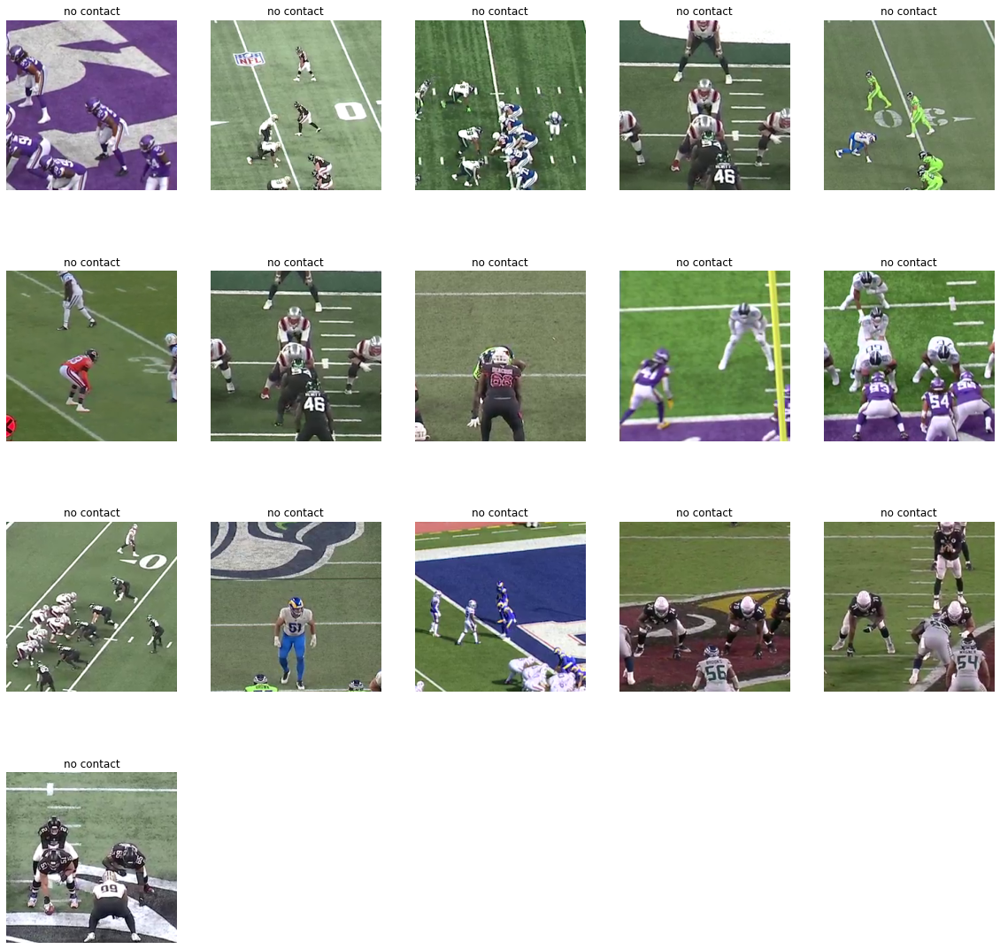

In [11]:
batch = next(iter(train_loader))

means = (0.485, 0.456, 0.406) # the means used to normalize the data
stds = (0.229, 0.224, 0.225) # the stds used to normalize the data
visualize_batch(batch, means, stds)

In [12]:
data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=1, n_in=3)
learn = Learner(data, model, BCEWithLogitsLossFlat(), metrics=MatthewsCorrCoef())

In [13]:
learn.fit_one_cycle(1, 1e-3)

epoch,train_loss,valid_loss,matthews_corrcoef,time
0,0.648000,0.586678,0.000000,13:35


In [14]:
learn.metrics = [accuracy, MatthewsCorrCoef()]

In [15]:
learn.validate()

(#3) [0.5866779685020447,0.8848193287849426,0.0]

In [18]:
frames_df.query('is_valid').contact.value_counts(normalize=True)

0    0.884819
1    0.115181
Name: contact, dtype: float64

It is not working like that, as you can see the models is predicting all negative...

Let's check shuffling the frames? 

In order to shuffle frames I need to give every unique frame number an random id, then I need to sort by that id.

In [34]:
frames_df = frames_df.copy()

In [37]:
unique_frames = frames_df.frame.unique()
rand_ids = np.arange(0, len(unique_frames))
np.random.shuffle(rand_ids)
frame_id_map = {unique_frames[i]: rand_ids[i] for i in range(len(rand_ids))}

frames_df.loc[:, 'frame_id'] = frames_df['frame'].replace(frame_id_map)
frames_df = frames_df.sort_values('frame_id')

In [10]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

frames_df = get_frames_df(df_combo_with_helmets, kf_dict, 0, sample_every_n_frame=3, sample_train=0.1,
                          sample_val=0.1, undersample_no_contact=True).copy()

unique_frames = frames_df.frame.unique()
rand_ids = np.arange(0, len(unique_frames))
np.random.shuffle(rand_ids)
frame_id_map = {unique_frames[i]: rand_ids[i] for i in range(len(rand_ids))}

frames_df.loc[:, 'frame_id'] = frames_df['frame'].replace(frame_id_map)
frames_df = frames_df.sort_values('frame_id')

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), BASE_DIR, transform=train_transform)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), BASE_DIR, transform=val_transform)

train_loader = DataLoader(
    train_ds, batch_size=16, shuffle=False, num_workers=0, pin_memory=False,
)

val_loader = DataLoader(
    val_ds, batch_size=16, shuffle=False, num_workers=0, pin_memory=False,
)

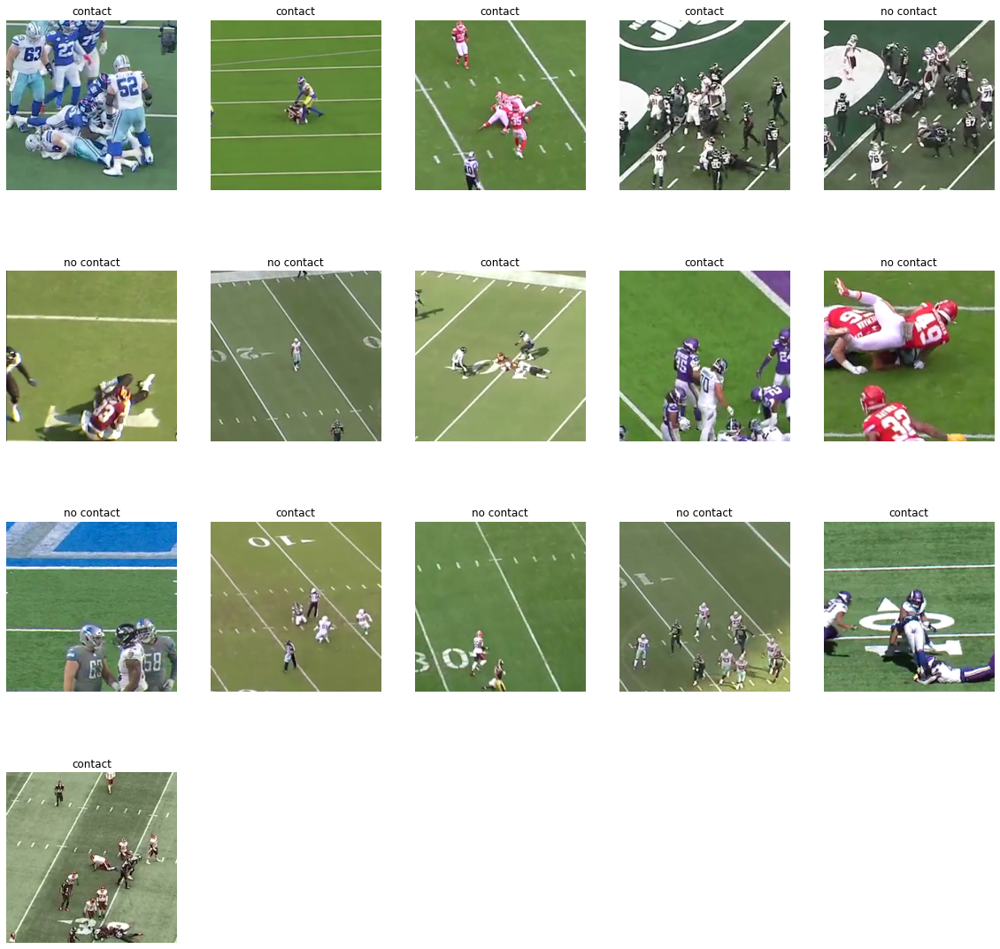

In [41]:
batch = next(iter(train_loader))

means = (0.485, 0.456, 0.406) # the means used to normalize the data
stds = (0.229, 0.224, 0.225) # the stds used to normalize the data
visualize_batch(batch, means, stds)

In [11]:
data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=1, n_in=3)
learn = Learner(data, model, BCEWithLogitsLossFlat(), metrics=[accuracy, MatthewsCorrCoef()])

In [12]:
learn.fit_one_cycle(1, 1e-3)

epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.703061,0.663587,0.884819,0.000000,13:31


Why is it not working? What could be the problem?

It can't be that there is no signal since I already know that there is signal!

Then what could be the problem? In the previous pipeline I've added helmet bounding boxes, but could it be because of ground contact?

I'll drop it and test again, and if it doesn't work I'll the add the bounding boxes to the pairs and see again. 

In [12]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

frames_df = get_frames_df(df_combo_with_helmets, kf_dict, 0, sample_every_n_frame=3, sample_train=0.1,
                          sample_val=0.1, undersample_no_contact=True).copy()

unique_frames = frames_df.frame.unique()
rand_ids = np.arange(0, len(unique_frames))
np.random.shuffle(rand_ids)
frame_id_map = {unique_frames[i]: rand_ids[i] for i in range(len(rand_ids))}

frames_df.loc[:, 'frame_id'] = frames_df['frame'].replace(frame_id_map)
frames_df = frames_df.sort_values('frame_id')

frames_df = frames_df.query('nfl_player_id_2 != "G"')

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), BASE_DIR, transform=train_transform)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), BASE_DIR, transform=val_transform)

train_loader = DataLoader(
    train_ds, batch_size=16, shuffle=False, num_workers=0, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=16, shuffle=False, num_workers=0, pin_memory=True,
)

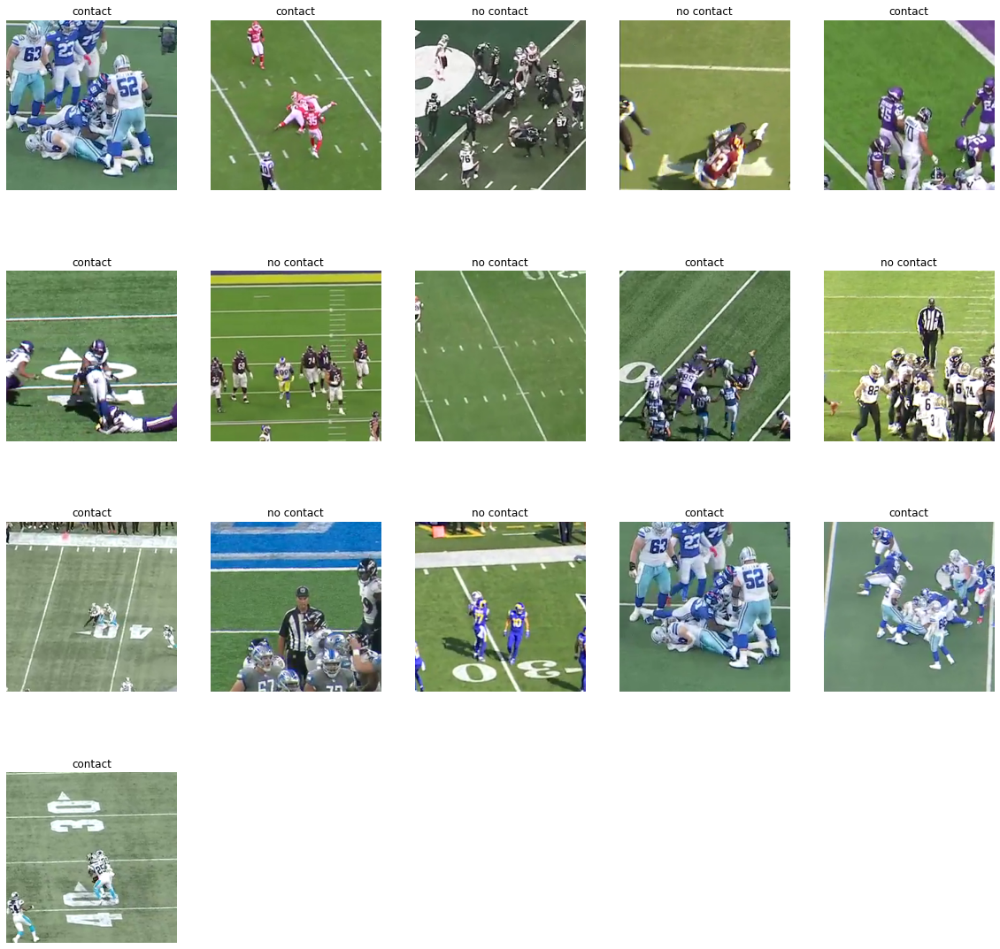

In [13]:
batch = next(iter(train_loader))

means = (0.485, 0.456, 0.406) # the means used to normalize the data
stds = (0.229, 0.224, 0.225) # the stds used to normalize the data
visualize_batch(batch, means, stds)

In [14]:
data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=1, n_in=3)
learn = Learner(data, model, BCEWithLogitsLossFlat(), metrics=[accuracy, MatthewsCorrCoef()])

In [15]:
learn.fit_one_cycle(1, 1e-3)

epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.718950,1.008788,0.782311,0.000000,08:39


I'll test adding the helmet then.

In [11]:
 def add_helmets(frame, row):
        frame = frame.copy()
        
        if row.left_1 != np.nan:
            frame = cv2.rectangle(frame, 
                                  (int(row.left_1), int(row.top_1)),
                                  (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                                  (255, 0, 0), 2)
        if row.left_2 != np.nan:
            frame = cv2.rectangle(frame, 
                                  (int(row.left_2), int(row.top_2)),
                                  (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                                  (255, 0, 0), 2)
        return frame

class NFLFrameDataset(Dataset):
    def __init__(self, frames_df, vids_path, transform=None, views=['Sideline', 'Endzone'], h=720, w=1280, crop_size=256, ctx=cpu()):
        self.frames_df = frames_df
        self.video_readers = self.get_video_readers(frames_df, vids_path, views, h, w, ctx)
        self.crop_size = crop_size
        self.transform = transform
        
    def __len__(self):
        return len(self.frames_df)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        frame = self.get_frame(row.game_play, row['view'], row.frame)
        frame = add_helmets(frame, row)
        frame = crop_frame(frame, row.center_x, row.center_y, self.crop_size)
        if self.transform is not None:
            frame = self.transform(image=frame)['image']
        return frame, row.contact
            
    def get_video_readers(self, frames_df, vids_path, views, h, w, ctx):
        video_readers = {}
        for gp in frames_df.game_play.unique():
            for view in views:
                # Each value will contain the video reader and the last seeked frame
                video_readers[(gp, view)] = [VideoReader((BASE_DIR/'train'/f'{gp}_{view}.mp4').as_posix(), ctx=ctx, height=h, width=w), 0]
        return video_readers
    
    @lru_cache(maxsize=192)
    def get_frame(self, game_play, view, frame_no):
        video_reader, cur_frame = self.video_readers[(game_play, view)]
#         if frame_no == cur_frame:
#             frame = video_reader.next()
#         else:
#             video_reader.seek_accurate(frame_no)
#             frame = video_reader.next()
            
#         self.video_readers[(game_play, view)][1] = frame_no + 1
        frame = video_reader[frame_no]
        video_reader.seek(0)
        return frame.asnumpy()

In [12]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

frames_df = get_frames_df(df_combo_with_helmets[df_combo_with_helmets.left_2.notnull()].copy(),
                          kf_dict, 0, sample_every_n_frame=3, sample_train=0.1,
                          sample_val=0.1, undersample_no_contact=True).copy()

unique_frames = frames_df.frame.unique()
rand_ids = np.arange(0, len(unique_frames))
np.random.shuffle(rand_ids)
frame_id_map = {unique_frames[i]: rand_ids[i] for i in range(len(rand_ids))}

frames_df.loc[:, 'frame_id'] = frames_df['frame'].replace(frame_id_map)
frames_df = frames_df.sort_values('frame_id')

frames_df = frames_df.query('nfl_player_id_2 != "G"')

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), BASE_DIR, transform=train_transform)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), BASE_DIR, transform=val_transform)

train_loader = DataLoader(
    train_ds, batch_size=16, shuffle=False, num_workers=0, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=16, shuffle=False, num_workers=0, pin_memory=True,
)

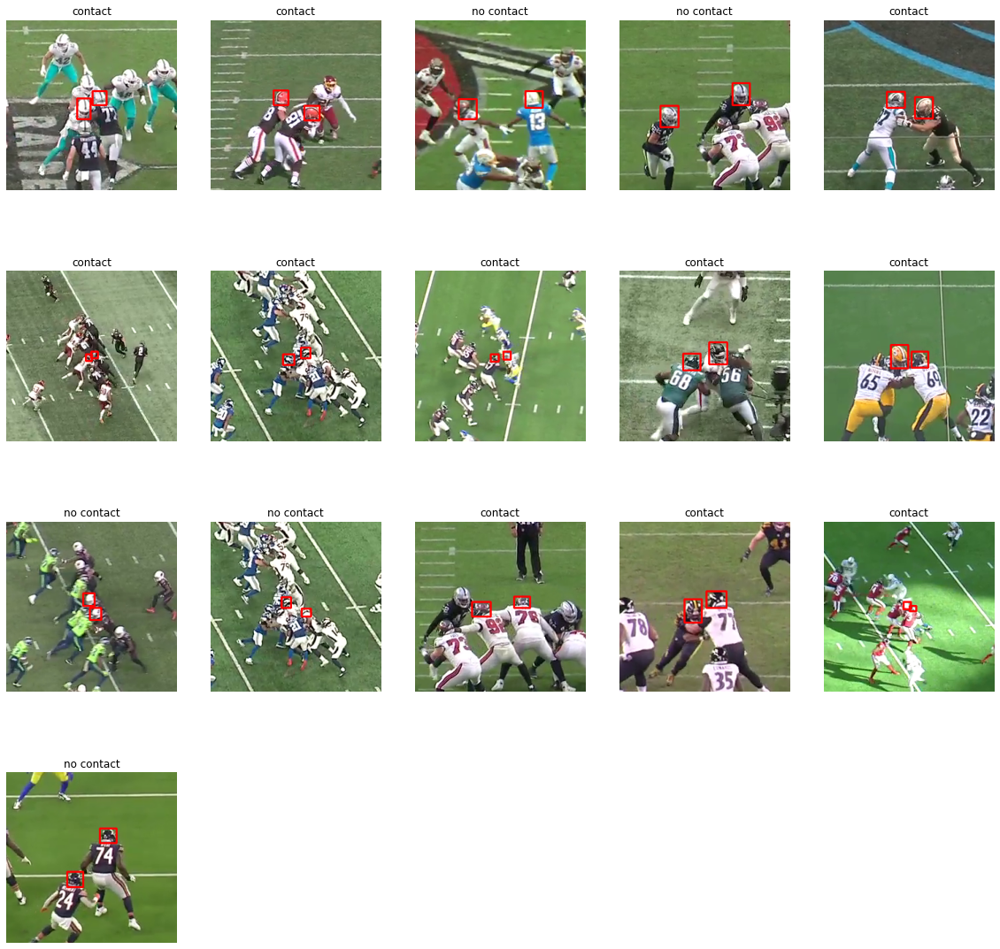

In [13]:
batch = next(iter(train_loader))

means = (0.485, 0.456, 0.406) # the means used to normalize the data
stds = (0.229, 0.224, 0.225) # the stds used to normalize the data
visualize_batch(batch, means, stds)

In [14]:
data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=1, n_in=3)
learn = Learner(data, model, BCEWithLogitsLossFlat(), metrics=[accuracy, MatthewsCorrCoef()])

In [15]:
learn.fit_one_cycle(1, 1e-3)

epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.589600,0.640238,0.782464,0.000000,10:10


Okay, the problem now is that I need to know if that is specific to this pipeline, does that also replicate with the old fastai frames pipeline.

The differences that I made here are:
1. Sampling total frames data instead of sampling pairs

Therefore, I need to test the fastai pipeline with this same data, and also test it with its old sampling to figure out where the problem actually is.

In [14]:
from nflutils.dataprep import *

In [16]:
frames_df = get_frames_df(df_combo_with_helmets[df_combo_with_helmets.left_2.notnull()].copy(),
                          kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=0.1,
                          sample_val=0.1, undersample_no_contact=True).copy()

frames_df = frames_df.query('nfl_player_id_2 != "G"')

In [17]:
dls = get_rgb_dls(frames_df, img_size=256, bs=16)

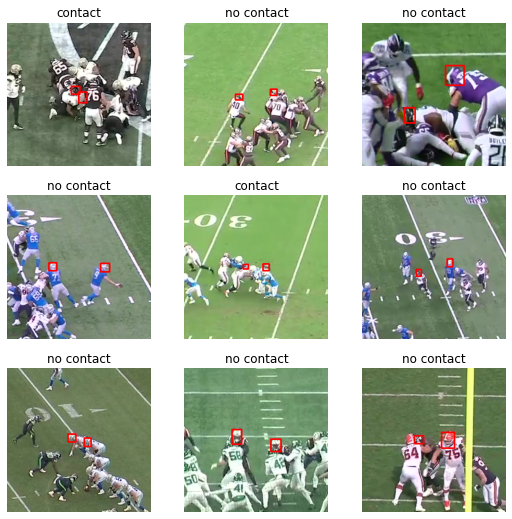

In [18]:
dls.show_batch()

In [19]:
learn = vision_learner(dls, 'convnext_tiny', metrics=[accuracy, MatthewsCorrCoef()])

Downloading: "https://dl.fbaipublicfiles.com/convnext/convnext_tiny_1k_224_ema.pth" to /root/.cache/torch/hub/checkpoints/convnext_tiny_1k_224_ema.pth


In [20]:
learn.fit_one_cycle(1, 1e-3)

epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.692764,0.639079,0.622354,0.211878,01:56


Now let's try with the new shuffling method

In [ ]:
def get_frames_df(df_combo, kf_dict, split, frames_path, sample_every_n_frame=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, shuffle=True, seed=42):
    set_seed(seed, True)
    
    # Add game_play with frame identifier for sampling
    df_combo['game_play_frame'] = df_combo.game_play + '_' + df_combo.frame.astype(str)
    
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % 6 == 0')
        val_combo = val_combo.query('(290 - frame) % 6 == 0')
    
    if sample_train is not None:
        train_frames = train_combo.game_play_frame.unique()
        train_frames_sample = np.random.choice(train_frames, int(sample_train*len(train_frames)), replace=False)
        train_combo = train_combo.query('game_play_frame in @train_frames_sample')
        
    if sample_val is not None:
        val_frames = val_combo.game_play_frame.unique()
        val_frames_sample = np.random.choice(val_frames, int(sample_val*len(val_frames)), replace=False)
        val_combo = val_combo.query('game_play_frame in @val_frames_sample')
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])
        
    if shuffle:
        rand_id = np.arange(0, len(train_combo))
        np.random.shuffle(rand_id)
        
        train_combo['rand_id'] = rand_id
        train_combo = train_combo.sort_values(['frame', 'rand_id'])
        train_combo = train_combo.drop('rand_id', axis=1)

    frames_df = pd.concat([train_combo, val_combo], axis=0)
    frames_df.frame = frames_df.frame.astype('int') 
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
        
    frames_df['path'] = frames_df.apply(lambda x: get_frame_path(x, frames_path), axis=1)
        
    return frames_df


In [71]:
frames_df = get_frames_df(df_combo_with_helmets[df_combo_with_helmets.left_2.notnull()].copy(),
                          kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=0.1,
                          sample_val=0.1, undersample_no_contact=True).copy()

unique_frames = frames_df.frame.unique()
rand_ids = np.arange(0, len(unique_frames))
np.random.shuffle(rand_ids)
frame_id_map = {unique_frames[i]: rand_ids[i] for i in range(len(rand_ids))}

frames_df.loc[:, 'frame_id'] = frames_df['frame'].replace(frame_id_map)
frames_df = frames_df.sort_values('frame_id')

frames_df = frames_df.query('nfl_player_id_2 != "G"')

In [72]:
dls = get_rgb_dls(frames_df, img_size=256, bs=16, shuffle=False)

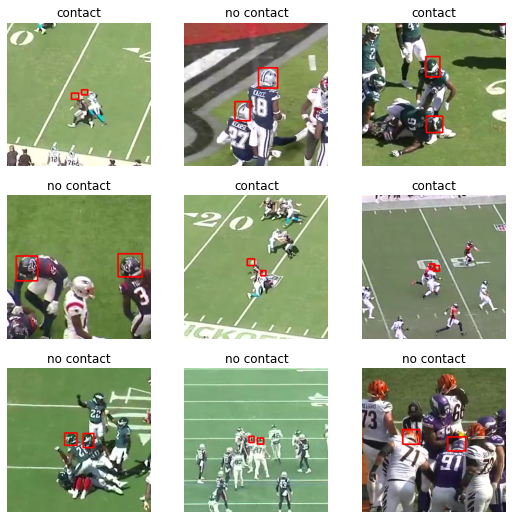

In [42]:
dls.show_batch()

In [43]:
learn = vision_learner(dls, 'convnext_tiny', metrics=[accuracy, MatthewsCorrCoef()])

In [30]:
learn.fit_one_cycle(1, 1e-3)

epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.728186,0.652887,0.624721,0.210059,01:51


Alright, that works very much. So what is wrong with my new pipeline? 

Let's test it again since I'm using frames on this one.

In [82]:
from torch.utils.data import Dataset, DataLoader
from decord import VideoReader
from decord import cpu, gpu
from functools import lru_cache

@lru_cache(maxsize=192)
def read_img(path):
    frame = cv2.imread(path)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    return frame

def get_img(row, img_size=128, helmets=True):
    
    frame = read_img(row.path)
    
    if helmets:
        frame = add_helmets(frame, row)
    
    size = img_size // 2
    
    if row.center_y-size < 0:
        min_y = 0
        max_y = min_y + 2*size
        
    elif row.center_y+size > 719:
        min_y = 719 - 2*size
        max_y = 719
        
    else:
        min_y = row.center_y - size
        max_y = row.center_y + size
    
    if row.center_x-size < 0:
        min_x = 0
        max_x = min_x + 2*size
        
    elif row.center_x+size > 1279:
        min_x = 1279 - 2*size
        max_x = 1279
        
    else:
        min_x = row.center_x - size
        max_x = row.center_x + size
        
    cropped_frame = frame[int(min_y):int(max_y), 
                          int(min_x):int(max_x), :]
    return cropped_frame

def add_helmets(frame, row):
        frame = frame.copy()
        
        if row.left_1 != np.nan:
            frame = cv2.rectangle(frame, 
                                  (int(row.left_1), int(row.top_1)),
                                  (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                                  (255, 0, 0), 2)
        if row.left_2 != np.nan:
            frame = cv2.rectangle(frame, 
                                  (int(row.left_2), int(row.top_2)),
                                  (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                                  (255, 0, 0), 2)
        return frame

class NFLFrameDataset(Dataset):
    def __init__(self, frames_df, vids_path, transform=None, views=['Sideline', 'Endzone'], h=720, w=1280, crop_size=256, ctx=cpu()):
        self.frames_df = frames_df
        self.video_readers = self.get_video_readers(frames_df, vids_path, views, h, w, ctx)
        self.crop_size = crop_size
        self.transform = transform
        
    def __len__(self):
        return len(self.frames_df)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        # frame = self.get_frame(row.game_play, row['view'], row.frame)
        # frame = add_helmets(frame, row)
        # frame = crop_frame(frame, row.center_x, row.center_y, self.crop_size)
        frame = get_img(row, self.crop_size, True)
        if self.transform is not None:
            frame = self.transform(image=frame)['image']
        return frame, row.contact
            
    def get_video_readers(self, frames_df, vids_path, views, h, w, ctx):
        video_readers = {}
        for gp in frames_df.game_play.unique():
            for view in views:
                # Each value will contain the video reader and the last seeked frame
                video_readers[(gp, view)] = [VideoReader((BASE_DIR/'train'/f'{gp}_{view}.mp4').as_posix(), ctx=ctx, height=h, width=w), 0]
        return video_readers
    
    @lru_cache(maxsize=192)
    def get_frame(self, game_play, view, frame_no):
        video_reader, cur_frame = self.video_readers[(game_play, view)]
#         if frame_no == cur_frame:
#             frame = video_reader.next()
#         else:
#             video_reader.seek_accurate(frame_no)
#             frame = video_reader.next()
            
#         self.video_readers[(game_play, view)][1] = frame_no + 1
        frame = video_reader[frame_no]
        video_reader.seek(0)
        return frame.asnumpy()
    
    
def visualize_batch(batch, means, stds):
    """
    Visualize a batch of image data using Matplotlib.
    
    Parameters:
        - batch_tensor (torch.Tensor): A batch of image data in the shape (batch_size, channels, height, width).
        - means (tuple): A tuple of means for each channel in the image data.
        - stds (tuple): A tuple of standard deviations for each channel in the image data.
    """
    # Make a copy of the batch tensor so that we don't modify the original data
    batch_tensor = batch[0].clone()
    
    # De-normalize the data using the means and stds
    batch_tensor = batch_tensor * torch.tensor(stds, dtype=batch_tensor.dtype).view(3, 1, 1) + torch.tensor(means, dtype=batch_tensor.dtype).view(3, 1, 1)
    
    # Convert the data to numpy and transpose it to (batch_size, height, width, channels)
    batch_np = batch_tensor.numpy().transpose(0, 2, 3, 1)
    
    # Plot the images
    plt.figure(figsize=(20, 20))
    for i in range(batch_np.shape[0]):
        plt.subplot(batch_np.shape[0] // 5 + 1, 5, i + 1)
        plt.imshow(batch_np[i])
        plt.title(['no contact', 'contact'][batch[1][i].item()])
        plt.axis("off")
    plt.show()

In [83]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

frames_df = get_frames_df(df_combo_with_helmets[df_combo_with_helmets.left_2.notnull()].copy(),
                          kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=0.1,
                          sample_val=0.1, undersample_no_contact=True).copy()

unique_frames = frames_df.frame.unique()
rand_ids = np.arange(0, len(unique_frames))
np.random.shuffle(rand_ids)
frame_id_map = {unique_frames[i]: rand_ids[i] for i in range(len(rand_ids))}

frames_df.loc[:, 'frame_id'] = frames_df['frame'].replace(frame_id_map)
frames_df = frames_df.sort_values('frame_id')

frames_df = frames_df.query('nfl_player_id_2 != "G"')

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), BASE_DIR, transform=train_transform)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), BASE_DIR, transform=val_transform)

train_loader = DataLoader(
    train_ds, batch_size=16, shuffle=False, num_workers=8, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=16, shuffle=False, num_workers=8, pin_memory=True,
)

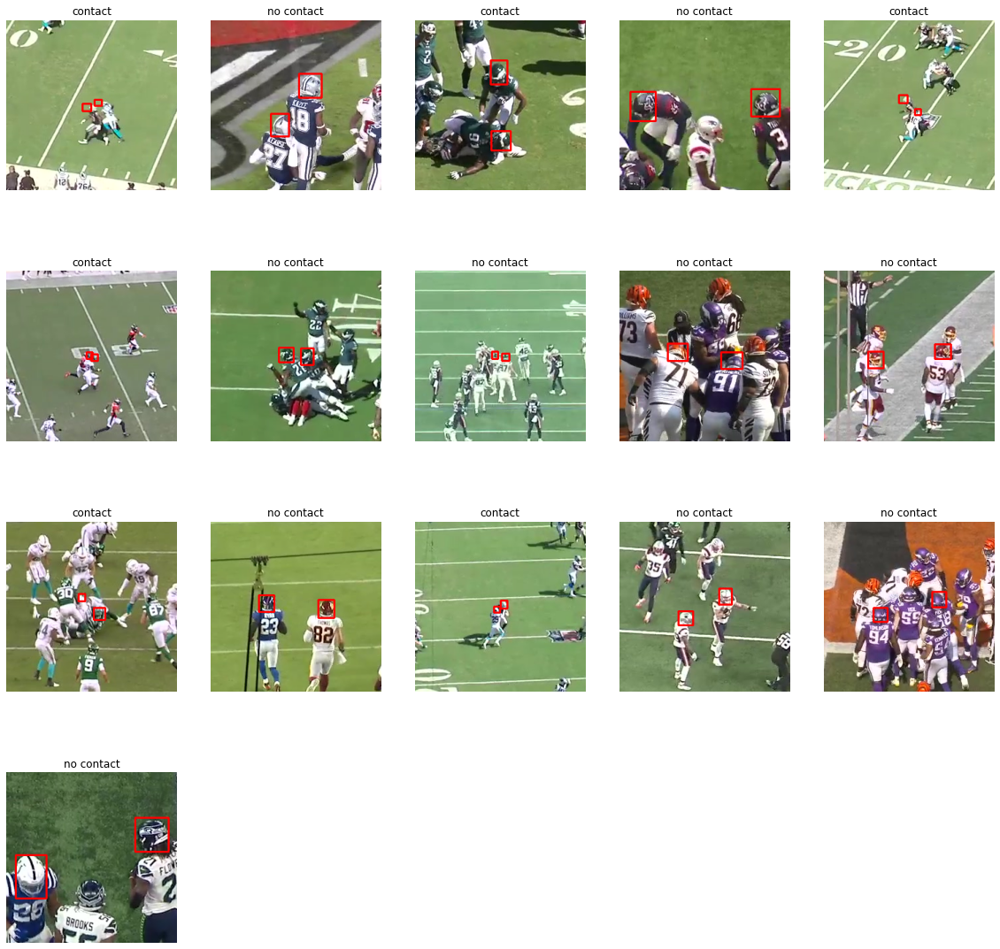

In [84]:
batch = next(iter(train_loader))

means = (0.485, 0.456, 0.406) # the means used to normalize the data
stds = (0.229, 0.224, 0.225) # the stds used to normalize the data
visualize_batch(batch, means, stds)

In [85]:
data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef()]).to_fp16()

In [86]:
learn.fit_one_cycle(1, 1e-3)

epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.626415,0.515453,0.746746,0.417916,01:35


Finally we have something.

Now I want to know why the fastai is faster? Lets try caching and fp16 with fastai.

In [90]:
frames_df = get_frames_df(df_combo_with_helmets[df_combo_with_helmets.left_2.notnull()].copy(),
                          kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=0.1,
                          sample_val=0.1, undersample_no_contact=True).copy()

unique_frames = frames_df.frame.unique()
rand_ids = np.arange(0, len(unique_frames))
np.random.shuffle(rand_ids)
frame_id_map = {unique_frames[i]: rand_ids[i] for i in range(len(rand_ids))}

frames_df.loc[:, 'frame_id'] = frames_df['frame'].replace(frame_id_map)
frames_df = frames_df.sort_values('frame_id')

frames_df = frames_df.query('nfl_player_id_2 != "G"')

In [91]:
 def get_rgb_dls(frames_df, img_size=128, item_tfms=None, batch_tfms=None, bs=64, shuffle=True, drop_last=False):
    return DataBlock(
        blocks=(ImageBlock, CategoryBlock),
        get_x=partial(get_img, img_size=img_size),
        get_y=get_label,
        splitter=ColSplitter(),
        item_tfms=item_tfms,
        batch_tfms=batch_tfms
    ).dataloaders(frames_df, bs=bs, shuffle=shuffle, drop_last=drop_last)

In [92]:
dls = get_rgb_dls(frames_df, img_size=256, bs=16, shuffle=False)

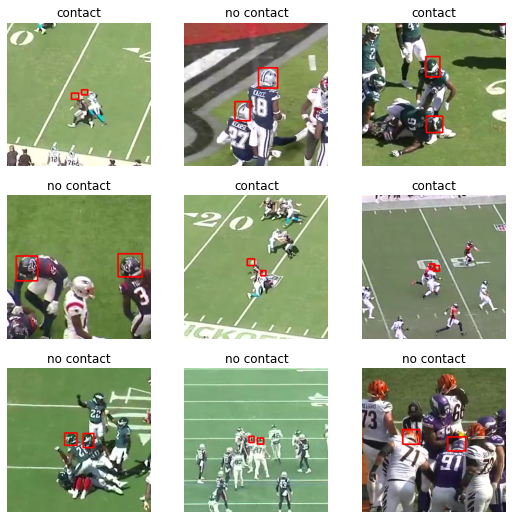

In [93]:
dls.show_batch()

In [94]:
learn = vision_learner(dls, 'convnext_tiny', metrics=[accuracy, MatthewsCorrCoef()]).to_fp16()

In [95]:
learn.fit_one_cycle(1, 1e-3)

epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.727292,0.648827,0.629717,0.182636,01:22


Okay so now I have it that it's finally working. All be it a little slower that I'd like, but that's okay.

The remaining mystery is the cache doesn't seem to be working.

In [107]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

frames_df = get_frames_df(df_combo_with_helmets[df_combo_with_helmets.left_2.notnull()].copy(),
                          kf_dict, 0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=None,
                          sample_val=None, undersample_no_contact=True).copy()

unique_frames = frames_df.frame.unique()
rand_ids = np.arange(0, len(unique_frames))
np.random.shuffle(rand_ids)
frame_id_map = {unique_frames[i]: rand_ids[i] for i in range(len(rand_ids))}

frames_df.loc[:, 'frame_id'] = frames_df['frame'].replace(frame_id_map)
frames_df = frames_df.sort_values('frame_id')

frames_df = frames_df.query('nfl_player_id_2 != "G"')

train_ds = NFLFrameDataset(frames_df.query('~is_valid'), BASE_DIR, transform=train_transform)
val_ds = NFLFrameDataset(frames_df.query('is_valid'), BASE_DIR, transform=val_transform)

train_loader = DataLoader(
    train_ds, batch_size=64, shuffle=False, num_workers=8, pin_memory=True,
)

val_loader = DataLoader(
    val_ds, batch_size=64, shuffle=False, num_workers=8, pin_memory=True,
)

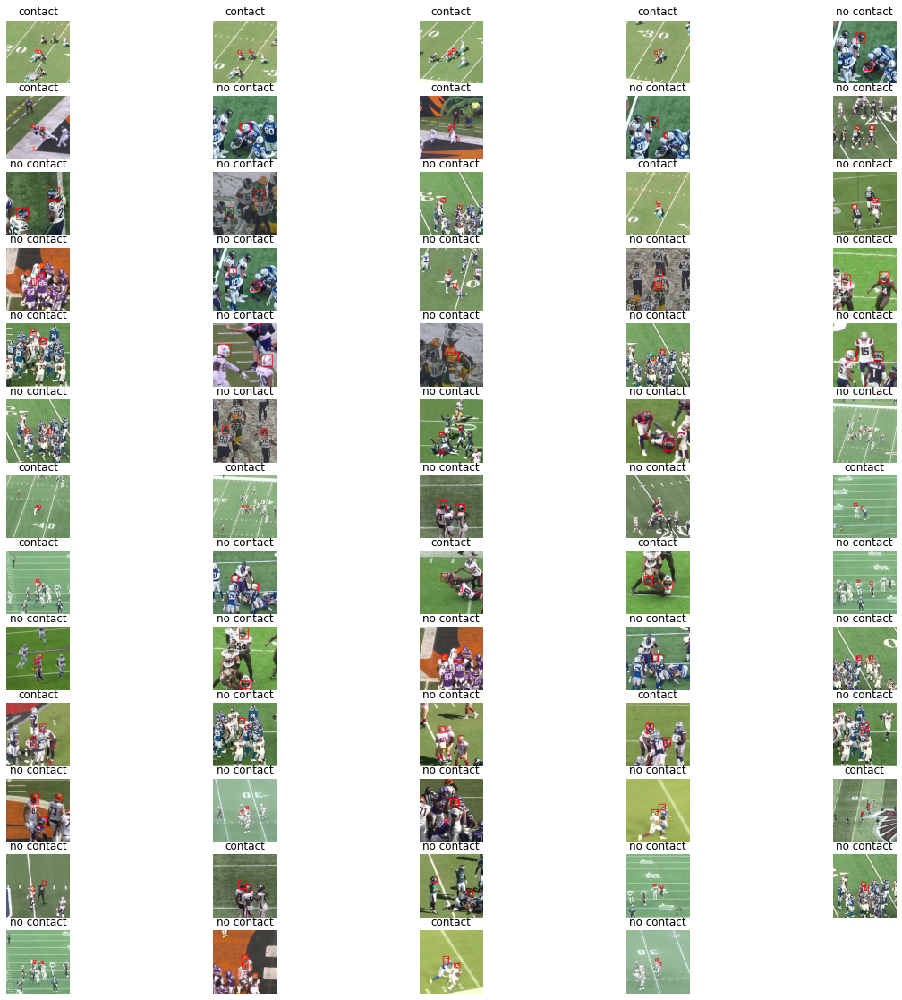

In [108]:
batch = next(iter(train_loader))

means = (0.485, 0.456, 0.406) # the means used to normalize the data
stds = (0.229, 0.224, 0.225) # the stds used to normalize the data
visualize_batch(batch, means, stds)

In [109]:
data = DataLoaders(train_loader, val_loader)
model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef()]).to_fp16()

In [110]:
learn.fit_one_cycle(1, 1e-3)

epoch,train_loss,valid_loss,accuracy,matthews_corrcoef,time
0,0.484675,0.399365,0.817205,0.546901,11:58


What happens if I remove caching?

## Decord video loading

In [8]:
from decord import VideoReader, VideoLoader
from decord import cpu, gpu

In [11]:
vr = VideoReader('nfl-player-contact-detection/train/58168_003392_Sideline.mp4', ctx=cpu())

In [13]:
%timeit frames = vr.get_batch(list(range(100, 107)))

33.6 ms ± 2.3 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [ ]:
CFG.

In [49]:
%timeit frames = vr.get_batch(list(range(6, 13)))

34.5 ms ± 2.82 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [58]:
%timeit frames = vr.get_batch(list(range(13, 43)))

102 ms ± 1.95 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [59]:
%timeit frame = [cv2.imread('58168_003392_Endzone.mp4_0001.jpg') for _ in range(30)]

335 ms ± 308 µs per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [45]:
%%time

vl = VideoLoader(['nfl-player-contact-detection/train/58168_003392_Sideline.mp4', 'nfl-player-contact-detection/train/58172_003247_Sideline.mp4'], ctx=[cpu(0)], shape=(2, 320, 240, 3), interval=1, skip=5, shuffle=1)
print('Total batches:', len(vl))

# for batch in vl:
#     print(batch[0].shape)

Total batches: 225
CPU times: user 37.5 ms, sys: 4.2 ms, total: 41.7 ms
Wall time: 42.1 ms


In [ ]:
class Data

## Comparing full data with 25% sample

In [8]:
from nflutils.frame_tpfd import *
import wandb

In [9]:
from fastai.callback.wandb import *

In [10]:
wandb.init(project='nfl-1st-and-future', group='full-vs-sample', name='full-resnet18-1')

wandb: Currently logged in as: ahmedsamirio. Use `wandb login --relogin` to force relogin


### Full data

#### Run 1

In [13]:
frames_df = get_frames_df(df_combo_with_helmets.query('view != "Endzone2"'),
                          kf_dict,
                          split=0,
                          window=6,
                          window_step=1,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=None, 
                          sample_val=0.07,
                          train_fmt='jpg',
                          valid_fmt='jpg')


dls = get_nd_dls(frames_df, img_size=224, bs=32)
learn = get_learner('resnet18', dls, n_in=6, metrics=[MatthewsCorrCoef(), accuracy])

In [14]:
learn.fine_tune(1, 1e-3, cbs=WandbCallback(log_preds=True))

epoch,train_loss,valid_loss,matthews_corrcoef,accuracy,time
0,0.865727,0.698722,0.163534,0.596501,38:23


WandbCallback was not able to get prediction samples -> wandb.log must be passed a dictionary


epoch,train_loss,valid_loss,matthews_corrcoef,accuracy,time
0,0.811380,0.704832,0.177152,0.569437,34:55


#### Run 2

In [15]:
wandb.init(project='nfl-1st-and-future', group='full-vs-sample', name='full-resnet50-2')

SyntaxError: positional argument follows keyword argument (133222785.py, line 1)

In [ ]:
frames_df = get_frames_df(df_combo_with_helmets.query('view != "Endzone2"'),
                          kf_dict,
                          split=0,
                          window=6,
                          window_step=1,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=None, 
                          sample_val=0.07,
                          train_fmt='jpg',
                          valid_fmt='jpg')


dls = get_nd_dls(frames_df, img_size=224, bs=32)
learn = get_learner('resnet50', dls, n_in=6, metrics=[MatthewsCorrCoef(), accuracy])

### Sample data

In [11]:
train_game_plays = pickle.load(open('sample-train-games.pkl', 'rb'))
val_game_plays = kf_dict[0]['val_games']
gps = train_game_plays + val_game_plays

#### Run 1

In [11]:
wandb.init(project='nfl-1st-and-future', group='full-vs-sample', name='sample-resnet18-1')

wandb: Currently logged in as: ahmedsamirio. Use `wandb login --relogin` to force relogin


In [14]:
frames_df = get_frames_df(df_combo_with_helmets.query('view != "Endzone2" and game_play in @gps'),
                          kf_dict,
                          split=0,
                          window=6,
                          window_step=1,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=None, 
                          sample_val=0.07,
                          train_fmt='npy',
                          valid_fmt='jpg')


dls = get_nd_dls(frames_df, img_size=224, bs=32)
learn = get_learner('resnet18', dls, n_in=6, metrics=[MatthewsCorrCoef(), accuracy])

In [15]:
learn.fine_tune(1, 1e-3, cbs=WandbCallback())

epoch,train_loss,valid_loss,matthews_corrcoef,accuracy,time
0,0.727187,1.195254,0.027621,0.318753,02:39


WandbCallback was not able to get prediction samples -> wandb.log must be passed a dictionary


epoch,train_loss,valid_loss,matthews_corrcoef,accuracy,time
0,0.649297,0.743881,-0.021427,0.461454,03:00


The same problem happens as with training with random sample instead of game samples. Overfitting.

But I fear that this happens because of the nd dls, I need to check that by running on 3d run on the same config.

#### Run 1 4x

In [16]:
wandb.init(project='nfl-1st-and-future', group='full-vs-sample', name='sample-resnet18-2')

accuracy,▁█
epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
eps_1,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▁▁▁▂▂▂▃▃▄▄▅▅▆▆▇▇▇███▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_1,▁▁▁▂▂▂▃▃▄▄▅▅▆▆▇▇▇███▂▂▃▃▄▄▄▄▄▄▄▃▃▃▂▂▂▁▁▁
matthews_corrcoef,█▁
mom_0,████▇▇▇▆▆▅▄▄▃▃▂▂▂▁▁▁█▇▆▄▂▁▁▁▁▂▃▃▄▅▆▆▇███
mom_1,████▇▇▇▆▆▅▄▄▃▃▂▂▂▁▁▁█▇▆▄▂▁▁▁▁▂▃▃▄▅▆▆▇███
raw_loss,█▆▅▇▅▄▅▇▂▇▄▄▄▃▂▃▃▂▂▂▂▂▂▂▁▂▂▂▂▂▂▂▂▁▂▂▁▁▂▁
sqr_mom_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


In [17]:
frames_df = get_frames_df(df_combo_with_helmets.query('view != "Endzone2" and game_play in @gps'),
                          kf_dict,
                          split=0,
                          window=6,
                          window_step=1,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=None, 
                          sample_val=0.07,
                          train_fmt='npy',
                          valid_fmt='jpg')


dls = get_nd_dls(frames_df, img_size=224, bs=32)
learn = get_learner('resnet18', dls, n_in=6, metrics=[MatthewsCorrCoef(), accuracy])

In [18]:
learn.fine_tune(4, 1e-3, freeze_epochs=4, cbs=WandbCallback(log_preds=True))

epoch,train_loss,valid_loss,matthews_corrcoef,accuracy,time
0,0.944410,0.744079,-0.020627,0.606069,01:18
1,0.709628,0.755416,-0.055273,0.482504,01:24
2,0.676968,0.856615,0.038816,0.341717,02:36
3,0.654398,0.736276,-0.041877,0.520776,01:17


WandbCallback was not able to get prediction samples -> wandb.log must be passed a dictionary


epoch,train_loss,valid_loss,matthews_corrcoef,accuracy,time
0,0.619277,0.966695,0.023584,0.341990,01:16
1,0.564984,1.023562,0.006628,0.357299,01:17
2,0.506926,1.093820,0.020925,0.364680,01:42
3,0.465384,1.132968,0.009610,0.369874,02:20


In [19]:
wandb.init(project='nfl-1st-and-future', group='full-vs-sample', name='sample-resnet18-3', )

wandb: ERROR Control-C detected -- Run data was not synced


Problem at: /tmp/ipykernel_2331/1863684708.py 1 <cell line: 1>


Traceback (most recent call last):
  File "/usr/local/lib/python3.9/dist-packages/wandb/sdk/wandb_init.py", line 1108, in init
    run = wi.init()
  File "/usr/local/lib/python3.9/dist-packages/wandb/sdk/wandb_init.py", line 742, in init
    raise error
wandb.errors.CommError: Error communicating with wandb process, exiting...
For more info see: https://docs.wandb.ai/library/init#init-start-error
wandb: ERROR Abnormal program exit


Exception: problem

In [ ]:
frames_df = get_frames_df(df_combo_with_helmets.query('view != "Endzone2" and game_play in @gps'),
                          kf_dict,
                          split=0,
                          window=6,
                          window_step=2,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=None, 
                          sample_val=0.07,
                          train_fmt='npy',
                          valid_fmt='jpg')


dls = get_3d_dls(frames_df, img_size=224, bs=32)
learn = get_learner('resnet18', dls, n_in=3, metrics=[MatthewsCorrCoef(), accuracy])

In [ ]:
learn.fine_tune(1, 1e-3, cbs=WandbCallback())

In [20]:
wandb.init(project='nfl-1st-and-future', group='full-vs-sample', name='sample-convnext-tiny-3', force=True)

Problem at: /tmp/ipykernel_2331/3342208659.py 1 <cell line: 1>


Traceback (most recent call last):
  File "/usr/local/lib/python3.9/dist-packages/wandb/sdk/wandb_init.py", line 1108, in init
    run = wi.init()
  File "/usr/local/lib/python3.9/dist-packages/wandb/sdk/wandb_init.py", line 742, in init
    raise error
wandb.errors.CommError: Error communicating with wandb process, exiting...
For more info see: https://docs.wandb.ai/library/init#init-start-error
wandb: ERROR Abnormal program exit


Exception: problem

In [12]:
frames_df = get_frames_df(df_combo_with_helmets.query('view != "Endzone2" and game_play in @gps'),
                          kf_dict,
                          split=0,
                          window=6,
                          window_step=2,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=None, 
                          sample_val=0.07,
                          train_fmt='npy',
                          valid_fmt='jpg')


dls = get_3d_dls(frames_df, img_size=224, bs=32)
learn = get_learner('convnext_tiny', dls, n_in=3, metrics=[MatthewsCorrCoef(), accuracy])

In [13]:
learn.fine_tune(1, 1e-3)

epoch,train_loss,valid_loss,matthews_corrcoef,accuracy,time
0,0.719464,0.718575,0.019766,0.540459,01:50


epoch,train_loss,valid_loss,matthews_corrcoef,accuracy,time
0,0.617721,0.653191,0.050009,0.659923,01:47


In [14]:
frames_df = get_frames_df(df_combo_with_helmets.query('view != "Endzone2" and game_play in @gps'),
                          kf_dict,
                          split=0,
                          window=6,
                          window_step=2,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=None, 
                          sample_val=0.07,
                          train_fmt='npy',
                          valid_fmt='jpg')


dls = get_nd_dls(frames_df, img_size=224, bs=32)
learn = get_learner('convnext_tiny', dls, n_in=3, metrics=[MatthewsCorrCoef(), accuracy])

In [15]:
learn.fine_tune(1, 1e-3)

epoch,train_loss,valid_loss,matthews_corrcoef,accuracy,time
0,0.716876,0.708331,0.050705,0.617824,01:54


epoch,train_loss,valid_loss,matthews_corrcoef,accuracy,time
0,0.597349,0.685810,0.032187,0.627665,01:53


In [17]:
frames_df = get_frames_df(df_combo_with_helmets.query('view != "Endzone2" and game_play in @gps'),
                          kf_dict,
                          split=0,
                          window=6,
                          window_step=2,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=None, 
                          sample_val=0.07,
                          train_fmt='npy',
                          valid_fmt='jpg')


dls = get_nd_dls(frames_df, img_size=384, bs=32)
learn = get_learner('convnext_base_384_in22ft1k', dls, n_in=3, metrics=[MatthewsCorrCoef(), accuracy])

Downloading: "https://dl.fbaipublicfiles.com/convnext/convnext_base_22k_1k_384.pth" to /root/.cache/torch/hub/checkpoints/convnext_base_22k_1k_384.pth


In [18]:
learn.fine_tune(1, 1e-3)

epoch,train_loss,valid_loss,matthews_corrcoef,accuracy,time
0,0.759462,0.751928,-0.086885,0.621378,06:06


epoch,train_loss,valid_loss,matthews_corrcoef,accuracy,time
0,0.634365,0.699972,-0.069715,0.605522,07:52


### Run 2

In [ ]:
wandb.init(project='nfl-1st-and-future', group='full-vs-sample', name='sample-resnet50-1')

In [ ]:
frames_df = get_frames_df(df_combo_with_helmets.query('view != "Endzone2" and game_play in @gps'),
                          kf_dict,
                          split=0,
                          window=6,
                          window_step=1,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=None, 
                          sample_val=0.07,
                          train_fmt='npy',
                          valid_fmt='jpg')


dls = get_nd_dls(frames_df, img_size=224, bs=32)
learn = get_learner('resnet50', dls, n_in=6, metrics=[MatthewsCorrCoef(), accuracy])

In [ ]:
learn.fine_tune(1, 1e-3, cbs=WandbCallback(log_preds=True))

### Run 2 4x

In [ ]:
wandb.init(project='nfl-1st-and-future', group='full-vs-sample', name='sample-resnet50-2')

In [ ]:
frames_df = get_frames_df(df_combo_with_helmets.query('view != "Endzone2" and game_play in @gps'),
                          kf_dict,
                          split=0,
                          window=6,
                          window_step=1,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=None, 
                          sample_val=0.07,
                          train_fmt='npy',
                          valid_fmt='jpg')


dls = get_nd_dls(frames_df, img_size=224, bs=32)
learn = get_learner('resnet50', dls, n_in=6, metrics=[MatthewsCorrCoef(), accuracy])

In [ ]:
learn.fine_tune(4, 1e-3, freeze_epochs=4, cbs=WandbCallback(log_preds=True))

## Comparing 3-2.5D with 6-2.5D

In [8]:
from nflutils.frame_tpfd import *

In [18]:
@lru_cache(maxsize=1000)
def read_img(path):
    if path[-4:] == '.npy':
        return np.load(path)
    else:
        frame = cv2.imread(path)
        return cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)


def get_frame_path(row, frames_path, window, window_step, fmt):
    min_range = row['frame'] if window <= 6 else row['frame']-(window//3)
    max_range = row['frame'] + window if window <= 6 else row['frame']+(window-(window//3))
    frames = range(min_range, max_range, window_step)
    paths = []
    for frame in frames:
        frame = frame if len(str(frame)) > 3 else f'0{frame}'
        game_play = row['game_play']
        view = row['view']
        paths.append(f'{frames_path}/{game_play}_{view}.mp4_{frame}.{fmt}')
    return paths

def get_label(row):
    return ['no contact', 'contact'][row.contact]

def get_img(row, img_size=128, add_helmets=True):
    frames = []
    for path in row.path:
        if not os.path.isfile(path):
            continue
            
        frame = read_img(path)

        if add_helmets:
            frame = cv2.rectangle(frame, 
                                  (int(row.left_1), int(row.top_1)),
                                  (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                                  (255, 0, 0), 1)

            frame = cv2.rectangle(frame, 
                                  (int(row.left_2), int(row.top_2)),
                                  (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                                  (255, 0, 0), 1)

        size = img_size // 2

        if row.center_y-size < 0:
            min_y = 0
            max_y = min_y + 2*size

        elif row.center_y+size > 719:
            min_y = 719 - 2*size
            max_y = 719

        else:
            min_y = row.center_y - size
            max_y = row.center_y + size

        if row.center_x-size < 0:
            min_x = 0
            max_x = min_x + 2*size

        elif row.center_x+size > 1279:
            min_x = 1279 - 2*size
            max_x = 1279

        else:
            min_x = row.center_x - size
            max_x = row.center_x + size
            
        if len(frame.shape) > 2:
            frame = frame[int(min_y):int(max_y), 
                                  int(min_x):int(max_x), :]
        else:
            frame = frame[int(min_y):int(max_y), 
                                  int(min_x):int(max_x)]
        
        frames.append(frame)
    
    if len(frames) < len(row.path):
        if os.path.isfile(row.path[0]):
            frames = frames + [frames[-1]]*(len(row.path) - len(frames))
        else:
            print(row.index, frames)
            frames = [frames[0]]*(len(row.path) - len(frames)) + frames
        
    return (np.stack(frames, axis=0) / 255).astype(np.float32)
    # return np.stack(frames, axis=-1)


def get_frames_df(df_combo, kf_dict, split, frames_path, window=3, window_step=2, sample_every_n_frame=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, seed=42):
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % @sample_every_n_frame == 0')
        val_combo = val_combo.query('(290 - frame) % @sample_every_n_frame == 0')
    
    if sample_train is not None:
        train_combo = train_combo.sample(frac=sample_train, random_state=seed)
        
    if sample_val is not None:
        val_combo = val_combo.sample(frac=sample_val, random_state=seed)
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])
        
    train_combo.frame = train_combo.frame.astype('int')
    val_combo.frame = val_combo.frame.astype('int')
        
    train_combo['path'] = train_combo.apply(lambda x: get_frame_path(x, frames_path, window, window_step, fmt='npy'), axis=1)
    val_combo['path'] = val_combo.apply(lambda x: get_frame_path(x, frames_path, window, window_step, fmt='jpg'), axis=1)
    
    frames_df = pd.concat([train_combo, val_combo], axis=0)
     
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
            
    return frames_df


def get_3d_dls(frames_df, img_size=128, item_tfms=None, batch_tfms=None, bs=64, shuffle=True, drop_last=False):
    return DataBlock(
        blocks=(ImageBlock, CategoryBlock),
        get_x=partial(get_img, img_size=img_size, add_helmets=True),
        get_y=get_label,
        splitter=ColSplitter(),
        item_tfms=item_tfms,
        batch_tfms=batch_tfms
    ).dataloaders(frames_df, bs=bs, shuffle=shuffle, drop_last=drop_last)


def get_nd_dls(frames_df, img_size=224, bs=32, sample=False, n=5):
    tfms = [[partial(get_img, img_size=img_size)],
    [get_label, Categorize(vocab=['contact', 'no contact'])]]

    means = [0.485, 0.456, 0.406] * 10
    stds = [0.229, 0.224, 0.225] * 10
    
    means = means[:n]
    stds = stds[:n]

    after_item = [ToTensor()]
    after_batch = [Normalize.from_stats(means, stds)]

    splits = ColSplitter()(frames_df)
    dsets = Datasets(frames_df, tfms, splits=splits)

    return dsets.dataloaders(bs=bs, after_item=after_item, after_batch=after_batch, shuffle=True)


def get_learner(model, dls, n_in=3, metrics=[accuracy, F1Score]):
    return vision_learner(dls, model, metrics=metrics, n_in=n_in).to_fp16()

In [19]:
frames_df = get_frames_df(df_combo_with_helmets.query('view != "Endzone2"'),
                          kf_dict,
                          split=0,
                          window=6,
                          window_step=2,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=0.1, 
                          sample_val=0.07)

frames_df.shape

(16660, 32)

### 3 channels

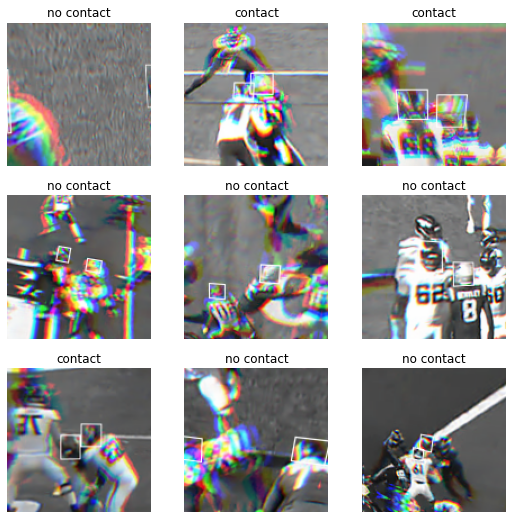

In [11]:
dls = get_3d_dls(frames_df, img_size=128, batch_tfms=[*aug_transforms()])
dls.show_batch()

In [14]:
learn = get_learner('convnext_tiny', dls, n_in=3, metrics=[MatthewsCorrCoef()])

In [15]:
learn.fine_tune(1)

epoch,train_loss,valid_loss,matthews_corrcoef,time
0,0.892008,0.726931,0.206109,01:42


epoch,train_loss,valid_loss,matthews_corrcoef,time
0,0.651381,0.645289,0.262480,01:30


### 6 channels

In [19]:
def get_img(row, img_size=128, add_helmets=True):
    frames = []
    for path in row.path:
        if not os.path.isfile(path):
            continue
            
        frame = read_img(path)
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        if add_helmets:
            frame = cv2.rectangle(frame, 
                                  (int(row.left_1), int(row.top_1)),
                                  (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                                  (255, 0, 0), 1)

            frame = cv2.rectangle(frame, 
                                  (int(row.left_2), int(row.top_2)),
                                  (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                                  (255, 0, 0), 1)

        size = img_size // 2

        if row.center_y-size < 0:
            min_y = 0
            max_y = min_y + 2*size

        elif row.center_y+size > 719:
            min_y = 719 - 2*size
            max_y = 719

        else:
            min_y = row.center_y - size
            max_y = row.center_y + size

        if row.center_x-size < 0:
            min_x = 0
            max_x = min_x + 2*size

        elif row.center_x+size > 1279:
            min_x = 1279 - 2*size
            max_x = 1279

        else:
            min_x = row.center_x - size
            max_x = row.center_x + size
            
        if len(frame.shape) > 2:
            frame = frame[int(min_y):int(max_y), 
                                  int(min_x):int(max_x), :]
        else:
            frame = frame[int(min_y):int(max_y), 
                                  int(min_x):int(max_x)]
        
        frames.append(frame)
    
    if len(frames) < len(row.path):
        if os.path.isfile(row.path[0]):
            frames = frames + [frames[-1]]*(len(row.path) - len(frames))
        else:
            frames = [frames[0]]*(len(row.path) - len(frames)) + frames
        
    # return (np.stack(frames, axis=-1) / 255).astype(np.float32)
    return np.stack(frames, axis=0).astype(np.float32) / 255


def get_nd_dls(frames_df, img_size=224, bs=32, sample=False, n=5):
    tfms = [[partial(get_img, img_size=img_size)],
    [get_label, Categorize(vocab=['contact', 'no contact'])]]

    means = [0.485, 0.456, 0.406] * 10
    stds = [0.229, 0.224, 0.225] * 10
    
    means = means[:n]
    stds = stds[:n]

    after_item = [ToTensor()]
    after_batch = [*aug_transforms(), Normalize.from_stats(means, stds)]

    splits = ColSplitter()(frames_df)
    dsets = Datasets(frames_df, tfms, splits=splits)

    return dsets.dataloaders(bs=bs, after_item=after_item, after_batch=after_batch, shuffle=True)

In [16]:
frames_df = get_frames_df(df_combo_with_helmets.query('view != "Endzone2"'),
                          kf_dict,
                          split=0,
                          window=6,
                          window_step=1,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=0.1, 
                          sample_val=0.07)

frames_df.shape

(16660, 32)

In [20]:
dls = get_nd_dls(frames_df, img_size=128, bs=64, n=6)

In [21]:
learn = get_learner('convnext_tiny', dls, n_in=6, metrics=[MatthewsCorrCoef()])

In [22]:
learn.fine_tune(1)

epoch,train_loss,valid_loss,matthews_corrcoef,time
0,0.911318,0.648172,0.225709,03:54


epoch,train_loss,valid_loss,matthews_corrcoef,time
0,0.645458,0.618211,0.290133,03:43


### 30 frames

In [14]:
train_game_plays = pickle.load(open('sample-train-games.pkl', 'rb'))
val_game_plays = kf_dict[0]['val_games']
gps = train_game_plays + val_game_plays

In [21]:
frames_df = get_frames_df(df_combo_with_helmets.query('view != "Endzone2" and game_play in @gps'),
                          kf_dict,
                          split=0,
                          window=30,
                          window_step=1,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=0.01, 
                          sample_val=0.07)

frames_df.shape

(3942, 32)

In [22]:
dls = get_nd_dls(frames_df, img_size=128, bs=16, n=6)

In [23]:
learn = get_learner('convnext_tiny', dls, n_in=30, metrics=[MatthewsCorrCoef()])

Downloading: "https://dl.fbaipublicfiles.com/convnext/convnext_tiny_1k_224_ema.pth" to /root/.cache/torch/hub/checkpoints/convnext_tiny_1k_224_ema.pth


In [24]:
learn.fit_one_cycle(1)

epoch,train_loss,valid_loss,matthews_corrcoef,time


KeyboardInterrupt: 

### 6 frames for longer epochs

In [29]:
frames_df = get_frames_df(df_combo_with_helmets.query('view != "Endzone2"'),
                          kf_dict,
                          split=0,
                          window=6,
                          window_step=1,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=0.1, 
                          sample_val=0.07)

frames_df.shape

(16660, 32)

In [30]:
dls = get_nd_dls(frames_df, img_size=128, bs=64, n=6)

In [31]:
learn = get_learner('convnext_tiny', dls, n_in=6, metrics=[MatthewsCorrCoef()])

SuggestedLRs(valley=0.00015848931798245758)

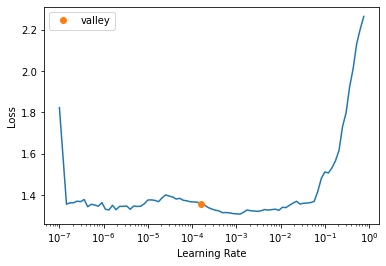

In [32]:
learn.lr_find()

In [ ]:
learn.fine_tune(10)

epoch,train_loss,valid_loss,matthews_corrcoef,time
0,0.876544,0.716142,0.202913,03:32


epoch,train_loss,valid_loss,matthews_corrcoef,time
0,0.643473,0.634903,0.294275,03:40
1,0.613905,0.610592,0.296658,03:47
2,0.581440,0.607727,0.330333,03:57
3,0.534533,0.594254,0.331241,03:49
4,0.466481,0.630332,0.329727,04:56
5,0.406066,0.666570,0.327528,03:33
6,0.319812,0.757885,0.312642,03:52
7,0.277765,0.804219,0.316130,03:41


## Convert frames to numpy arrays

In [25]:
from nflutils.frame_tpfd import *

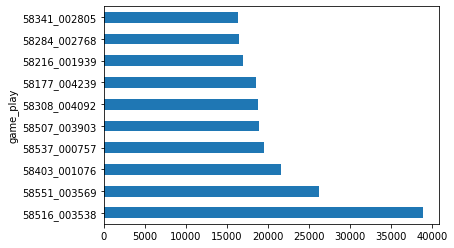

In [52]:
df_combo_with_helmets.groupby('game_play').size().sort_values(ascending=False)[:10].plot(kind='barh');

In [65]:
train_game_plays = kf_dict[0]['train_games']
len(train_game_plays)

192

In [79]:
gps = (df_combo_with_helmets
        .query('game_play in @train_game_plays').game_play.value_counts(normalize=True).sort_values(ascending=False).cumsum()[:20].index)

In [ ]:
with open('sample-train-games.pkl', 'wb') as f:
    pickle.dump(f, list(gps))

In [73]:
# glob game_plays frames
gp = '58245_002594'
frames_paths = sorted(glob.glob(CFG.frames_path+'/'+gp+'*.jpg'))

In [81]:
for gp in gps:
    frames_paths = sorted(glob.glob(CFG.frames_path+'/'+gp+'*.jpg'))
    # loop over frames and convert 
    for frame_path in tqdm(frames_paths):
        frame = cv2.imread(frames_paths[0])
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        new_frame_path = frame_path[:-4]+'.npy'
        # cv2.imwrite(new_frame_path, frame)
        np.save(open(new_frame_path, 'wb'), frame)
        # os.remove(frame_path)

  0%|          | 0/1618 [00:00<?, ?it/s]

  0%|          | 0/1542 [00:00<?, ?it/s]

  0%|          | 0/1336 [00:00<?, ?it/s]

  0%|          | 0/2658 [00:00<?, ?it/s]

  0%|          | 0/1688 [00:00<?, ?it/s]

  0%|          | 0/1506 [00:00<?, ?it/s]

  0%|          | 0/1460 [00:00<?, ?it/s]

  0%|          | 0/1362 [00:00<?, ?it/s]

  0%|          | 0/1428 [00:00<?, ?it/s]

  0%|          | 0/1426 [00:00<?, ?it/s]

  0%|          | 0/1538 [00:00<?, ?it/s]

  0%|          | 0/1470 [00:00<?, ?it/s]

  0%|          | 0/1416 [00:00<?, ?it/s]

  0%|          | 0/1328 [00:00<?, ?it/s]

  0%|          | 0/1348 [00:00<?, ?it/s]

  0%|          | 0/1534 [00:00<?, ?it/s]

  0%|          | 0/1340 [00:00<?, ?it/s]

  0%|          | 0/1360 [00:00<?, ?it/s]

  0%|          | 0/1304 [00:00<?, ?it/s]

  0%|          | 0/1626 [00:00<?, ?it/s]

In [ ]:
from itertools import chain 


len(set(chain.from_iterable(frames_df.path.to_list())))

## Test loading and saving frame in gray scale

In [39]:
frames_paths = glob.glob(CFG.frames_path+'/*')

In [43]:
frame = cv2.imread(frames_paths[0])

In [44]:
cv2.imwrite('test.jpg', frame)

True

In [44]:
frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

In [45]:
frame.shape

(720, 1280)

In [39]:
cv2.imwrite('test-gray.jpg', frame)

True

In [40]:
%timeit frame = cv2.imread('test-gray.jpg')

6.45 ms ± 167 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [41]:
np.save(open('test-gray.npy', 'wb'), frame)

In [45]:
%timeit frame = np.load('test-gray.npy')

323 µs ± 6.04 µs per loop (mean ± std. dev. of 7 runs, 1,000 loops each)


Gray scale numpy arrays are 1000 times more faster but 3 times larger. This means that I can sample part of the data for training, and use that data

In [47]:
import gzip

In [49]:
f = gzip.GzipFile("test-gray.npy.gz", "w")
np.save(file=f, arr=frame)
f.close()

In [51]:
%timeit frame = np.load(gzip.open('test-gray.npy.gz'))

7.27 ms ± 159 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


Zipping is not an option then.

In [8]:
from nflutils.frame_tpfd import *

In [92]:
def get_frame_path(row, frames_path, window, window_step):
    frames = range(row['frame']-(window*window_step), row['frame'] + (window*window_step*2), window_step)
    paths = []
    for frame in frames:
        frame = frame if len(str(frame)) > 3 else f'0{frame}'
        game_play = row['game_play']
        view = row['view']
        paths.append(f'{frames_path}/{game_play}_{view}.mp4_{frame}.jpg')
    return paths

In [93]:
def get_frames_df(df_combo, kf_dict, split, frames_path, window=3, window_step=2, sample_every_n_frame=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, seed=42):
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % @sample_every_n_frame == 0')
        val_combo = val_combo.query('(290 - frame) % @sample_every_n_frame == 0')
    
    if sample_train is not None:
        train_combo = train_combo.sample(frac=sample_train, random_state=seed)
        
    if sample_val is not None:
        val_combo = val_combo.sample(frac=sample_val, random_state=seed)
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])
    
    frames_df = pd.concat([train_combo, val_combo], axis=0)
    frames_df.frame = frames_df.frame.astype('int') 
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
        
    frames_df['path'] = frames_df.apply(lambda x: get_frame_path(x, frames_path, window, window_step), axis=1)
    
    return frames_df

In [21]:
frames_df = get_frames_df(df_combo_with_helmets,
              kf_dict, 0, 
              CFG.frames_path,
              window=30,
            window_step=2,
              sample_every_n_frame=6,
              sample_train=None,
              sample_val=0.07, 
              undersample_no_contact=True)

In [22]:
from itertools import chain 


len(set(chain.from_iterable(frames_df.path.to_list())))

100455

In [24]:
100455*300 / 1000000

30.1365

In [23]:
100455*900 / 1000000

90.4095

This is an extra 30 GB. It could prove to be worth it, and it could pro

## Utility validation functions

What are the validation functions that I need?

Say that I have made the validation predictions, and now I have a dataframe that contains ground truth and predictions.

1. Optimizing the sliding window smoothing
1. Finding the game plays having best or worst validation
2. Finding pairs that have best or worst validation
3. Plotting a pair ground truth and prediction (Contact plot)
4. Plotting top n pairs (best or worst)
5. Check video of specific pairs
6. Check video of specific gameplays

I'll read data from the next tab and use it in here to avoid crowding what I'll write with boilerplate

### Optimizing the sliding window smoothing

In [21]:
def smooth_predictions(val_df, w, center):
    val_df_new = pd.DataFrame()
    for group, group_df in tqdm(val_df.groupby(['game_play', 'nfl_player_id_1', 'nfl_player_id_2', 'view'])):
        group_df['contact_pred_rolling'] = group_df.contact_pred.rolling(w, center=center).mean().bfill().ffill().fillna(0)
        # group_df['contact_pred_rolling'] = np.where(group_df.contact_pred_rolling.isna(), group_df.contact_pred, group_df.contact_pred_rolling)
        val_df_new = pd.concat([val_df_new, group_df])
    return val_df_new


def get_matthews_corrcoef(val_dist_agg, pred_col='contact_pred_rolling'):
    out = np.where(val_dist_agg['contact_pred'].isna(),
                   val_dist_agg['distance'] <= 1, 
                   val_dist_agg[pred_col] > 0.5).astype(int)
    
    return matthews_corrcoef(val_dist_agg['contact'], out)


def merge_combo_val(df_combo, val_df, pred_col='contact_pred_rolling'):
    val_dist = df_combo[df_combo.game_play.isin(val_df.game_play.unique())].copy()

    val_dist["distance"] = val_dist["distance"].fillna(99)  # Fill player to ground with 9    
    val_dist_agg = val_dist.merge(val_df.groupby('contact_id', as_index=False)[pred_col].mean(), how='left', on='contact_id')
    
    if pred_col != 'contact_pred':
        val_dist_agg = val_dist_agg.merge(val_df.groupby('contact_id', as_index=False)['contact_pred'].mean(), how='left', on='contact_id')
    
    return val_dist_agg


def find_best_window(df_combo, val_df, w_min, w_max):
    
    # Calculate multiple rolling windows
    val_df_new = pd.DataFrame()
    for group, group_df in tqdm(val_df.groupby(['game_play', 'nfl_player_id_1', 'nfl_player_id_2', 'view'])):
        for i in range(w_min, w_max):
            for center in [True, False]:
                group_df[f'contact_pred_rolling_{i}_{center}'] = group_df.contact_pred.rolling(i, center=center).mean()
                val_df_new = pd.concat([val_df_new, group_df])
                
    results = {}
    best_score = 0
    best_config = ''
    
    # Evaluate on the calculated windows
    for i in range(w_min, w_max):
        for center in [True, False]:
            
            val_dist_agg = merge_combo_val(df_combo, val_df_new, f'contact_pred_rolling_{i}_{center}')

            results['Baseline'] = get_matthews_corrcoef(val_dist_agg, 'contact_pred')
            results[f'{i}_{center}'] = get_matthews_corrcoef(val_dist_agg, f'contact_pred_rolling_{i}_{center}')
            
            if results[f'{i}_{center}'] > best_score:
                best_config = f'Window: {i}, Center: {center}'
                best_score = results[f'{i}_{center}']
    
    print('Baseline:', results['Baseline'])
    print('Best config ->', best_config) 
    print('Best conifg score:', best_score)
            
    return results

In [22]:
_ = find_best_window(df_combo, val_df, 5, 6)

  0%|          | 0/3327 [00:00<?, ?it/s]

Baseline: 0.5983397719886848
Best config -> Window: 5, Center: True
Best conifg score: 0.6131993510672703


### Finding gameplays with best/worst validation scores

In [23]:
def rank_game_plays(val_dist_agg, ascending=False):
    game_plays_scores = val_dist_agg.groupby('game_play').apply(get_matthews_corrcoef).sort_values(ascending=ascending).reset_index()
    game_plays_scores.columns = ['game_play', 'score']
    
    return game_plays_scores

In [24]:
val_df = smooth_predictions(val_df, 4, True)
val_dist_agg = merge_combo_val(df_combo, val_df)
game_plays_scores = rank_game_plays(val_dist_agg)

  0%|          | 0/3327 [00:00<?, ?it/s]

### Finding pairs with best/worst validation scores

In [25]:
def rank_pairs(val_dist_agg, ascending=False):
    cols = ['game_play', 'nfl_player_id_1', 'nfl_player_id_2']
    pairs_contact = val_dist_agg.groupby(cols).agg({'contact': 'sum'}).reset_index()
    pairs_scores = val_dist_agg.groupby(cols).apply(get_matthews_corrcoef).sort_values(ascending=ascending).reset_index()
    pairs_scores.columns = cols + ['score']
    
    return pd.merge(pairs_scores, pairs_contact, on=cols, how='left')

In [26]:
pairs_scores = rank_pairs(val_dist_agg)

### Plotting pairs ground truth and predictions

In [27]:
def plot_pair(pair_row, val_dist_agg, ax=None):
    pair_dict = pair_row.to_dict()
    game_play = pair_dict['game_play']
    player_1 = pair_dict['nfl_player_id_1']
    player_2 = pair_dict['nfl_player_id_2']
    score = pair_dict['score']
    contact = pair_dict['contact']
    
    (val_dist_agg.query('game_play == @game_play and nfl_player_id_1 == @player_1 and nfl_player_id_2 == @player_2')
            .groupby('step')
            .contact.first()
            .plot(label='truth', color='r', ax=ax))
    
    (val_dist_agg.query('game_play == @game_play and nfl_player_id_1 == @player_1 and nfl_player_id_2 == @player_2')
            .groupby('step')
            .contact_pred_rolling.apply(lambda x: int(np.mean(x) > 0.5))
            .plot(linestyle='--', linewidth= 1.5, color='b', label='pred', ax=ax))
    
    if ax is None:
        plt.legend()
        plt.title(f'{game_play} - {player_1} - {player_2} - {round(score, 2)} - {contact}')
        
    else:
        ax.legend()
        ax.set_title(f'{game_play} - {player_1} - {player_2} - {round(score, 2)} - {contact}')

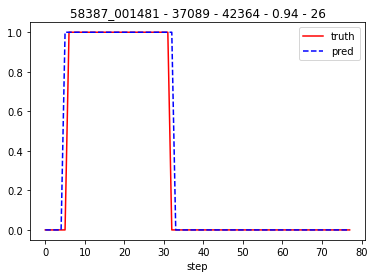

In [28]:
plot_pair(pairs_scores.iloc[30], val_dist_agg)

### Plot top n pairs

In [29]:
def plot_top_pairs(pairs_scores, n, ascending=True):
    pairs_scores = pairs_scores.sort_values('score', ascending=ascending)
    
    fig, axes = plt.subplots((n//3)+((n%3)!=0), 3, figsize=(15, (n//3)*6))
    axes = axes.flatten()
    
    for i, row in pairs_scores.iloc[:n].reset_index().iterrows():
        plot_pair(row, val_dist_agg, axes[i])

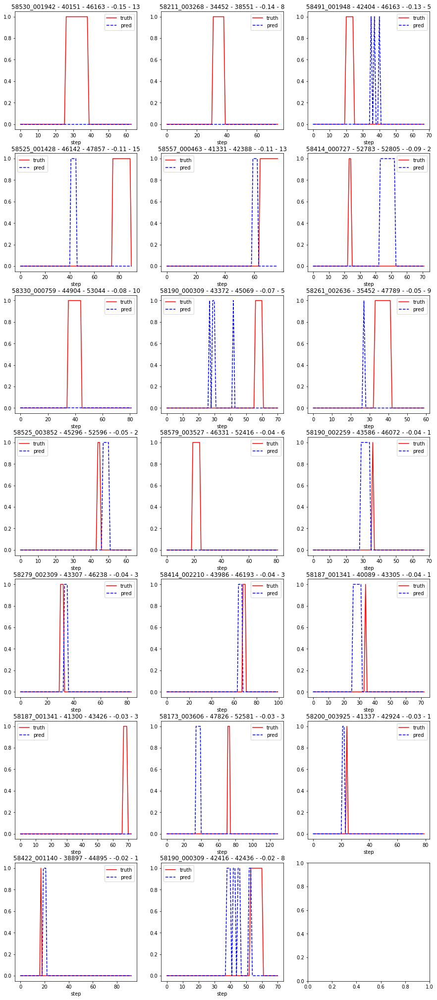

In [30]:
plot_top_pairs(pairs_scores, 20, ascending=True)

### Check video of specific pairs

To create this I need to:
1. Loop over frames
2. Create new frame (left for truth and right for prediction)
3. For every frame get bounding boxes of the players and draw them on both frames
4. For every frame label the contact between player pairs if contact exists 

In [31]:
# Read helmets df
tr_helmets = pd.read_csv(BASE_DIR/'train_baseline_helmets.csv')
tr_helmets.head()

,game_play,game_key,play_id,view,video,frame,nfl_player_id,player_label,left,width,top,height
0,58168_003392,58168,3392,Endzone,58168_003392_Endzone.mp4,290,39947,H72,946,25,293,34
1,58168_003392,58168,3392,Endzone,58168_003392_Endzone.mp4,290,37211,H42,151,25,267,33
2,58168_003392,58168,3392,Endzone,58168_003392_Endzone.mp4,290,38590,H70,810,25,293,35
3,58168_003392,58168,3392,Endzone,58168_003392_Endzone.mp4,290,44822,H15,681,26,254,33
4,58168_003392,58168,3392,Endzone,58168_003392_Endzone.mp4,290,41944,V92,680,23,303,33


In [32]:
# Select a gameplay
gp = game_plays_scores.iloc[0, 0]
view = 'Sideline'

gp_helmets = tr_helmets.query('game_play == @gp and view == @view')
gp_val_df = val_df.query('game_play == @gp and view == @view')

In [33]:
# Glob frames
frames_paths = sorted(glob.glob(CFG.frames_path+f'/{gp}_{view}*'))

In [34]:
read_img.cache_clear()

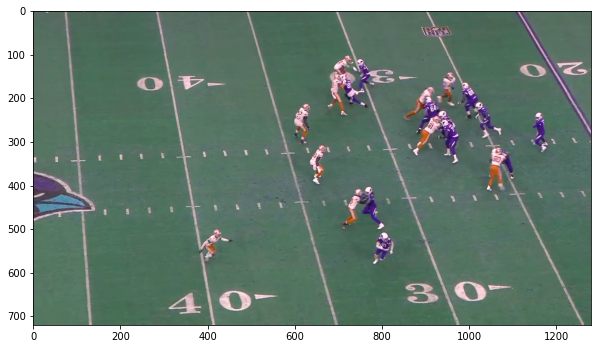

In [35]:
# Select random frame
i = 379
frame_path = frames_paths[i]
frame = read_img(frame_path)
plt.figure(figsize=(10, 10))
plt.imshow(frame);

In [36]:
def plot_helmet_on_frame(frame, left, width, top, height, color=(0,0,0), thickness=1):
    startpoint = (int(left), int(top))
    endpoint = (int(left + width), int(top + height))
    return cv2.rectangle(frame, startpoint, endpoint, color, thickness)

def plot_player_name_on_frame(frame, name, left, top, color=(0,0,0), thickness=1):
    return cv2.putText(frame, name,
                       (int(left + 1), max(0, int(top - 20))),
                       cv2.FONT_HERSHEY_SIMPLEX, 0.5,
                       color,
                       thickness=thickness)

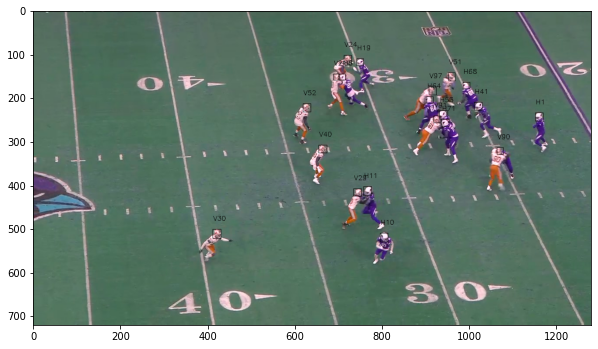

In [37]:
frame_helmets = gp_helmets.query('frame == @i+1')
frame_val_df = gp_val_df.query('frame == @i+1')

for helmet in frame_helmets.itertuples():
    plot_helmet_on_frame(frame, helmet.left, helmet.width, helmet.top, helmet.height)
    plot_player_name_on_frame(frame, helmet.player_label, helmet.left, helmet.top)

plt.figure(figsize=(10, 10))
plt.imshow(frame);

In [38]:
def plot_contact_line(frame, contact_tuple, color=(255,0,0), thickness=2):
    return cv2.line(frame, 
                 (int(contact_tuple.left_1) + int(contact_tuple.width_1 / 2), int(contact_tuple.top_1) + int(contact_tuple.height_1 / 2)),
                 (int(contact_tuple.left_2) + int(contact_tuple.width_2 / 2), int(contact_tuple.top_2) + int(contact_tuple.height_2 / 2)),
                 color=(255, 0, 0),
                 thickness=thickness)

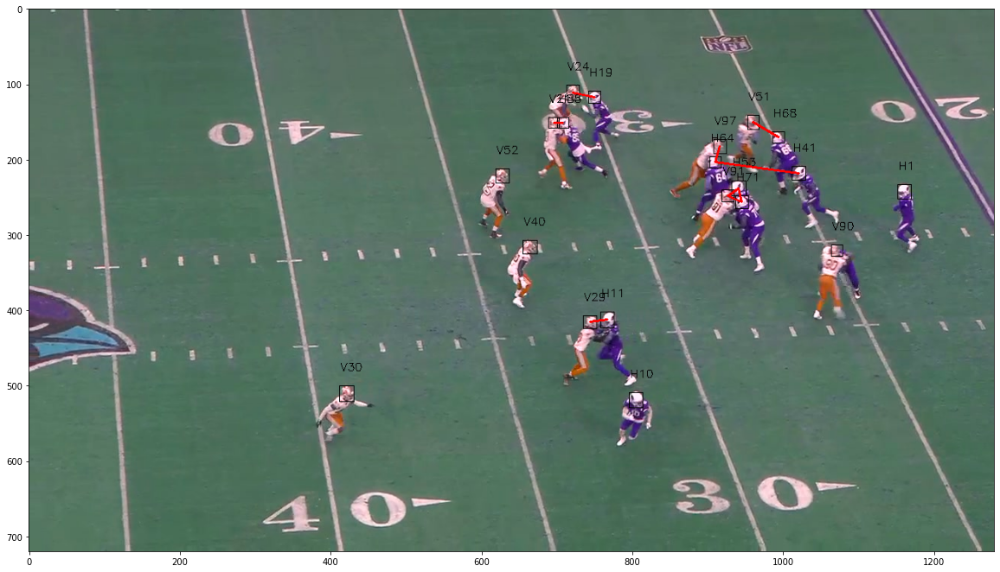

In [39]:
for contact_tuple in frame_val_df.itertuples():
    frame = plot_contact_line(frame, contact_tuple)
    
plt.figure(figsize=(20, 20))
plt.imshow(frame);

In [40]:
frame_val_df.sort_values(['game_play', 'frame']).contact_pred

305084    0.995694
305062    0.478925
305050    0.021740
305074    0.132571
305038    0.465327
305026    0.817611
305002    0.942188
304994    0.800711
305014    0.839537
Name: contact_pred, dtype: float32

In [41]:
frame_val_df.columns

Index(['contact_id', 'game_play', 'datetime', 'step', 'nfl_player_id_1',
       'nfl_player_id_2', 'contact', 'x_position_1', 'y_position_1',
       'x_position_2', 'y_position_2', 'distance', 'view', 'frame',
       'player_label_1', 'left_1', 'width_1', 'top_1', 'height_1',
       'player_label_2', 'left_2', 'width_2', 'top_2', 'height_2', 'top',
       'left', 'bottom', 'right', 'center_y', 'center_x', 'is_valid', 'path',
       'contact_pred', 'contact_pred_rolling'],
      dtype='object')

In [42]:
read_img.cache_clear()

In [47]:
np.concatenate([frame, frame], axis=1).shape

(720, 2560, 3)

In [52]:
import os
import cv2
import subprocess
from IPython.display import Video, display

def video_with_pair_contact(pair_df, tr_helmets, gp, frames_path, view='Sideline', verbose=True):
    # Create output video
    VIDEO_CODEC = "MP4V"
    
    fps = 59.94
    width = 1280*2
    height = 720
    
    output_path = f"contact_{gp}_{view}.mp4"
    tmp_output_path = "tmp_" + output_path.split('.')[0] + ".mp4"
    output_video = cv2.VideoWriter(
        tmp_output_path, cv2.VideoWriter_fourcc(*VIDEO_CODEC), fps, (width, height)
    )
    
    # Filter gameplay pairs
    gp_pair_df = pair_df.query('game_play == @gp and view == @view')
    gp_helmets_df = tr_helmets.query('game_play == @gp and view == @view')
    
    # Glob gameplay frames
    frames_paths = sorted(glob.glob(frames_path+f'/{gp}_{view}*'))
    
    # Loop over frames
    for fp in tqdm(frames_paths):
        
        # Read frame
        frame = read_img(fp)
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        
        # Make copy for predictions
        frame_pred = frame.copy()
        
        # Get frame number
        frame_no = int(fp[-8:-4])
        
        # Filter frame pairs and helmets
        frame_pair_df = gp_pair_df.query('frame == @frame_no and contact == 1')
        frame_pair_preds_df = gp_pair_df.query('frame == @frame_no and contact_pred_rolling > 0.5')
        frame_helmets_df = gp_helmets_df.query('frame == @frame_no')
        
        # Create set for plotted helmets
        players_set = set()
        
        # Plot helmets if exists
        if len(frame_helmets_df) > 0:
            
            # Loop over helmets
            for helmet_tuple in frame_helmets_df.itertuples():

                # Plot helmet if wasn't plotted before
                if helmet_tuple.player_label not in players_set:

                    frame = plot_helmet_on_frame(frame, helmet_tuple.left, helmet_tuple.width, helmet_tuple.top, helmet_tuple.height, color=(0, 0, 0))
                    frame = plot_player_name_on_frame(frame, helmet_tuple.player_label, helmet_tuple.left, helmet_tuple.top, color=(0, 0, 0))
                    
                    frame_pred = plot_helmet_on_frame(frame_pred, helmet_tuple.left, helmet_tuple.width, helmet_tuple.top, helmet_tuple.height, color=(0, 0, 0))
                    frame_pred = plot_player_name_on_frame(frame_pred, helmet_tuple.player_label, helmet_tuple.left, helmet_tuple.top, color=(0, 0, 0))
        
        # Plot pairs if exits
        if len(frame_pair_df) > 0:
        
            # Loop over pairs
            for contact_tuple in frame_pair_df.itertuples():
                
                # Plot first player helmet and name
                frame = plot_helmet_on_frame(frame, contact_tuple.left_1, contact_tuple.width_1, contact_tuple.top_1, contact_tuple.height_1, color=(0, 255, 0))
                frame = plot_player_name_on_frame(frame, contact_tuple.player_label_1, contact_tuple.left_1, contact_tuple.top_1, color=(0, 255, 0))

                # Plot second player helmet and name
                frame = plot_helmet_on_frame(frame, contact_tuple.left_2, contact_tuple.width_2, contact_tuple.top_2, contact_tuple.height_2, color=(0, 255, 0))
                frame = plot_player_name_on_frame(frame, contact_tuple.player_label_2, contact_tuple.left_2, contact_tuple.top_2, color=(0, 255, 0))

                # Plot line between players
                frame = plot_contact_line(frame, contact_tuple)

                # Add both players to plotted set
                players_set.add(contact_tuple.player_label_1)
                players_set.add(contact_tuple.player_label_2)
                
        # Plot pred pairs if exits
        if len(frame_pair_preds_df) > 0:
        
            # Loop over pairs
            for contact_tuple in frame_pair_preds_df.itertuples():
                
                # Plot first player helmet and name
                frame_pred = plot_helmet_on_frame(frame_pred, contact_tuple.left_1, contact_tuple.width_1, contact_tuple.top_1, contact_tuple.height_1, color=(0, 255, 0))
                frame_pred = plot_player_name_on_frame(frame_pred, contact_tuple.player_label_1, contact_tuple.left_1, contact_tuple.top_1, color=(0, 255, 0))

                # Plot second player helmet and name
                frame_pred = plot_helmet_on_frame(frame_pred, contact_tuple.left_2, contact_tuple.width_2, contact_tuple.top_2, contact_tuple.height_2, color=(0, 255, 0))
                frame_pred = plot_player_name_on_frame(frame_pred, contact_tuple.player_label_2, contact_tuple.left_2, contact_tuple.top_2, color=(0, 255, 0))

                # Plot line between players
                frame_pred = plot_contact_line(frame_pred, contact_tuple)

                # Add both players to plotted set
                players_set.add(contact_tuple.player_label_1)
                players_set.add(contact_tuple.player_label_2)
        
        
        final_frame = np.concatenate([frame, frame_pred], axis=1)
        output_video.write(final_frame)
        
    output_video.release()
    
    # Not all browsers support the codec, we will re-load the file at tmp_output_path
    # and convert to a codec that is more broadly readable using ffmpeg
    if os.path.exists(output_path):
        os.remove(output_path)
        
    subprocess.run(
        [
            "ffmpeg",
            "-i",
            tmp_output_path,
            "-crf",
            "18",
            "-preset",
            "veryfast",
            "-hide_banner",
            "-loglevel",
            "error",
            "-vcodec",
            "libx264",
            output_path,
        ]
    )
    
    os.remove(tmp_output_path)

    return output_path

In [55]:
game_plays_scores = rank_game_plays(val_dist_agg, ascending=True)
game_plays_scores.head()

,game_play,score
0,58387_000381,-0.000095
1,58581_000040,0.000000
2,58491_001948,0.316039
3,58187_001341,0.456171
4,58414_000727,0.469250


In [56]:
gp = game_plays_scores.iloc[0, 0]

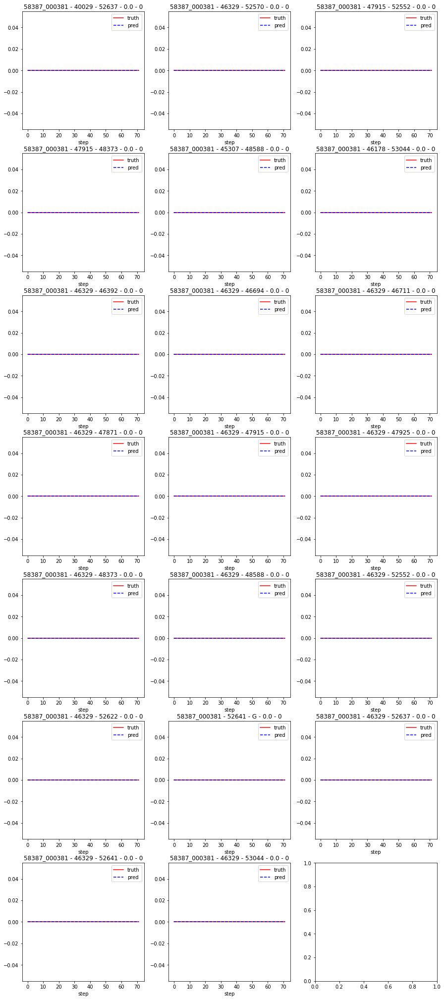

In [59]:
plot_top_pairs(pairs_scores.query('game_play == @gp'), 20, ascending=False)

In [57]:
output_video = video_with_pair_contact(val_df, tr_helmets, gp, CFG.frames_path)

OpenCV: FFMPEG: tag 0x5634504d/'MP4V' is not supported with codec id 12 and format 'mp4 / MP4 (MPEG-4 Part 14)'
OpenCV: FFMPEG: fallback to use tag 0x7634706d/'mp4v'


  0%|          | 0/724 [00:00<?, ?it/s]

In [ ]:
frac = 0.65  # scaling factor for display

display(
    Video(data=output_video, embed=True, height=int(720 * frac), width=int(1280 * frac))
)

In [163]:
import os
import cv2
import subprocess
from IPython.display import Video, display
import pandas as pd


def video_with_pair_contact(
    baseline_boxes: pd.DataFrame, 
    pair_row, 
    view='Sideline',
    verbose=True
) -> str:
    """
    Annotates a video with baseline model boxes.
    Helmet boxes are colored based on the contact label.
    """
    pair_dict = pair_row.to_dict()
    game_play = pair_dict['game_play']
    player_1 = pair_dict['nfl_player_id_1']
    player_2 = pair_dict['nfl_player_id_2']
    score = pair_dict['score']
    contact = pair_dict['contact']
    
    video_path = f'nfl-player-contact-detection/train/{game_play}_{view}.mp4'
    
    VIDEO_CODEC = "MP4V"
    HELMET_COLOR = (0, 0, 0)  # Black
    video_name = os.path.basename(video_path)
    
    if verbose:
        print(f"Running for {video_name}")
    baseline_boxes = baseline_boxes.copy()

    vidcap = cv2.VideoCapture(video_path)
    fps = vidcap.get(cv2.CAP_PROP_FPS)
    width = int(vidcap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(vidcap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    output_path = "contact_" + video_name
    tmp_output_path = "tmp_" + output_path
    output_video = cv2.VideoWriter(
        tmp_output_path, cv2.VideoWriter_fourcc(*VIDEO_CODEC), fps, (width, height)
    )
    frame = 0
    while True:
        it_worked, img = vidcap.read()
        if not it_worked:
            break
        # We need to add 1 to the frame count to match the label frame index
        # that starts at 1
        frame += 1

        # Let's add a frame index to the video so we can track where we are
        img_name = video_name.replace('.mp4','')
        cv2.putText(
            img,
            img_name,
            (10, 30),
            cv2.FONT_HERSHEY_SIMPLEX,
            1,
            HELMET_COLOR,
            thickness=1,
        )
        
        cv2.putText(
            img,
            str(frame),
            (1280 - 90, 720 - 20),
            cv2.FONT_HERSHEY_SIMPLEX,
            1,
            HELMET_COLOR,
            thickness=1,
        )

        # Now, add the boxes
        players = [player_1, player_2]
        boxes = baseline_boxes.query("video == @video_name and frame == @frame and nfl_player_id in @players")
        contact_players = boxes.dropna(subset=["nfl_player_id_2"]).query(
            'nfl_player_id_2 != "G"'
        )
        contact_ids = (
            contact_players["nfl_player_id_1"].astype("int").values.tolist()
            + contact_players["nfl_player_id_2"].astype("int").values.tolist()
        )
        for box in boxes.itertuples(index=False):

            if box.nfl_player_id_2 == "G":
                box_color = (0, 0, 255)  # Red
                box_thickness = 2
            elif int(box.nfl_player_id) in contact_ids:
                box_color = (0, 255, 0)  # green
                box_thickness = 2

                # Add line between players in contact
                if not np.isnan(float(box.nfl_player_id_2)):
                    player2 = int(box.nfl_player_id_2)
                    player2_row = boxes.query("nfl_player_id == @player2")
                    if len(player2_row) == 0:
                        # Player 2 is not in view
                        continue
                    cv2.line(
                        img,
                        (box.left + int(box.width / 2), box.top + int(box.height / 2)),
                        (
                            player2_row.left.values[0]
                            + int(player2_row.width.values[0] / 2),
                            player2_row.top.values[0]
                            + int(player2_row.height.values[0] / 2),
                        ),
                        color=(255, 0, 0),
                        thickness=2,
                    )

            else:
                box_color = HELMET_COLOR
                box_thickness = 1

            # Draw lines between two boxes

            cv2.rectangle(
                img,
                (box.left, box.top),
                (box.left + box.width, box.top + box.height),
                box_color,
                thickness=box_thickness,
            )
            cv2.putText(
                img,
                box.player_label,
                (box.left + 1, max(0, box.top - 20)),
                cv2.FONT_HERSHEY_SIMPLEX,
                0.5,
                HELMET_COLOR,
                thickness=1,
            )

        output_video.write(img)
    output_video.release()
    # Not all browsers support the codec, we will re-load the file at tmp_output_path
    # and convert to a codec that is more broadly readable using ffmpeg
    if os.path.exists(output_path):
        os.remove(output_path)
    subprocess.run(
        [
            "ffmpeg",
            "-i",
            tmp_output_path,
            "-crf",
            "18",
            "-preset",
            "veryfast",
            "-hide_banner",
            "-loglevel",
            "error",
            "-vcodec",
            "libx264",
            output_path,
        ]
    )
    os.remove(tmp_output_path)

    return output_path

In [164]:
tr_helmets = pd.read_csv(BASE_DIR/'train_baseline_helmets.csv')
tr_helmets.head()

,game_play,game_key,play_id,view,video,frame,nfl_player_id,player_label,left,width,top,height
0,58168_003392,58168,3392,Endzone,58168_003392_Endzone.mp4,290,39947,H72,946,25,293,34
1,58168_003392,58168,3392,Endzone,58168_003392_Endzone.mp4,290,37211,H42,151,25,267,33
2,58168_003392,58168,3392,Endzone,58168_003392_Endzone.mp4,290,38590,H70,810,25,293,35
3,58168_003392,58168,3392,Endzone,58168_003392_Endzone.mp4,290,44822,H15,681,26,254,33
4,58168_003392,58168,3392,Endzone,58168_003392_Endzone.mp4,290,41944,V92,680,23,303,33


## Analyzing contact between two players 

In [8]:
labels = pd.read_csv(BASE_DIR/"train_labels.csv")
labels.head()

,contact_id,game_play,datetime,step,nfl_player_id_1,nfl_player_id_2,contact
0,58168_003392_0_38590_43854,58168_003392,2020-09-11T03:01:48.100Z,0,38590,43854,0
1,58168_003392_0_38590_41257,58168_003392,2020-09-11T03:01:48.100Z,0,38590,41257,0
2,58168_003392_0_38590_41944,58168_003392,2020-09-11T03:01:48.100Z,0,38590,41944,0
3,58168_003392_0_38590_42386,58168_003392,2020-09-11T03:01:48.100Z,0,38590,42386,0
4,58168_003392_0_38590_47944,58168_003392,2020-09-11T03:01:48.100Z,0,38590,47944,0


In [13]:
gp_labels = labels.query('game_play == "58168_003392"')
gp_labels.head()

,contact_id,game_play,datetime,step,nfl_player_id_1,nfl_player_id_2,contact
0,58168_003392_0_38590_43854,58168_003392,2020-09-11T03:01:48.100Z,0,38590,43854,0
1,58168_003392_0_38590_41257,58168_003392,2020-09-11T03:01:48.100Z,0,38590,41257,0
2,58168_003392_0_38590_41944,58168_003392,2020-09-11T03:01:48.100Z,0,38590,41944,0
3,58168_003392_0_38590_42386,58168_003392,2020-09-11T03:01:48.100Z,0,38590,42386,0
4,58168_003392_0_38590_47944,58168_003392,2020-09-11T03:01:48.100Z,0,38590,47944,0


In [14]:
gp_labels.groupby(['nfl_player_id_1', 'nfl_player_id_2']).contact.sum().sort_values(ascending=False).head(10)

nfl_player_id_1  nfl_player_id_2
38567            G                  48
42386            G                  40
52440            G                  30
37084            G                  29
43854            46445              28
37211            43854              27
43854            G                  27
39947            47944              25
41944            42565              22
37084            45695              14
Name: contact, dtype: int64

In [15]:
gp_labels.query('nfl_player_id_1 == 37084 and nfl_player_id_2 == "45695"').shape

(70, 7)

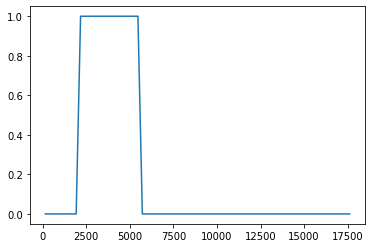

In [16]:
gp_labels.query('nfl_player_id_1 == 37084 and nfl_player_id_2 == "45695"').contact.plot();

### Is there separated contacts between pairs of players?

In [17]:
separated_contact_groups = []
contact_groups = []
for group, group_df in tqdm(labels.groupby(['game_play', 'nfl_player_id_1', 'nfl_player_id_2'])):
    contact = 0
    has_contact = False
    contact_ended = False
    for row in group_df.itertuples():
        if has_contact and contact_ended and (contact + row.contact) > contact:
            separated_contact_groups.append(group)
        
        if has_contact and (contact + row.contact) == contact:
            contact_ended = True
            
        contact += row.contact
        
        if not has_contact and contact > 0:
            has_contact = True
            contact_groups.append(group)

  0%|          | 0/60698 [00:00<?, ?it/s]

In [78]:
separated_contact_groups = list(set(separated_contact_groups))
contact_groups = list(set(contact_groups))

In [79]:
len(separated_contact_groups)

136

In [80]:
len(separated_contact_groups) / len(contact_groups)

0.033680039623576026

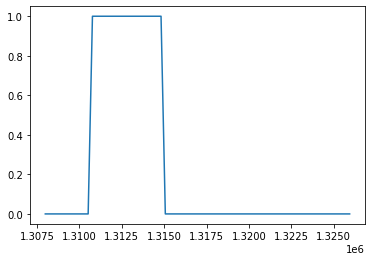

In [82]:
gp, player_1, player_2 = contact_groups[0]

labels.query('game_play == @gp and nfl_player_id_1 == @player_1 and nfl_player_id_2 == @player_2').contact.plot();

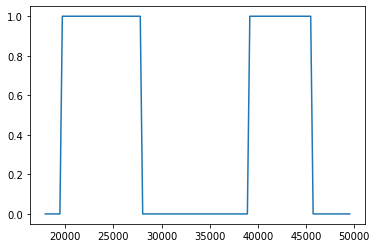

In [75]:
gp, player_1, player_2 = separated_contact_groups[25]

labels.query('game_play == @gp and nfl_player_id_1 == @player_1 and nfl_player_id_2 == @player_2').contact.plot();

### Analyze model output for contact between two players

In [9]:
def get_frame_path(row, frames_path, window):
    # frames = range(row['frame']-(window//2), row['frame']+(window//2)+1)
    frames = range(row['frame'], row['frame'] + 6, 2)
    paths = []
    for frame in frames:
        frame = frame if len(str(frame)) > 3 else f'0{frame}'
        game_play = row['game_play']
        view = row['view']
        paths.append(f'{frames_path}/{game_play}_{view}.mp4_{frame}.jpg')
    return paths

In [10]:
from functools import lru_cache

@lru_cache(maxsize=900)
def read_img(path):
    return cv2.imread(path)

def get_img(row, img_size=128, add_helmets=True):
    frames = []
    for path in row.path:
        if not os.path.isfile(path):
            continue
            
        frame = read_img(path)
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        if add_helmets:
            frame = cv2.rectangle(frame, 
                                  (int(row.left_1), int(row.top_1)),
                                  (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                                  (255, 0, 0), 1)

            frame = cv2.rectangle(frame, 
                                  (int(row.left_2), int(row.top_2)),
                                  (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                                  (255, 0, 0), 1)

        size = img_size // 2

        if row.center_y-size < 0:
            min_y = 0
            max_y = min_y + 2*size

        elif row.center_y+size > 719:
            min_y = 719 - 2*size
            max_y = 719

        else:
            min_y = row.center_y - size
            max_y = row.center_y + size

        if row.center_x-size < 0:
            min_x = 0
            max_x = min_x + 2*size

        elif row.center_x+size > 1279:
            min_x = 1279 - 2*size
            max_x = 1279

        else:
            min_x = row.center_x - size
            max_x = row.center_x + size
            
        if len(frame.shape) > 2:
            frame = frame[int(min_y):int(max_y), 
                                  int(min_x):int(max_x), :]
        else:
            frame = frame[int(min_y):int(max_y), 
                                  int(min_x):int(max_x)]
        
        frames.append(frame)
    
    if len(frames) < len(row.path):
        if os.path.isfile(row.path[0]):
            frames = frames + [frames[-1]]*(len(row.path) - len(frames))
        else:
            frames = [frames[0]]*(len(row.path) - len(frames)) + frames
        
    # return (np.stack(frames, axis=-1) / 255).astype(np.float32)
    return np.stack(frames, axis=-1)

In [11]:
def get_frames_df(df_combo, kf_dict, split, frames_path, window=3, sample_every_n_frame=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, seed=42):
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % @sample_every_n_frame == 0')
        val_combo = val_combo.query('(290 - frame) % @sample_every_n_frame == 0')
    
    if sample_train is not None:
        train_combo = train_combo.sample(frac=sample_train, random_state=seed)
        
    if sample_val is not None:
        val_combo = val_combo.sample(frac=sample_val, random_state=seed)
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])

    frames_df = pd.concat([train_combo, val_combo], axis=0)
    frames_df.frame = frames_df.frame.astype('int') 
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
        
    frames_df['path'] = frames_df.apply(lambda x: get_frame_path(x, frames_path, window), axis=1)
        
    return frames_df

In [12]:
def get_dls(frames_df, img_size=128, item_tfms=None, batch_tfms=None, bs=64, shuffle=True, drop_last=False):
    return DataBlock(
        blocks=(ImageBlock, CategoryBlock),
        get_x=partial(get_img, img_size=img_size, add_helmets=True),
        get_y=get_label,
        splitter=ColSplitter(),
        item_tfms=item_tfms,
        batch_tfms=batch_tfms
    ).dataloaders(frames_df, bs=bs, shuffle=shuffle, drop_last=drop_last)

In [13]:
def get_learner(model, dls, n_in=3, metrics=[accuracy, F1Score]):
    return vision_learner(dls, model, metrics=metrics, n_in=n_in).to_fp16()

In [14]:
frames_df = get_frames_df(df_combo_with_helmets, kf_dict, split=0, frames_path=CFG.frames_path, sample_every_n_frame=6, sample_train=0.01, sample_val=None)

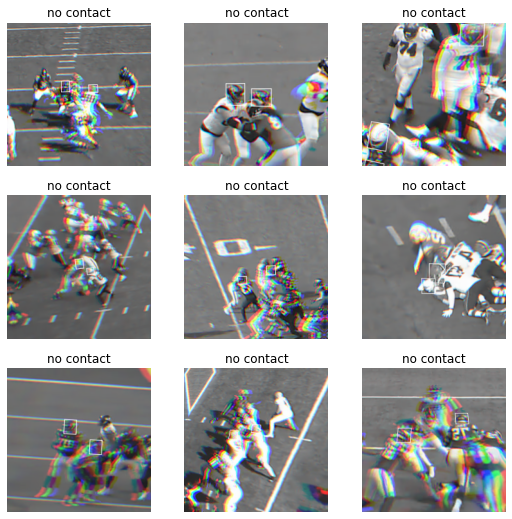

In [15]:
dls = get_dls(frames_df, img_size=224, bs=32, batch_tfms=[*aug_transforms()])
dls.rng.seed(CFG.seed)
dls.show_batch()

In [16]:
learn = get_learner('convnext_tiny', dls, metrics=[MatthewsCorrCoef()], n_in=3)

In [17]:
learn.load('model-5')

In [97]:
frames_df.query('game_play == "58168_003392"')

,contact_id,game_play,datetime,step,nfl_player_id_1,nfl_player_id_2,contact,x_position_1,y_position_1,x_position_2,...,top_2,height_2,top,left,bottom,right,center_y,center_x,is_valid,path
5802,58168_003392_51_38590_42386,58168_003392,2020-09-11 03:01:53.200000+00:00,51,38590,42386,1,44.68,14.01,44.05,...,461.0,40.0,289.0,1123.0,501.0,1257.0,395.0,1190.0,False,"[frames/content/work/frames/train/58168_003392_Endzone.mp4_0596.jpg, frames/content/work/frames/train/58168_003392_Endzone.mp4_0598.jpg, frames/content/work/frames/train/58168_003392_Endzone.mp4_0600.jpg]"
1827,58168_003392_17_39947_47944,58168_003392,2020-09-11 03:01:49.800000+00:00,17,39947,47944,1,42.34,22.37,42.31,...,344.0,13.0,344.0,469.0,365.0,487.0,354.0,478.0,False,"[frames/content/work/frames/train/58168_003392_Sideline.mp4_0392.jpg, frames/content/work/frames/train/58168_003392_Sideline.mp4_0394.jpg, frames/content/work/frames/train/58168_003392_Sideline.mp4_0396.jpg]"
6352,58168_003392_61_37084_45695,58168_003392,2020-09-11 03:01:54.200000+00:00,61,37084,45695,0,37.41,8.96,38.63,...,147.0,46.0,113.0,692.0,193.0,870.0,153.0,781.0,False,"[frames/content/work/frames/train/58168_003392_Endzone.mp4_0656.jpg, frames/content/work/frames/train/58168_003392_Endzone.mp4_0658.jpg, frames/content/work/frames/train/58168_003392_Endzone.mp4_0660.jpg]"
1263,58168_003392_13_41944_42565,58168_003392,2020-09-11 03:01:49.400000+00:00,13,41944,42565,1,41.22,20.03,40.57,...,408.0,18.0,408.0,434.0,426.0,463.0,417.0,448.0,False,"[frames/content/work/frames/train/58168_003392_Sideline.mp4_0368.jpg, frames/content/work/frames/train/58168_003392_Sideline.mp4_0370.jpg, frames/content/work/frames/train/58168_003392_Sideline.mp4_0372.jpg]"
6663,58168_003392_67_45695_46445,58168_003392,2020-09-11 03:01:54.800000+00:00,67,45695,46445,0,38.57,7.96,37.67,...,240.0,30.0,240.0,507.0,273.0,613.0,256.0,560.0,False,"[frames/content/work/frames/train/58168_003392_Sideline.mp4_0692.jpg, frames/content/work/frames/train/58168_003392_Sideline.mp4_0694.jpg, frames/content/work/frames/train/58168_003392_Sideline.mp4_0696.jpg]"
196,58168_003392_3_41944_42565,58168_003392,2020-09-11 03:01:48.400000+00:00,3,41944,42565,1,41.78,22.56,40.70,...,294.0,18.0,279.0,617.0,312.0,649.0,295.0,633.0,False,"[frames/content/work/frames/train/58168_003392_Endzone.mp4_0308.jpg, frames/content/work/frames/train/58168_003392_Endzone.mp4_0310.jpg, frames/content/work/frames/train/58168_003392_Endzone.mp4_0312.jpg]"
1250,58168_003392_13_41944_45695,58168_003392,2020-09-11 03:01:49.400000+00:00,13,41944,45695,0,41.22,20.03,40.16,...,238.0,27.0,238.0,461.0,280.0,562.0,259.0,511.0,False,"[frames/content/work/frames/train/58168_003392_Endzone.mp4_0368.jpg, frames/content/work/frames/train/58168_003392_Endzone.mp4_0370.jpg, frames/content/work/frames/train/58168_003392_Endzone.mp4_0372.jpg]"
4242,58168_003392_31_42565_45695,58168_003392,2020-09-11 03:01:51.200000+00:00,31,42565,45695,0,42.08,14.38,40.91,...,388.0,18.0,382.0,375.0,406.0,428.0,394.0,401.0,False,"[frames/content/work/frames/train/58168_003392_Sideline.mp4_0476.jpg, frames/content/work/frames/train/58168_003392_Sideline.mp4_0478.jpg, frames/content/work/frames/train/58168_003392_Sideline.mp4_0480.jpg]"


In [100]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 0 entries
Data columns (total 32 columns):
 #   Column           Non-Null Count  Dtype              
---  ------           --------------  -----              
 0   contact_id       0 non-null      object             
 1   game_play        0 non-null      object             
 2   datetime         0 non-null      datetime64[ns, UTC]
 3   step             0 non-null      int64              
 4   nfl_player_id_1  0 non-null      object             
 5   nfl_player_id_2  0 non-null      object             
 6   contact          0 non-null      int64              
 7   x_position_1     0 non-null      float64            
 8   y_position_1     0 non-null      float64            
 9   x_position_2     0 non-null      float64            
 10  y_position_2     0 non-null      float64            
 11  distance         0 non-null      float64            
 12  view             0 non-null      object             
 13  frame            0 non-null     

In [18]:
frames_df = get_frames_df(df_combo_with_helmets, kf_dict, split=0, frames_path=CFG.frames_path, sample_every_n_frame=6, sample_train=0.001, sample_val=None)

In [19]:
val_df = frames_df.query('is_valid')

In [162]:
val_df.groupby(['game_play', 'nfl_player_id_1', 'nfl_player_id_2']).contact.sum().sort_values()

game_play     nfl_player_id_1  nfl_player_id_2
58173_003606  35534            43330                0
58382_000973  41915            47814                0
              37179            47890                0
                               44969                0
              37098            41232                0
                                                 ... 
58187_001341  42503            52650               84
58540_002625  35485            43367               88
58200_003925  47790            52426               92
58306_002362  41939            43316              101
58180_000986  45142            52598              166
Name: contact, Length: 1730, dtype: int64

In [234]:
gp_df = val_df.query('game_play == "58200_003925" and nfl_player_id_1 == "47790" and nfl_player_id_2 == "52426"').copy()

In [19]:
test_dl = learn.dls.test_dl(gp_df)

NameError: name 'gp_df' is not defined

In [236]:
preds = learn.get_preds(dl=test_dl)

In [237]:
gp_df['contact_pred'] = preds[0][:, 0].cpu().numpy()

<AxesSubplot:xlabel='step'>

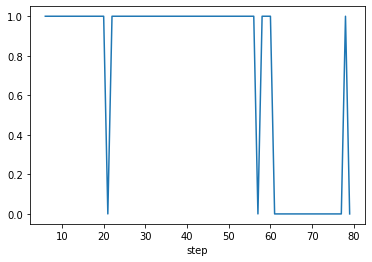

In [238]:
gp_df.groupby('step').contact_pred.apply(lambda x: int(np.mean(x) > 0.5)).plot()

<AxesSubplot:xlabel='step'>

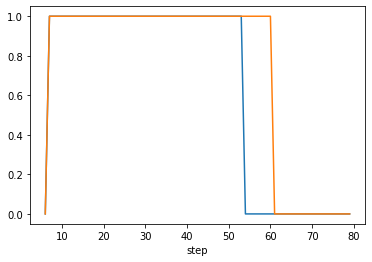

In [241]:
gp_df['contact_pred_rolling'] = gp_df.contact_pred.rolling(7, center=True).mean()
gp_df.groupby('step').contact.first().plot()
gp_df.groupby('step').contact_pred_rolling.apply(lambda x: int(np.mean(x) > 0.5)).plot()

### Check difference in validation score after post processing

In [20]:
frames_df = get_frames_df(df_combo_with_helmets, kf_dict, split=0, frames_path=CFG.frames_path, sample_every_n_frame=6, sample_train=0.01, sample_val=None)
val_df = frames_df.query('is_valid').copy()

val_dl = learn.dls.test_dl(val_df, with_labels=True)
preds, _ = learn.get_preds(dl=val_dl) 

val_df.loc[:, 'contact_pred'] = preds.cpu().detach().numpy()[:, 0]
val_df = add_contact_id(val_df)

In [77]:
val_df_new = pd.DataFrame()

for group, group_df in tqdm(val_df.groupby(['game_play', 'nfl_player_id_1', 'nfl_player_id_2', 'view'])):
    for i in range(3, 15, 2):
        for center in [True, False]:
            group_df[f'contact_pred_rolling_{i}_{center}'] = group_df.contact_pred.rolling(i, center=center).mean()
            val_df_new = pd.concat([val_df_new, group_df])

  0%|          | 0/3327 [00:00<?, ?it/s]

In [80]:
for i in range(3, 15, 2):
    for center in [True, False]:
        
        print(i, center)
        
        val_dist = df_combo[df_combo.game_play.isin(val_df.game_play.unique())].copy()

        val_dist["distance"] = val_dist["distance"].fillna(99)  # Fill player to ground with 9    
        val_dist_agg = val_dist.merge(val_df_new.groupby('contact_id', as_index=False)[f'contact_pred_rolling_{i}_{center}'].mean(), how='left', on='contact_id')
        val_dist_agg = val_dist_agg.merge(val_df_new.groupby('contact_id', as_index=False).contact_pred.mean(), how='left', on='contact_id')

        out = np.where(val_dist_agg['contact_pred'].isna(),
                   val_dist_agg['distance'] <= 1, 
                   val_dist_agg['contact_pred'] > 0.5).astype(int)

        # print('Baseline', matthews_corrcoef(val_dist_agg['contact'], (val_dist_agg['distance'] <= 1).astype(int)))
        print(matthews_corrcoef(val_dist_agg['contact'], out))
        print(confusion_matrix(val_dist_agg['contact'], out))
        print()

        out = np.where(val_dist_agg['contact_pred'].isna(),
                   val_dist_agg['distance'] <= 1, 
                   val_dist_agg[f'contact_pred_rolling_{i}_{center}'] > 0.5).astype(int)

        # print('Baseline', matthews_corrcoef(val_dist_agg['contact'], (val_dist_agg['distance'] <= 1).astype(int)))
        print(matthews_corrcoef(val_dist_agg['contact'], out))
        print(confusion_matrix(val_dist_agg['contact'], out))
        print('-'*75)
        print()

3 True
0.598282911351636
[[931035   4723]
 [  5050   7436]]

0.6121867435085239
[[931624   4134]
 [  5078   7408]]
---------------------------------------------------------------------------

3 False
0.598282911351636
[[931035   4723]
 [  5050   7436]]

0.5979592813505151
[[931454   4304]
 [  5246   7240]]
---------------------------------------------------------------------------

5 True
0.598282911351636
[[931035   4723]
 [  5050   7436]]

0.6131993510672703
[[932186   3572]
 [  5337   7149]]
---------------------------------------------------------------------------

5 False
0.598282911351636
[[931035   4723]
 [  5050   7436]]

0.5707968344078723
[[931687   4071]
 [  5815   6671]]
---------------------------------------------------------------------------

7 True
0.598282911351636
[[931035   4723]
 [  5050   7436]]

0.6044797732827009
[[932648   3110]
 [  5724   6762]]
---------------------------------------------------------------------------

7 False
0.598282911351636
[[931035   4

In [71]:
from sklearn.metrics import confusion_matrix

0.598282911351636
[[931035   4723]
 [  5050   7436]]


0.6131993510672703
[[932186   3572]
 [  5337   7149]]


## Train 2.5D for longer

### Functions

In [18]:
def get_frame_path(row, frames_path, window):
    # frames = range(row['frame']-(window//2), row['frame']+(window//2)+1)
    frames = range(row['frame'], row['frame'] + 6, 2)
    paths = []
    for frame in frames:
        frame = frame if len(str(frame)) > 3 else f'0{frame}'
        game_play = row['game_play']
        view = row['view']
        paths.append(f'{frames_path}/{game_play}_{view}.mp4_{frame}.jpg')
    return paths

In [19]:
from functools import lru_cache

@lru_cache(maxsize=1300)
def read_img(path):
    return cv2.imread(path)

def get_img(row, img_size=128, add_helmets=True):
    frames = []
    for path in row.path:
        if not os.path.isfile(path):
            continue
            
        frame = read_img(path)
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        if add_helmets:
            frame = cv2.rectangle(frame, 
                                  (int(row.left_1), int(row.top_1)),
                                  (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                                  (255, 0, 0), 1)

            frame = cv2.rectangle(frame, 
                                  (int(row.left_2), int(row.top_2)),
                                  (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                                  (255, 0, 0), 1)

        size = img_size // 2

        if row.center_y-size < 0:
            min_y = 0
            max_y = min_y + 2*size

        elif row.center_y+size > 719:
            min_y = 719 - 2*size
            max_y = 719

        else:
            min_y = row.center_y - size
            max_y = row.center_y + size

        if row.center_x-size < 0:
            min_x = 0
            max_x = min_x + 2*size

        elif row.center_x+size > 1279:
            min_x = 1279 - 2*size
            max_x = 1279

        else:
            min_x = row.center_x - size
            max_x = row.center_x + size
            
        if len(frame.shape) > 2:
            frame = frame[int(min_y):int(max_y), 
                                  int(min_x):int(max_x), :]
        else:
            frame = frame[int(min_y):int(max_y), 
                                  int(min_x):int(max_x)]
        
        frames.append(frame)
    
    if len(frames) < len(row.path):
        if os.path.isfile(row.path[0]):
            frames = frames + [frames[-1]]*(len(row.path) - len(frames))
        else:
            frames = [frames[0]]*(len(row.path) - len(frames)) + frames
        
    # return (np.stack(frames, axis=-1) / 255).astype(np.float32)
    return np.stack(frames, axis=0).astype(np.float32) / 255

In [20]:
def get_frames_df(df_combo, kf_dict, split, frames_path, window=3, sample_every_n_frame=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, seed=42):
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % @sample_every_n_frame == 0')
        val_combo = val_combo.query('(290 - frame) % @sample_every_n_frame == 0')
    
    if sample_train is not None:
        train_combo = train_combo.sample(frac=sample_train, random_state=seed)
        
    if sample_val is not None:
        val_combo = val_combo.sample(frac=sample_val, random_state=seed)
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])

    frames_df = pd.concat([train_combo, val_combo], axis=0)
    frames_df.frame = frames_df.frame.astype('int') 
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
        
    frames_df['path'] = frames_df.apply(lambda x: get_frame_path(x, frames_path, window), axis=1)
        
    return frames_df

In [21]:
def get_learner(model, dls, n_in=3, metrics=[accuracy, F1Score]):
    return vision_learner(dls, model, metrics=metrics, n_in=n_in).to_fp16()

In [22]:
def get_dls(seed, img_size=224, bs=32, sample=False, n=5):
    global kf_dict
    global df_combo_with_helmets
    
    set_seed(seed, True)
    
    if sample:
        sample_gps = np.random.choice(kf_dict[0]['train_games'], n, replace=False)
        val_gps = kf_dict[0]['val_games']
        kf_dict = pickle.load(open('kf_dict', 'rb'))
        X = df_combo_with_helmets.query('game_play in @sample_gps or game_play in @val_gps').copy()
    else:
        X = df_combo_with_helmets.copy()
        
        
    frames_df = get_frames_df(X,
                              kf_dict,
                              split=0,
                              frames_path=CFG.frames_path,
                              undersample_no_contact=True,
                              sample_every_n_frame=6,
                              sample_train=None, 
                              sample_val=0.07)

    tfms = [[partial(get_img, img_size=img_size)],
    [get_label, Categorize(vocab=['contact', 'no contact'])]]

    means = [0.485, 0.456, 0.406] 
    stds = [0.229, 0.224, 0.225] 

    after_item = [ToTensor()]
    after_batch = [*aug_transforms(), Normalize.from_stats(means, stds)]


    splits = ColSplitter()(frames_df)
    dsets = Datasets(frames_df, tfms, splits=splits)

    return dsets.dataloaders(bs=bs, after_item=after_item, after_batch=after_batch, shuffle=True)

In [23]:
class ShuffleGamePlayCallBack(Callback):
    def __init__(self, n):
        self.n = n
        
    def after_epoch(self):
        self.learn.dls = get_dls(CFG.seed+self.epoch, sample=True, n=self.n)
        
        
class SkipValidation(Callback):
    def __init__(self, every_epochs):
        self.every_epochs = every_epochs
    def before_validate(self):
        if (self.epoch+1) % self.every_epochs != 0:
            self.recorder.values.append(0)
            raise CancelValidException()

In [24]:
dls = get_dls(CFG.seed, img_size=224, bs=64, sample=False)

x, y = dls.one_batch()
x.shape

torch.Size([64, 3, 224, 224])

In [25]:
dls.rng.seed(CFG.seed)   
set_seed(CFG.seed)
learn = get_learner('convnext_tiny', dls, metrics=[MatthewsCorrCoef()], n_in=3)

SuggestedLRs(valley=0.00019054606673307717)

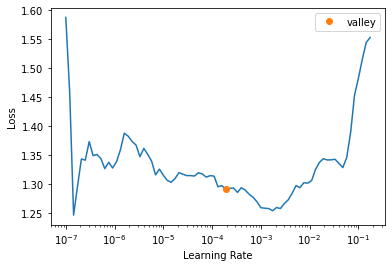

In [26]:
learn.unfreeze()
learn.lr_find()

In [ ]:
epochs = 10

learn.fit_one_cycle(epochs, 1e-3, cbs=[
                                   # GradientAccumulation(32),
                                   SaveModelCallback('matthews_corrcoef', fname='model-8', every_epoch=True, with_opt=True)
                                  ])

epoch,train_loss,valid_loss,matthews_corrcoef,time
0,0.521782,0.483665,0.496130,21:36
1,0.457603,0.450043,0.512292,21:58
2,0.434731,0.491715,0.513333,21:29


## Improve 2.5D training speed

### Functions

In [8]:
def get_frame_path(row, frames_path, window):
    # frames = range(row['frame']-(window//2), row['frame']+(window//2)+1)
    frames = range(row['frame'] - 6, row['frame'] + 12, 2)
    paths = []
    for frame in frames:
        frame = frame if len(str(frame)) > 3 else f'0{frame}'
        game_play = row['game_play']
        view = row['view']
        paths.append(f'{frames_path}/{game_play}_{view}.mp4_{frame}.jpg')
    return paths

In [9]:
from functools import lru_cache

@lru_cache(maxsize=1000)
def read_img(path):
    return cv2.imread(path)

def get_img(row, img_size=128, add_helmets=True):
    frames = []
    for path in row.path:
        if not os.path.isfile(path):
            continue
            
        frame = read_img(path)
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        if add_helmets:
            frame = cv2.rectangle(frame, 
                                  (int(row.left_1), int(row.top_1)),
                                  (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                                  (255, 0, 0), 1)

            frame = cv2.rectangle(frame, 
                                  (int(row.left_2), int(row.top_2)),
                                  (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                                  (255, 0, 0), 1)

        size = img_size // 2

        if row.center_y-size < 0:
            min_y = 0
            max_y = min_y + 2*size

        elif row.center_y+size > 719:
            min_y = 719 - 2*size
            max_y = 719

        else:
            min_y = row.center_y - size
            max_y = row.center_y + size

        if row.center_x-size < 0:
            min_x = 0
            max_x = min_x + 2*size

        elif row.center_x+size > 1279:
            min_x = 1279 - 2*size
            max_x = 1279

        else:
            min_x = row.center_x - size
            max_x = row.center_x + size
            
        if len(frame.shape) > 2:
            frame = frame[int(min_y):int(max_y), 
                                  int(min_x):int(max_x), :]
        else:
            frame = frame[int(min_y):int(max_y), 
                                  int(min_x):int(max_x)]
        
        frames.append(frame)
    
    if len(frames) < len(row.path):
        if os.path.isfile(row.path[0]):
            frames = frames + [frames[-1]]*(len(row.path) - len(frames))
        else:
            frames = [frames[0]]*(len(row.path) - len(frames)) + frames
        
    # return (np.stack(frames, axis=-1) / 255).astype(np.float32)
    return np.stack(frames, axis=0).astype(np.float32) / 255

In [10]:
def get_frames_df(df_combo, kf_dict, split, frames_path, window=3, sample_every_n_frame=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, seed=42):
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % @sample_every_n_frame == 0')
        val_combo = val_combo.query('(290 - frame) % @sample_every_n_frame == 0')
    
    if sample_train is not None:
        train_combo = train_combo.sample(frac=sample_train, random_state=seed)
        
    if sample_val is not None:
        val_combo = val_combo.sample(frac=sample_val, random_state=seed)
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])

    frames_df = pd.concat([train_combo, val_combo], axis=0)
    frames_df.frame = frames_df.frame.astype('int') 
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
        
    frames_df['path'] = frames_df.apply(lambda x: get_frame_path(x, frames_path, window), axis=1)
        
    return frames_df

In [11]:
def get_dls(frames_df, img_size=128, item_tfms=None, batch_tfms=None, bs=64, shuffle=True, drop_last=False):
    return DataBlock(
        blocks=(ImageBlock, CategoryBlock),
        get_x=partial(get_img, img_size=img_size, add_helmets=True),
        get_y=get_label,
        splitter=ColSplitter(),
        item_tfms=item_tfms,
        batch_tfms=batch_tfms
    ).dataloaders(frames_df, bs=bs, shuffle=shuffle, drop_last=drop_last)

In [12]:
def get_learner(model, dls, n_in=3, metrics=[accuracy, F1Score]):
    return vision_learner(dls, model, metrics=metrics, n_in=n_in).to_fp16()

### Experiment

The idea I have is to create a small dataloader by random sampling of game_plays which can all fit into cache, and then train with them for a bunch of epochs. 
Then randomly sample a new subet of game_plays and use these for training, etc..

Since I'm using fastai, and I can use a callback that resets the dls after a specified n number of epochs.

First I need to find the number of game_plays that will only load 1000 frames.

Since I'm going to use the total number of steps in a gameplay without subsetting any of them, I can assume that all the game_plays frames will be used.

In [23]:
(df_combo_with_helmets.groupby('game_play').frame.count()).mean()

6837.583333333333

It looks like the average number of frames in a game_play is around 7000. So if I divide this by 2, that yields 3500.

Since I'm only able to cache 1000 frames, I'd like to see the difference between training 2 epochs over 3 game_plays without caching, and then training with caching.

#### Without caching

In [24]:
def read_img(path):
    return cv2.imread(path)

In [38]:
set_seed(CFG.seed, True)
sample_gps = np.random.choice(kf_dict[0]['train_games'], 3, replace=False)
sample_gps

array(['58510_000855', '58538_002774', '58316_004343'], dtype='<U12')

In [39]:
val_gps = kf_dict[0]['val_games']

In [40]:
kf_dict = pickle.load(open('kf_dict', 'rb'))
frames_df = get_frames_df(df_combo_with_helmets.query('game_play in @sample_gps or game_play in @val_gps'),
                          kf_dict,
                          split=0,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=None, 
                          sample_val=0.07)

In [41]:
tfms = [[partial(get_img, img_size=128)],
        [get_label, Categorize(vocab=['contact', 'no contact'])]]

means = [0.485, 0.456, 0.406] * 3
stds = [0.229, 0.224, 0.225] * 3

after_item = [ToTensor()]
after_batch = [*aug_transforms(), Normalize.from_stats(means, stds)]


splits = ColSplitter()(frames_df)
dsets = Datasets(frames_df, tfms, splits=splits)

dls = dsets.dataloaders(bs=16, after_item=after_item, after_batch=after_batch, shuffle=True)

In [42]:
# dls = get_dls(frames_df, img_size=224, bs=32, batch_tfms=[*aug_transforms()])
dls.rng.seed(CFG.seed)
# dls.show_batch()

In [43]:
set_seed(CFG.seed)
learn = get_learner('convnext_tiny', dls, metrics=[MatthewsCorrCoef()], n_in=9)

Downloading: "https://dl.fbaipublicfiles.com/convnext/convnext_tiny_1k_224_ema.pth" to /root/.cache/torch/hub/checkpoints/convnext_tiny_1k_224_ema.pth


In [45]:
%%time

learn.fine_tune(2, 3e-3)

epoch,train_loss,valid_loss,matthews_corrcoef,time
0,1.074321,1.131171,0.102122,01:31


epoch,train_loss,valid_loss,matthews_corrcoef,time
0,0.632939,1.123351,0.132406,01:16
1,0.453012,0.914872,0.154088,01:15


CPU times: user 23.2 s, sys: 6.24 s, total: 29.4 s
Wall time: 4min 3s


#### With caching

In [46]:
@lru_cache(maxsize=1000)
def read_img(path):
    return cv2.imread(path)

In [47]:
set_seed(CFG.seed, True)
sample_gps = np.random.choice(kf_dict[0]['train_games'], 3, replace=False)
sample_gps

array(['58510_000855', '58538_002774', '58316_004343'], dtype='<U12')

In [48]:
val_gps = kf_dict[0]['val_games']

In [49]:
kf_dict = pickle.load(open('kf_dict', 'rb'))
frames_df = get_frames_df(df_combo_with_helmets.query('game_play in @sample_gps or game_play in @val_gps'),
                          kf_dict,
                          split=0,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=None, 
                          sample_val=0.07)

In [50]:
tfms = [[partial(get_img, img_size=128)],
        [get_label, Categorize(vocab=['contact', 'no contact'])]]

means = [0.485, 0.456, 0.406] * 3
stds = [0.229, 0.224, 0.225] * 3

after_item = [ToTensor()]
after_batch = [*aug_transforms(), Normalize.from_stats(means, stds)]


splits = ColSplitter()(frames_df)
dsets = Datasets(frames_df, tfms, splits=splits)

dls = dsets.dataloaders(bs=16, after_item=after_item, after_batch=after_batch, shuffle=True)

In [51]:
# dls = get_dls(frames_df, img_size=224, bs=32, batch_tfms=[*aug_transforms()])
dls.rng.seed(CFG.seed)
# dls.show_batch()

In [52]:
set_seed(CFG.seed)
learn = get_learner('convnext_tiny', dls, metrics=[MatthewsCorrCoef()], n_in=9)

In [53]:
%%time

learn.fine_tune(2, 3e-3)

epoch,train_loss,valid_loss,matthews_corrcoef,time
0,1.234595,1.658788,0.043023,01:21


epoch,train_loss,valid_loss,matthews_corrcoef,time
0,0.726798,0.904231,0.090079,01:09
1,0.522884,1.058672,0.134196,01:05


CPU times: user 23.2 s, sys: 6.22 s, total: 29.4 s
Wall time: 3min 37s


The only problem with this now is that it fails during validation, since it doesn't use the cache correctly due to the random sample of validation game_plays. 

The remedy for this problem would be to sample a smaller validation set, instead of random sampling from the data of all validation set. 

But right now, I'll continue testing by creating a callback that does validation only every n epochs.

In [13]:
class SkipValidation(Callback):
    def __init__(self, n):
        self.n = n
    def before_validate(self):
        if not (self.epoch > 0 and self.epoch+1 % self.n == 0):
            raise CancelValidException()

#### Without caching

In [35]:
def read_img(path):
    return cv2.imread(path)

In [36]:
set_seed(CFG.seed, True)
sample_gps = np.random.choice(kf_dict[0]['train_games'], 3, replace=False)
sample_gps

array(['58510_000855', '58538_002774', '58316_004343'], dtype='<U12')

In [37]:
val_gps = kf_dict[0]['val_games']

In [38]:
kf_dict = pickle.load(open('kf_dict', 'rb'))
frames_df = get_frames_df(df_combo_with_helmets.query('game_play in @sample_gps or game_play in @val_gps'),
                          kf_dict,
                          split=0,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=None, 
                          sample_val=0.07)

In [39]:
tfms = [[partial(get_img, img_size=128)],
        [get_label, Categorize(vocab=['contact', 'no contact'])]]

means = [0.485, 0.456, 0.406] * 3
stds = [0.229, 0.224, 0.225] * 3

after_item = [ToTensor()]
after_batch = [*aug_transforms(), Normalize.from_stats(means, stds)]


splits = ColSplitter()(frames_df)
dsets = Datasets(frames_df, tfms, splits=splits)

dls = dsets.dataloaders(bs=16, after_item=after_item, after_batch=after_batch, shuffle=True)

In [40]:
# dls = get_dls(frames_df, img_size=224, bs=32, batch_tfms=[*aug_transforms()])
dls.rng.seed(CFG.seed)
# dls.show_batch()

In [41]:
set_seed(CFG.seed)
learn = get_learner('convnext_tiny', dls, metrics=[MatthewsCorrCoef()], n_in=9)

In [42]:
%%time

learn.fine_tune(2, 3e-3, cbs=SkipValidation(2))

CPU times: user 11.1 s, sys: 2.83 s, total: 14 s
Wall time: 1min 1s


#### With caching

In [13]:
@lru_cache(maxsize=1000)
def read_img(path):
    return cv2.imread(path)

In [44]:
set_seed(CFG.seed, True)
sample_gps = np.random.choice(kf_dict[0]['train_games'], 3, replace=False)
sample_gps

array(['58510_000855', '58538_002774', '58316_004343'], dtype='<U12')

In [45]:
val_gps = kf_dict[0]['val_games']

In [46]:
kf_dict = pickle.load(open('kf_dict', 'rb'))
frames_df = get_frames_df(df_combo_with_helmets.query('game_play in @sample_gps or game_play in @val_gps'),
                          kf_dict,
                          split=0,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=None, 
                          sample_val=0.07)

In [47]:
tfms = [[partial(get_img, img_size=128)],
        [get_label, Categorize(vocab=['contact', 'no contact'])]]

means = [0.485, 0.456, 0.406] * 3
stds = [0.229, 0.224, 0.225] * 3

after_item = [ToTensor()]
after_batch = [*aug_transforms(), Normalize.from_stats(means, stds)]


splits = ColSplitter()(frames_df)
dsets = Datasets(frames_df, tfms, splits=splits)

dls = dsets.dataloaders(bs=16, after_item=after_item, after_batch=after_batch, shuffle=True)

In [48]:
# dls = get_dls(frames_df, img_size=224, bs=32, batch_tfms=[*aug_transforms()])
dls.rng.seed(CFG.seed)
# dls.show_batch()

In [49]:
set_seed(CFG.seed)
learn = get_learner('convnext_tiny', dls, metrics=[MatthewsCorrCoef()], n_in=9)

In [50]:
%%time

learn.fine_tune(2, 3e-3, cbs=SkipValidation(2))

CPU times: user 10.8 s, sys: 2.6 s, total: 13.4 s
Wall time: 34.4 s


Training time has dropped to half, but we done run the risk of overfitting. I want to know the extent of being able to use this.

So maybe I can test running it with multiple number of samples to make a guess about how this would work.

In [22]:
class SkipValidation(Callback):
    def __init__(self, n):
        self.n = n
    def before_validate(self):
        if not (self.epoch > 0 and self.epoch+1 % self.n == 0):
            raise CancelValidException()

In [23]:
def caching_experiment(n):
    global kf_dict
    
    read_img.cache_clear()
    
    set_seed(CFG.seed, True)
    sample_gps = np.random.choice(kf_dict[0]['train_games'], n, replace=False)
    
    val_gps = kf_dict[0]['val_games']
    
    kf_dict = pickle.load(open('kf_dict', 'rb'))
    frames_df = get_frames_df(df_combo_with_helmets.query('game_play in @sample_gps or game_play in @val_gps'),
                              kf_dict,
                              split=0,
                              frames_path=CFG.frames_path,
                              undersample_no_contact=False,
                              sample_every_n_frame=6,
                              sample_train=None, 
                              sample_val=0.07)
    
    tfms = [[partial(get_img, img_size=128)],
        [get_label, Categorize(vocab=['contact', 'no contact'])]]

    means = [0.485, 0.456, 0.406] * 3
    stds = [0.229, 0.224, 0.225] * 3

    after_item = [ToTensor()]
    after_batch = [*aug_transforms(), Normalize.from_stats(means, stds)]


    splits = ColSplitter()(frames_df)
    dsets = Datasets(frames_df, tfms, splits=splits)

    dls = dsets.dataloaders(bs=16, after_item=after_item, after_batch=after_batch, shuffle=True)
    
    dls.rng.seed(CFG.seed)
    
    set_seed(CFG.seed)
    learn = get_learner('convnext_tiny', dls, metrics=[MatthewsCorrCoef()], n_in=9)
    
    learn.fine_tune(2, 3e-3, cbs=SkipValidation(2))

In [24]:
%%time

caching_experiment(1)

CPU times: user 5.55 s, sys: 2.7 s, total: 8.24 s
Wall time: 14.9 s


In [25]:
%%time

caching_experiment(3)

CPU times: user 42.9 s, sys: 4.37 s, total: 47.3 s
Wall time: 1min 8s


In [ ]:
%%time

caching_experiment(5)

epoch,train_loss,valid_loss,matthews_corrcoef,time


In [27]:
%%time

caching_experiment(7)

CPU times: user 1min 33s, sys: 7.55 s, total: 1min 40s
Wall time: 4min 18s


In [28]:
%%time

caching_experiment(9)

CPU times: user 1min 50s, sys: 8.33 s, total: 1min 58s
Wall time: 6min 2s


In [29]:
%%time

caching_experiment(11)

CPU times: user 2min 13s, sys: 10.3 s, total: 2min 23s
Wall time: 8min 5s


In [30]:
%%time

caching_experiment(13)

CPU times: user 2min 36s, sys: 12.1 s, total: 2min 49s
Wall time: 10min 12s


In [31]:
%%time

caching_experiment(15)

CPU times: user 2min 47s, sys: 12.6 s, total: 2min 59s
Wall time: 11min 9s


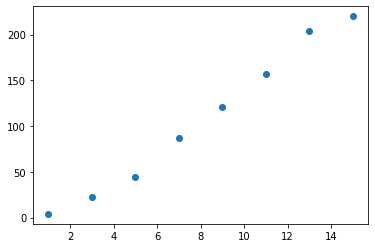

In [32]:
x = [1, 3, 5, 7, 9, 11, 13, 15]
y = [4, 23, 44, 87, 121, 157, 204, 220]

plt.scatter(x, y)

y = 16.607142857142858x + -25.35714285714286


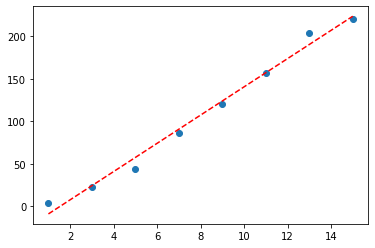

In [33]:
from sklearn.linear_model import LinearRegression

x = np.array(x)
y = np.array(y)

# Reshape the data to the correct shape for the LinearRegression model
x = x.reshape(-1, 1)
y = y.reshape(-1, 1)

# Create a LinearRegression model
model = LinearRegression()

# Fit the model to the data
model.fit(x, y)

# Get the equation of the line
b0 = model.intercept_[0]
b1 = model.coef_[0][0]
print(f"y = {b1}x + {b0}")

plt.scatter(x, y)
plt.plot(x, model.predict(x), 'r--')

This means that every game increase approxamitely increases the epoch time by 10 seconds.

In [34]:
model.predict(np.array([5]).reshape(-1, 1))

array([[57.67857143]])

Using the residual of the model, we can see that 5 game_plays is probably the best bet.

Let's test training 5 game_plays without caching.

In [35]:
def read_img(path):
    return cv2.imread(path)

In [37]:
set_seed(CFG.seed, True)
sample_gps = np.random.choice(kf_dict[0]['train_games'], 5, replace=False)
sample_gps

array(['58510_000855', '58538_002774', '58316_004343', '58188_001358',
       '58524_003049'], dtype='<U12')

In [38]:
val_gps = kf_dict[0]['val_games']

In [39]:
kf_dict = pickle.load(open('kf_dict', 'rb'))
frames_df = get_frames_df(df_combo_with_helmets.query('game_play in @sample_gps or game_play in @val_gps'),
                          kf_dict,
                          split=0,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=False,
                          sample_every_n_frame=6,
                          sample_train=None, 
                          sample_val=0.07)

In [40]:
tfms = [[partial(get_img, img_size=128)],
        [get_label, Categorize(vocab=['contact', 'no contact'])]]

means = [0.485, 0.456, 0.406] * 3
stds = [0.229, 0.224, 0.225] * 3

after_item = [ToTensor()]
after_batch = [*aug_transforms(), Normalize.from_stats(means, stds)]


splits = ColSplitter()(frames_df)
dsets = Datasets(frames_df, tfms, splits=splits)

dls = dsets.dataloaders(bs=16, after_item=after_item, after_batch=after_batch, shuffle=True)

In [41]:
# dls = get_dls(frames_df, img_size=224, bs=32, batch_tfms=[*aug_transforms()])
dls.rng.seed(CFG.seed)
# dls.show_batch()

In [42]:
set_seed(CFG.seed)
learn = get_learner('convnext_tiny', dls, metrics=[MatthewsCorrCoef()], n_in=9)

In [43]:
%%time

learn.fine_tune(2, 3e-3, cbs=SkipValidation(2))

CPU times: user 1min 5s, sys: 6.99 s, total: 1min 12s
Wall time: 5min 46s


But if the relationship is linear, will it actually be the same if I just run all of the game_plays using caching in the same epoch?

I need to test the prediction of the model, then run a caching experiment over all game_plays to see what actually_happens.

In [45]:
model.predict(np.array([len(kf_dict[0]['train_games'])]).reshape(-1, 1)) / 60

array([[52.7202381]])

In [46]:
@lru_cache(maxsize=1000)
def read_img(path):
    return cv2.imread(path)

def caching_experiment():
    global kf_dict
    
    read_img.cache_clear()
    
    set_seed(CFG.seed, True)
    
    kf_dict = pickle.load(open('kf_dict', 'rb'))
    frames_df = get_frames_df(df_combo_with_helmets,
                              kf_dict,
                              split=0,
                              frames_path=CFG.frames_path,
                              undersample_no_contact=False,
                              sample_every_n_frame=6,
                              sample_train=None, 
                              sample_val=0.07)
    
    tfms = [[partial(get_img, img_size=128)],
        [get_label, Categorize(vocab=['contact', 'no contact'])]]

    means = [0.485, 0.456, 0.406] * 3
    stds = [0.229, 0.224, 0.225] * 3

    after_item = [ToTensor()]
    after_batch = [*aug_transforms(), Normalize.from_stats(means, stds)]


    splits = ColSplitter()(frames_df)
    dsets = Datasets(frames_df, tfms, splits=splits)

    dls = dsets.dataloaders(bs=16, after_item=after_item, after_batch=after_batch, shuffle=True)
    
    dls.rng.seed(CFG.seed)
    
    set_seed(CFG.seed)
    learn = get_learner('convnext_tiny', dls, metrics=[MatthewsCorrCoef()], n_in=9)
    
    learn.fine_tune(1, 3e-3, freeze_epochs=0, cbs=SkipValidation(2))

In [ ]:
%%time

caching_experiment()

epoch,train_loss,valid_loss,matthews_corrcoef,time


In [54]:
((25.5*60 / 4) * 6 + 25.5*60) / 60

63.75

In [55]:
len(kf_dict[0]['train_games'])

192

In [67]:
for n in range(2, 15):
    print(n, ((192 // n) * model.predict(np.array([n]).reshape(-1, 1))) / 60)

2 [[12.57142857]]
3 [[26.0952381]]
4 [[32.85714286]]
5 [[36.5297619]]
6 [[39.61904762]]
7 [[40.90178571]]
8 [[43.]]
9 [[43.4375]]
10 [[44.55952381]]
11 [[44.57440476]]
12 [[46.38095238]]
13 [[44.45833333]]
14 [[44.88095238]]


So now it seems we can train one epoch with full data, and train another mutliple 5 game_play epochs in around half the time. 

Now what I need to do is test whether this outputs the same results.

Let's create the callback to change the dls.

In [13]:
def get_dls(seed, sample=False, n=5):
    global kf_dict
    global df_combo_with_helmets
    
    set_seed(seed, True)
    
    if sample:
        sample_gps = np.random.choice(kf_dict[0]['train_games'], n, replace=False)
        val_gps = kf_dict[0]['val_games']
        kf_dict = pickle.load(open('kf_dict', 'rb'))
        X = df_combo_with_helmets.query('game_play in @sample_gps or game_play in @val_gps').copy()
    else:
        X = df_combo_with_helmets.copy()
        
        
    frames_df = get_frames_df(X,
                              kf_dict,
                              split=0,
                              frames_path=CFG.frames_path,
                              undersample_no_contact=True,
                              sample_every_n_frame=6,
                              sample_train=None, 
                              sample_val=0.07)

    tfms = [[partial(get_img, img_size=128)],
    [get_label, Categorize(vocab=['contact', 'no contact'])]]

    means = [0.485, 0.456, 0.406] * 3
    stds = [0.229, 0.224, 0.225] * 3

    after_item = [ToTensor()]
    after_batch = [*aug_transforms(), Normalize.from_stats(means, stds)]


    splits = ColSplitter()(frames_df)
    dsets = Datasets(frames_df, tfms, splits=splits)

    return dsets.dataloaders(bs=16, after_item=after_item, after_batch=after_batch, shuffle=True)

In [14]:
class ShuffleGamePlayCallBack(Callback):
    def __init__(self, n):
        self.n = n
        
    def after_epoch(self):
        self.learn.dls = get_dls(CFG.seed+self.epoch, sample=True, n=self.n)
        
        
class SkipValidation(Callback):
    def __init__(self, every_epochs):
        self.every_epochs = every_epochs
    def before_validate(self):
        if (self.epoch+1) % self.every_epochs != 0:
            raise CancelValidException()

In [15]:
@lru_cache(maxsize=1200)
def read_img(path):
    return cv2.imread(path)

In [16]:
read_img.cache_clear()

In [24]:
n = 5

dls = get_dls(CFG.seed, sample=True, n=n)

dls.rng.seed(CFG.seed)
    
set_seed(CFG.seed)
learn = get_learner('convnext_tiny', dls, metrics=[MatthewsCorrCoef()], n_in=9)

epochs = (192//n) + 1

learn.fine_tune(epochs, 3e-3, freeze_epochs=0, cbs=[SkipValidation(epochs), ShuffleGamePlayCallBack(n)])

In [37]:
read_img.cache_clear()

In [17]:
n = 10

dls = get_dls(CFG.seed, sample=True, n=n)

dls.rng.seed(CFG.seed)
    
set_seed(CFG.seed)
learn = get_learner('convnext_tiny', dls, metrics=[MatthewsCorrCoef()], n_in=9)

epochs = (192//n) + 1

learn.fine_tune(epochs, 3e-3, freeze_epochs=0, cbs=[SkipValidation(epochs), ShuffleGamePlayCallBack(n)])

Downloading: "https://dl.fbaipublicfiles.com/convnext/convnext_tiny_1k_224_ema.pth" to /root/.cache/torch/hub/checkpoints/convnext_tiny_1k_224_ema.pth


In [18]:
read_img.cache_clear()

In [19]:
n = 3

dls = get_dls(CFG.seed, sample=True, n=n)

dls.rng.seed(CFG.seed)
    
set_seed(CFG.seed)
learn = get_learner('convnext_tiny', dls, metrics=[MatthewsCorrCoef()], n_in=9)

epochs = (192//n) + 1

learn.fine_tune(epochs, 3e-3, freeze_epochs=0, cbs=[SkipValidation(epochs), ShuffleGamePlayCallBack(n)])

In [56]:
def get_dls(df):
    tfms = [[partial(get_img, img_size=128)],
            [get_label, Categorize(vocab=['contact', 'no contact'])]]

    means = [0.485, 0.456, 0.406] * 3
    stds = [0.229, 0.224, 0.225] * 3

    after_item = [ToTensor()]
    after_batch = [*aug_transforms(), Normalize.from_stats(means, stds)]

    splits = ColSplitter()(df)
    dsets = Datasets(df, tfms, splits=splits)

    return dsets.dataloaders(bs=16, after_item=after_item, after_batch=after_batch, shuffle=True)


class ShuffleGamePlayCallBack(Callback):
    def __init__(self, df, game_plays, n):
        self.df = df
        self.n = n
        self.game_plays = game_plays
        self.cur_idx = n
        
    def after_epoch(self):
        sample_df = self.get_sample_df()
        self.learn.dls = get_dls(sample_df)    
        
    def get_sample_df(self):
        global kf_dict
        
        set_seed(CFG.seed)
        
        if self.cur_idx > len(self.game_plays):
            self.shuffle()
        
        sample_gps = self.game_plays[self.cur_idx:self.cur_idx+self.n]
        val_gps = kf_dict[0]['val_games']
        X = self.df.query('game_play in @sample_gps or game_play in @val_gps').copy()
        
        self.cur_idx += self.n
            
        sample_df = get_frames_df(X,
                          kf_dict,
                          split=0,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=None, 
                          sample_val=0.07).reset_index()   
        
        return sample_df
                      
    def shuffle(self):
        self.game_plays = np.random.shuffle(self.game_plays)
        self.cur_idx = 0

In [57]:
n = 3

train_game_plays = kf_dict[0]['train_games']
sample_gps = train_game_plays[:n]
val_gps = kf_dict[0]['val_games']
X = df_combo_with_helmets.query('game_play in @sample_gps or game_play in @val_gps').copy()

frames_df = get_frames_df(X,
                          kf_dict,
                          split=0,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=None, 
                          sample_val=0.07).reset_index()


dls = get_dls(frames_df)

dls.rng.seed(CFG.seed)
    
set_seed(CFG.seed)
learn = get_learner('convnext_tiny', dls, metrics=[MatthewsCorrCoef()], n_in=9)

epochs = (192//n) + 1

learn.fine_tune(epochs, 3e-3, freeze_epochs=0, cbs=[SkipValidation(epochs), ShuffleGamePlayCallBack(df_combo_with_helmets, train_game_plays, n)])

epoch,train_loss,valid_loss,matthews_corrcoef,time


KeyboardInterrupt: 

In [58]:
n = 10

train_game_plays = kf_dict[0]['train_games']
sample_gps = train_game_plays[:n]
val_gps = kf_dict[0]['val_games']
X = df_combo_with_helmets.query('game_play in @sample_gps or game_play in @val_gps').copy()

frames_df = get_frames_df(X,
                          kf_dict,
                          split=0,
                          frames_path=CFG.frames_path,
                          undersample_no_contact=True,
                          sample_every_n_frame=6,
                          sample_train=None, 
                          sample_val=0.07).reset_index()


dls = get_dls(frames_df)

dls.rng.seed(CFG.seed)
    
set_seed(CFG.seed)
learn = get_learner('convnext_tiny', dls, metrics=[MatthewsCorrCoef()], n_in=9)

epochs = (192//n) + 1

learn.fine_tune(epochs, 3e-3, freeze_epochs=0, cbs=[SkipValidation(epochs), ShuffleGamePlayCallBack(df_combo_with_helmets, train_game_plays, n)])

TypeError: Exception occured in `ShuffleGamePlayCallBack` when calling event `after_epoch`:
	'NoneType' object is not subscriptable

In [59]:
learn.validate()

(#2) [0.5438194274902344,0.49203452790204555]

In [17]:
dls = get_dls(CFG.seed, sample=False)

dls.rng.seed(CFG.seed)
    
set_seed(CFG.seed)
learn = get_learner('convnext_tiny', dls, metrics=[MatthewsCorrCoef()], n_in=9)

epochs = 1

learn.fine_tune(epochs, 3e-3, freeze_epochs=0)

epoch,train_loss,valid_loss,matthews_corrcoef,time
0,0.517989,0.495133,0.502374,1:24:09


## 2.5D with larger window

In [8]:
def get_frame_path(row, frames_path, window):
    # frames = range(row['frame']-(window//2), row['frame']+(window//2)+1)
    frames = range(row['frame'] - 6, row['frame'] + 12, 2)
    paths = []
    for frame in frames:
        frame = frame if len(str(frame)) > 3 else f'0{frame}'
        game_play = row['game_play']
        view = row['view']
        paths.append(f'{frames_path}/{game_play}_{view}.mp4_{frame}.jpg')
    return paths

In [9]:
from functools import lru_cache

@lru_cache(maxsize=1000)
def read_img(path):
    return cv2.imread(path)

def get_img(row, img_size=128, add_helmets=True):
    frames = []
    for path in row.path:
        if not os.path.isfile(path):
            continue
            
        frame = read_img(path)
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        if add_helmets:
            frame = cv2.rectangle(frame, 
                                  (int(row.left_1), int(row.top_1)),
                                  (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                                  (255, 0, 0), 1)

            frame = cv2.rectangle(frame, 
                                  (int(row.left_2), int(row.top_2)),
                                  (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                                  (255, 0, 0), 1)

        size = img_size // 2

        if row.center_y-size < 0:
            min_y = 0
            max_y = min_y + 2*size

        elif row.center_y+size > 719:
            min_y = 719 - 2*size
            max_y = 719

        else:
            min_y = row.center_y - size
            max_y = row.center_y + size

        if row.center_x-size < 0:
            min_x = 0
            max_x = min_x + 2*size

        elif row.center_x+size > 1279:
            min_x = 1279 - 2*size
            max_x = 1279

        else:
            min_x = row.center_x - size
            max_x = row.center_x + size
            
        if len(frame.shape) > 2:
            frame = frame[int(min_y):int(max_y), 
                                  int(min_x):int(max_x), :]
        else:
            frame = frame[int(min_y):int(max_y), 
                                  int(min_x):int(max_x)]
        
        frames.append(frame)
    
    if len(frames) < len(row.path):
        if os.path.isfile(row.path[0]):
            frames = frames + [frames[-1]]*(len(row.path) - len(frames))
        else:
            frames = [frames[0]]*(len(row.path) - len(frames)) + frames
        
    # return (np.stack(frames, axis=-1) / 255).astype(np.float32)
    return np.stack(frames, axis=0).astype(np.float32) / 255

In [10]:
def get_frames_df(df_combo, kf_dict, split, frames_path, window=3, sample_every_n_frame=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, seed=42):
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % @sample_every_n_frame == 0')
        val_combo = val_combo.query('(290 - frame) % @sample_every_n_frame == 0')
    
    if sample_train is not None:
        train_combo = train_combo.sample(frac=sample_train, random_state=seed)
        
    if sample_val is not None:
        val_combo = val_combo.sample(frac=sample_val, random_state=seed)
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])

    frames_df = pd.concat([train_combo, val_combo], axis=0)
    frames_df.frame = frames_df.frame.astype('int') 
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
        
    frames_df['path'] = frames_df.apply(lambda x: get_frame_path(x, frames_path, window), axis=1)
        
    return frames_df

In [11]:
def get_dls(frames_df, img_size=128, item_tfms=None, batch_tfms=None, bs=64, shuffle=True, drop_last=False):
    return DataBlock(
        blocks=(ImageBlock, CategoryBlock),
        get_x=partial(get_img, img_size=img_size, add_helmets=True),
        get_y=get_label,
        splitter=ColSplitter(),
        item_tfms=item_tfms,
        batch_tfms=batch_tfms
    ).dataloaders(frames_df, bs=bs, shuffle=shuffle, drop_last=drop_last)

In [12]:
def get_learner(model, dls, n_in=3, metrics=[accuracy, F1Score]):
    return vision_learner(dls, model, metrics=metrics, n_in=n_in).to_fp16()

In [13]:
set_seed(CFG.seed, True)

In [14]:
kf_dict = pickle.load(open('kf_dict', 'rb'))
frames_df = get_frames_df(df_combo_with_helmets, kf_dict, split=0, frames_path=CFG.frames_path, undersample_no_contact=True, sample_every_n_frame=6, sample_train=None, sample_val=0.07)

In [23]:
tfms = [[partial(get_img, img_size=128)],
        [get_label, Categorize(vocab=['contact', 'no contact'])]]

means = [0.485, 0.456, 0.406] * 3
stds = [0.229, 0.224, 0.225] * 3

after_item = [ToTensor()]
after_batch = [*aug_transforms(), Normalize.from_stats(means, stds)]


splits = ColSplitter()(frames_df)
dsets = Datasets(frames_df, tfms, splits=splits)

dls = dsets.dataloaders(bs=16, after_item=after_item, after_batch=after_batch, shuffle=True)

In [24]:
# dls = get_dls(frames_df, img_size=224, bs=32, batch_tfms=[*aug_transforms()])
dls.rng.seed(CFG.seed)
# dls.show_batch()

In [25]:
set_seed(CFG.seed)
learn = get_learner('convnext_tiny', dls, metrics=[MatthewsCorrCoef()], n_in=9)

SuggestedLRs(valley=0.0012022644514217973)

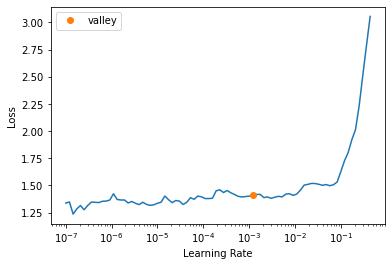

In [26]:
learn.lr_find()

In [ ]:
learn.fine_tune(30, 3e-3, cbs=SaveModelCallback(monitor='matthews_corrcoef', fname='model-6', with_opt=True))

epoch,train_loss,valid_loss,matthews_corrcoef,time
0,0.532920,0.527396,0.472325,34:48


Better model found at epoch 0 with matthews_corrcoef value: 0.4723253676281409.


epoch,train_loss,valid_loss,matthews_corrcoef,time
0,0.496274,0.494661,0.507648,36:53
1,0.509210,0.495380,0.512942,38:35
2,0.473784,0.454778,0.518318,40:07


Better model found at epoch 0 with matthews_corrcoef value: 0.5076478279019878.
Better model found at epoch 1 with matthews_corrcoef value: 0.5129421775573839.
Better model found at epoch 2 with matthews_corrcoef value: 0.5183179392496036.


In [68]:
learn = learn.load('model-6')

In [104]:
frames_df = get_frames_df(df_combo_with_helmets, kf_dict, split=0, frames_path=CFG.frames_path, sample_every_n_frame=6, sample_train=0.01, sample_val=None)
val_df = frames_df.query('is_valid').copy()

val_dl = learn.dls.test_dl(val_df, with_labels=True)
preds, _ = learn.get_preds(dl=val_dl) 

val_df.loc[:, 'contact_pred'] = preds.cpu().detach().numpy()[:, 0]
val_df = add_contact_id(val_df)

val_dist = df_combo[df_combo.game_play.isin(val_df.game_play.unique())].copy()

val_dist["distance"] = val_dist["distance"].fillna(99)  # Fill player to ground with 9    
val_dist_agg = val_dist.merge(val_df.groupby('contact_id', as_index=False).contact_pred.mean(), how='left', on='contact_id')

In [105]:
from sklearn.metrics import confusion_matrix

In [119]:
out = np.where(val_dist_agg['contact_pred'].isna(),
               val_dist_agg['distance'] <= 1, 
               val_dist_agg['contact_pred'] > 0.5).astype(int)

# print('Baseline', matthews_corrcoef(val_dist_agg['contact'], (val_dist_agg['distance'] <= 1).astype(int)))
print(thresh, matthews_corrcoef(val_dist_agg['contact'], out))
print(confusion_matrix(val_dist_agg['contact'], out))

1.0 0.5983397719886848
[[931035   4723]
 [  5049   7437]]


In [114]:
from sklearn.metrics import ConfusionMatrixDisplay

In [129]:
cm = confusion_matrix(val_dist_agg['contact'], out, labels=[0, 1])
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                             display_labels=['no contact', 'contact'])

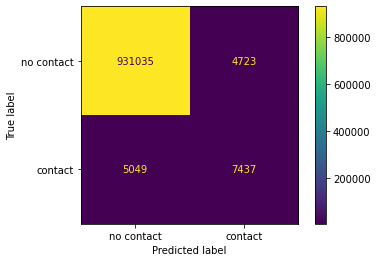

In [130]:
disp.plot();

In [131]:
cm = confusion_matrix(val_df.groupby('contact_id').contact.mean(), val_df.groupby('contact_id').contact_pred.mean() > 0.5, labels=[0, 1])
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                             display_labels=['no contact', 'contact'])

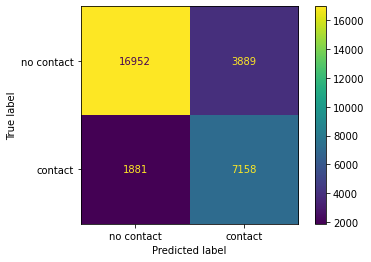

In [132]:
disp.plot();

In [123]:
interp = ClassificationInterpretation.from_learner(learn, dl=val_dl)

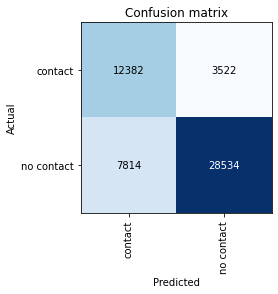

In [124]:
interp.plot_confusion_matrix()

## How important is player to ground contact in the final metric?

### Temp functions

In [8]:
def get_frame_path(row, frames_path, window):
    # frames = range(row['frame']-(window//2), row['frame']+(window//2)+1)
    frames = range(row['frame'], row['frame'] + 6, 2)
    paths = []
    for frame in frames:
        frame = frame if len(str(frame)) > 3 else f'0{frame}'
        game_play = row['game_play']
        view = row['view']
        paths.append(f'{frames_path}/{game_play}_{view}.mp4_{frame}.jpg')
    return paths

In [9]:
from functools import lru_cache

@lru_cache(maxsize=1000)
def read_img(path):
    return cv2.imread(path)

def get_img(row, img_size=128, add_helmets=True):
    frames = []
    for path in row.path:
        if not os.path.isfile(path):
            continue
            
        frame = read_img(path)
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        if add_helmets:
            frame = cv2.rectangle(frame, 
                                  (int(row.left_1), int(row.top_1)),
                                  (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                                  (255, 0, 0), 1)

            frame = cv2.rectangle(frame, 
                                  (int(row.left_2), int(row.top_2)),
                                  (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                                  (255, 0, 0), 1)

        size = img_size // 2

        if row.center_y-size < 0:
            min_y = 0
            max_y = min_y + 2*size

        elif row.center_y+size > 719:
            min_y = 719 - 2*size
            max_y = 719

        else:
            min_y = row.center_y - size
            max_y = row.center_y + size

        if row.center_x-size < 0:
            min_x = 0
            max_x = min_x + 2*size

        elif row.center_x+size > 1279:
            min_x = 1279 - 2*size
            max_x = 1279

        else:
            min_x = row.center_x - size
            max_x = row.center_x + size
            
        if len(frame.shape) > 2:
            frame = frame[int(min_y):int(max_y), 
                                  int(min_x):int(max_x), :]
        else:
            frame = frame[int(min_y):int(max_y), 
                                  int(min_x):int(max_x)]
        
        frames.append(frame)
    
    if len(frames) < len(row.path):
        if os.path.isfile(row.path[0]):
            frames = frames + [frames[-1]]*(len(row.path) - len(frames))
        else:
            frames = [frames[0]]*(len(row.path) - len(frames)) + frames
        
    # return (np.stack(frames, axis=-1) / 255).astype(np.float32)
    return np.stack(frames, axis=-1)

In [10]:
def get_frames_df(df_combo, kf_dict, split, frames_path, window=3, sample_every_n_frame=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, seed=42):
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % @sample_every_n_frame == 0')
        val_combo = val_combo.query('(290 - frame) % @sample_every_n_frame == 0')
    
    if sample_train is not None:
        train_combo = train_combo.sample(frac=sample_train, random_state=seed)
        
    if sample_val is not None:
        val_combo = val_combo.sample(frac=sample_val, random_state=seed)
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])

    frames_df = pd.concat([train_combo, val_combo], axis=0)
    frames_df.frame = frames_df.frame.astype('int') 
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
        
    frames_df['path'] = frames_df.apply(lambda x: get_frame_path(x, frames_path, window), axis=1)
        
    return frames_df

In [11]:
def get_dls(frames_df, img_size=128, item_tfms=None, batch_tfms=None, bs=64, shuffle=True, drop_last=False):
    return DataBlock(
        blocks=(ImageBlock, CategoryBlock),
        get_x=partial(get_img, img_size=img_size, add_helmets=True),
        get_y=get_label,
        splitter=ColSplitter(),
        item_tfms=item_tfms,
        batch_tfms=batch_tfms
    ).dataloaders(frames_df, bs=bs, shuffle=shuffle, drop_last=drop_last)

In [12]:
def get_learner(model, dls, n_in=3, metrics=[accuracy, F1Score]):
    return vision_learner(dls, model, metrics=metrics, n_in=n_in).to_fp16()

### Run validation without player to ground

In [13]:
learn = load_learner('nflutils/model-5.pkl', cpu=False)

frames_df = get_frames_df(df_combo_with_helmets, kf_dict, split=0, frames_path=CFG.frames_path, sample_every_n_frame=6, sample_train=0.01, sample_val=None)
val_df = frames_df.query('is_valid').copy()

val_dl = learn.dls.test_dl(val_df, with_labels=True)
preds, _ = learn.get_preds(dl=val_dl) 

val_df.loc[:, 'contact_pred'] = preds.cpu().detach().numpy()[:, 0]
val_df = add_contact_id(val_df)

val_dist = df_combo[df_combo.game_play.isin(val_df.game_play.unique())].copy()

val_dist["distance"] = val_dist["distance"].fillna(99)  # Fill player to ground with 9    
val_dist_agg = val_dist.merge(val_df.groupby('contact_id', as_index=False).contact_pred.mean(), how='left', on='contact_id')

out = np.where(val_dist_agg['contact_pred'].isna(),
               val_dist_agg['distance'] <= 1, 
               val_dist_agg['contact_pred'] > 0.5).astype(int)

# print('Baseline', matthews_corrcoef(val_dist_agg['contact'], (val_dist_agg['distance'] <= 1).astype(int)))

In [14]:
print(matthews_corrcoef(val_dist_agg['contact'], out))

0.598282911351636


In [73]:
val_dist_agg = val_dist.merge(val_df.groupby('contact_id', as_index=False).contact_pred.mean(), how='left', on='contact_id')
# val_dist_agg['contact_pred'] = np.where(val_dist_agg.nfl_player_id_2 == "G", val_dist_agg["contact"], val_dist_agg["contact_pred"])

out = np.where(val_dist_agg['contact_pred'].isna(),
               val_dist_agg['distance'] <= 1, 
               val_dist_agg['contact_pred'] > 0.5).astype(int)

print(matthews_corrcoef(val_dist_agg['contact'], out))

0.376972950912044


In [21]:
(0.75 - 0.6) / 0.6

0.25000000000000006

There is a 25% increase if I created a model that 100% predict ground contact correctly.

In [45]:
val_dist_agg = val_dist.merge(val_df.groupby('contact_id', as_index=False).contact_pred.mean(), how='left', on='contact_id')

rand_01 = np.random.randint(0, 2, size=len(val_dist_agg))

val_dist_agg['contact_pred'] = np.where((val_dist_agg.nfl_player_id_2 == "G").values & rand_01 == 1,
                                        val_dist_agg["contact"], 
                                        val_dist_agg["contact_pred"])

out = np.where(val_dist_agg['contact_pred'].isna(),
               val_dist_agg['distance'] <= 1, 
               val_dist_agg['contact_pred'] > 0.5).astype(int)

print(matthews_corrcoef(val_dist_agg['contact'], out))

0.674690359989153


In [46]:
val_dist_agg.query('nfl_player_id_2 == "G"').shape[0], val_dist_agg.query('nfl_player_id_2 == "G" and contact == contact_pred').shape[0]

(82456, 40948)

In [33]:
(0.68 - 0.6) / 0.6

0.13333333333333347

That's a 13% in the metric based on basically getting 50% predictions correct. So if we have a model that outputs 50% accuracy we are good to go.

### Train a simple model on ground data

In [14]:
ground_df = df_combo.query('nfl_player_id_2 == "G"')

In [15]:
ground_df.head()

,contact_id,game_play,datetime,step,nfl_player_id_1,nfl_player_id_2,contact,x_position_1,y_position_1,x_position_2,y_position_2,distance
231,58168_003392_0_38590_G,58168_003392,2020-09-11 03:01:48.100000+00:00,0,38590,G,0,40.33,25.28,NaN,NaN,NaN
232,58168_003392_0_43854_G,58168_003392,2020-09-11 03:01:48.100000+00:00,0,43854,G,0,41.99,16.79,NaN,NaN,NaN
233,58168_003392_0_41257_G,58168_003392,2020-09-11 03:01:48.100000+00:00,0,41257,G,0,45.77,15.59,NaN,NaN,NaN
234,58168_003392_0_41944_G,58168_003392,2020-09-11 03:01:48.100000+00:00,0,41944,G,0,42.00,22.85,NaN,NaN,NaN
235,58168_003392_0_42386_G,58168_003392,2020-09-11 03:01:48.100000+00:00,0,42386,G,0,45.87,23.89,NaN,NaN,NaN


I need to add tracking data to each player.

In [16]:
tr_tracking = pd.read_csv('nfl-player-contact-detection/train_player_tracking.csv', low_memory=False)
tr_tracking['nfl_player_id_1'] = tr_tracking['nfl_player_id']
tr_tracking['nfl_player_id_2'] = 'G'
tr_tracking = add_contact_id(tr_tracking)
tr_tracking.head()

,game_play,game_key,play_id,nfl_player_id,datetime,step,team,position,jersey_number,x_position,y_position,speed,distance,direction,orientation,acceleration,sa,nfl_player_id_1,nfl_player_id_2,contact_id
0,58580_001136,58580,1136,44830,2021-10-10T21:08:20.900Z,-108,away,CB,22,61.59,42.60,1.11,0.11,320.33,263.93,0.71,-0.64,44830,G,58580_001136_-108_44830_G
1,58580_001136,58580,1136,47800,2021-10-10T21:08:20.900Z,-108,away,DE,97,59.48,26.81,0.23,0.01,346.84,247.16,1.29,0.90,47800,G,58580_001136_-108_47800_G
2,58580_001136,58580,1136,52444,2021-10-10T21:08:20.900Z,-108,away,FS,29,72.19,31.46,0.61,0.06,11.77,247.69,0.63,-0.33,52444,G,58580_001136_-108_52444_G
3,58580_001136,58580,1136,46206,2021-10-10T21:08:20.900Z,-108,home,TE,86,57.37,22.12,0.37,0.04,127.85,63.63,0.69,0.62,46206,G,58580_001136_-108_46206_G
4,58580_001136,58580,1136,52663,2021-10-10T21:08:20.900Z,-108,away,ILB,48,63.25,27.50,0.51,0.05,183.62,253.71,0.31,0.31,52663,G,58580_001136_-108_52663_G


In [17]:
ground_df = (ground_df
             .drop('distance', axis=1)
             .merge(
                 tr_tracking[['contact_id', 'speed', 'distance', 'direction', 'orientation', 'acceleration', 'sa']],
                 how='left', 
                 on='contact_id'))    

In [18]:
ground_df.head()

,contact_id,game_play,datetime,step,nfl_player_id_1,nfl_player_id_2,contact,x_position_1,y_position_1,x_position_2,y_position_2,speed,distance,direction,orientation,acceleration,sa
0,58168_003392_0_38590_G,58168_003392,2020-09-11 03:01:48.100000+00:00,0,38590,G,0,40.33,25.28,NaN,NaN,0.52,0.06,141.08,100.37,0.59,0.58
1,58168_003392_0_43854_G,58168_003392,2020-09-11 03:01:48.100000+00:00,0,43854,G,0,41.99,16.79,NaN,NaN,0.74,0.06,263.92,294.74,1.74,1.74
2,58168_003392_0_41257_G,58168_003392,2020-09-11 03:01:48.100000+00:00,0,41257,G,0,45.77,15.59,NaN,NaN,0.67,0.07,180.38,270.88,0.34,0.08
3,58168_003392_0_41944_G,58168_003392,2020-09-11 03:01:48.100000+00:00,0,41944,G,0,42.00,22.85,NaN,NaN,0.68,0.08,234.17,282.07,0.81,0.81
4,58168_003392_0_42386_G,58168_003392,2020-09-11 03:01:48.100000+00:00,0,42386,G,0,45.87,23.89,NaN,NaN,0.61,0.06,221.19,269.45,1.11,1.10


In [19]:
X, y = ground_df[['step', 'x_position_1', 'y_position_1', 'speed',
                  'distance', 'direction', 'orientation', 'acceleration', 'sa']], ground_df['contact']

In [20]:
is_train = ground_df.game_play.isin(kf_dict[0]['train_games'])
is_val = ground_df.game_play.isin(kf_dict[0]['val_games'])

X_train, X_val = X[is_train], X[is_val]
y_train, y_val = y[is_train], y[is_val]

In [21]:
dev_idx = np.random.choice(X_train.index, size=int(len(is_train)*0.1), replace=False)

X_dev = X.loc[dev_idx]
y_dev = y.loc[dev_idx]

In [22]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report

In [55]:
clf = RandomForestClassifier(random_state=CFG.seed)

clf.fit(X_dev.values, y_dev.values)

RandomForestClassifier(random_state=4121995)

In [61]:
preds = clf.predict(X_val.values)
zeros = np.zeros_like(preds)

In [62]:
print(matthews_corrcoef(y_val, preds), accuracy_score(y_val, preds))
print(matthews_corrcoef(y_val, zeros), accuracy_score(y_val, zeros))

0.15909775889869826 0.9646720675269235
0.0 0.9643688755214902


In [60]:
print(classification_report(y_val, preds))

              precision    recall  f1-score   support

           0       0.97      1.00      0.98     79518
           1       0.55      0.05      0.09      2938

    accuracy                           0.96     82456
   macro avg       0.76      0.52      0.54     82456
weighted avg       0.95      0.96      0.95     82456



Despite having bad results, it is still able to improve the metric

Let's undersample the non-contact a little bit.

In [63]:
y_train.sum()

13876

In [23]:
X_dev = pd.concat([
    X_train[y_train == 1],
    X_train[y_train == 0].sample(y_train.sum(), random_state=CFG.seed)
])

y_dev = pd.concat([
    y_train[y_train == 1],
    y_train[y_train == 0].sample(y_train.sum(), random_state=CFG.seed)
])

In [24]:
clf = RandomForestClassifier(random_state=CFG.seed)

clf.fit(X_dev.values, y_dev.values)

RandomForestClassifier(random_state=4121995)

In [38]:
preds = clf.predict(X_val.values)
print(matthews_corrcoef(y_val, preds), accuracy_score(y_val, preds))
print(classification_report(y_val, preds))

0.34846540546025345 0.8602042301348598
              precision    recall  f1-score   support

           0       0.99      0.86      0.92     79518
           1       0.18      0.83      0.30      2938

    accuracy                           0.86     82456
   macro avg       0.59      0.85      0.61     82456
weighted avg       0.96      0.86      0.90     82456



Now let's test the original validation after this model

In [42]:
ground_dist_agg = val_dist_agg.drop('distance', axis=1).merge(
    ground_df[list(X_train.columns[3:]) + ['contact_id']], on='contact_id', how='left')[X_train.columns].fillna(0).values
preds = clf.predict(ground_dist_agg)

In [43]:
val_dist_agg = val_dist.merge(val_df.groupby('contact_id', as_index=False).contact_pred.mean(), how='left', on='contact_id')

out = np.where(val_dist_agg['contact_pred'].isna(),
               val_dist_agg['distance'] <= 1, 
               val_dist_agg['contact_pred'] > 0.5).astype(int)

print(matthews_corrcoef(val_dist_agg['contact'], out))

out = np.where(val_dist_agg.nfl_player_id_2 == "G", 
               preds,
               out)
               
print(matthews_corrcoef(val_dist_agg['contact'], out))

0.598282911351636
0.5445617055889185


## Adding 2.5D to frame pipeline

In [8]:
def get_frame_path(row, frames_path, window):
    # frames = range(row['frame']-(window//2), row['frame']+(window//2)+1)
    frames = range(row['frame'], row['frame'] + 6, 2)
    paths = []
    for frame in frames:
        frame = frame if len(str(frame)) > 3 else f'0{frame}'
        game_play = row['game_play']
        view = row['view']
        paths.append(f'{frames_path}/{game_play}_{view}.mp4_{frame}.jpg')
    return paths

In [9]:
from functools import lru_cache

@lru_cache(maxsize=1000)
def read_img(path):
    return cv2.imread(path)

def get_img(row, img_size=128, add_helmets=True):
    frames = []
    for path in row.path:
        if not os.path.isfile(path):
            continue
            
        frame = read_img(path)
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        if add_helmets:
            frame = cv2.rectangle(frame, 
                                  (int(row.left_1), int(row.top_1)),
                                  (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                                  (255, 0, 0), 1)

            frame = cv2.rectangle(frame, 
                                  (int(row.left_2), int(row.top_2)),
                                  (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                                  (255, 0, 0), 1)

        size = img_size // 2

        if row.center_y-size < 0:
            min_y = 0
            max_y = min_y + 2*size

        elif row.center_y+size > 719:
            min_y = 719 - 2*size
            max_y = 719

        else:
            min_y = row.center_y - size
            max_y = row.center_y + size

        if row.center_x-size < 0:
            min_x = 0
            max_x = min_x + 2*size

        elif row.center_x+size > 1279:
            min_x = 1279 - 2*size
            max_x = 1279

        else:
            min_x = row.center_x - size
            max_x = row.center_x + size
            
        if len(frame.shape) > 2:
            frame = frame[int(min_y):int(max_y), 
                                  int(min_x):int(max_x), :]
        else:
            frame = frame[int(min_y):int(max_y), 
                                  int(min_x):int(max_x)]
        
        frames.append(frame)
    
    if len(frames) < len(row.path):
        if os.path.isfile(row.path[0]):
            frames = frames + [frames[-1]]*(len(row.path) - len(frames))
        else:
            frames = [frames[0]]*(len(row.path) - len(frames)) + frames
        
    # return (np.stack(frames, axis=-1) / 255).astype(np.float32)
    return np.stack(frames, axis=-1)

In [10]:
def get_frames_df(df_combo, kf_dict, split, frames_path, window=3, sample_every_n_frame=None, sample_train=None, sample_val=None, undersample_no_contact=False, filter_views=None, seed=42):
    train_game_plays = kf_dict[split]['train_games']
    val_game_plays = kf_dict[split]['val_games']
    
    train_combo = df_combo.query('game_play in @train_game_plays').copy()
    val_combo = df_combo.query('game_play in @val_game_plays').copy()
    
    train_combo['is_valid'] = False
    val_combo['is_valid'] = True
    
    if sample_every_n_frame is not None:
        train_combo = train_combo.query('(290 - frame) % @sample_every_n_frame == 0')
        val_combo = val_combo.query('(290 - frame) % @sample_every_n_frame == 0')
    
    if sample_train is not None:
        train_combo = train_combo.sample(frac=sample_train, random_state=seed)
        
    if sample_val is not None:
        val_combo = val_combo.sample(frac=sample_val, random_state=seed)
        
    if undersample_no_contact:
        train_combo = pd.concat([
            train_combo.query('contact == 1'),
            train_combo.query('contact == 0').sample(
                len(train_combo.query('contact == 1')), random_state=seed
            )
        ])

    frames_df = pd.concat([train_combo, val_combo], axis=0)
    frames_df.frame = frames_df.frame.astype('int') 
    
    if filter_views is not None:
        frames_df = frames_df.query('view in @filter_views')
        
    frames_df['path'] = frames_df.apply(lambda x: get_frame_path(x, frames_path, window), axis=1)
        
    return frames_df

In [11]:
def get_dls(frames_df, img_size=128, item_tfms=None, batch_tfms=None, bs=64, shuffle=True, drop_last=False):
    return DataBlock(
        blocks=(ImageBlock, CategoryBlock),
        get_x=partial(get_img, img_size=img_size, add_helmets=True),
        get_y=get_label,
        splitter=ColSplitter(),
        item_tfms=item_tfms,
        batch_tfms=batch_tfms
    ).dataloaders(frames_df, bs=bs, shuffle=shuffle, drop_last=drop_last)

In [12]:
def get_learner(model, dls, n_in=3, metrics=[accuracy, F1Score]):
    return vision_learner(dls, model, metrics=metrics, n_in=n_in).to_fp16()

In [13]:
frames_df = get_frames_df(df_combo_with_helmets, kf_dict, split=0, frames_path=CFG.frames_path, sample_every_n_frame=6, sample_train=0.01, sample_val=0.07)

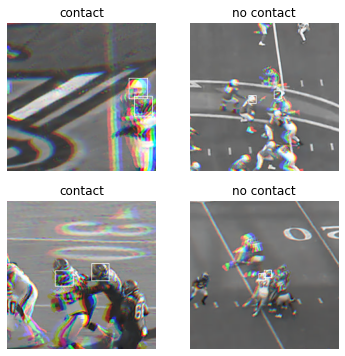

In [144]:
dls = get_dls(frames_df, img_size=224, bs=4)
dls.show_batch()

### Test a model

In [13]:
set_seed(CFG.seed, True)

In [14]:
kf_dict = pickle.load(open('kf_dict', 'rb'))
frames_df = get_frames_df(df_combo_with_helmets, kf_dict, split=0, frames_path=CFG.frames_path, undersample_no_contact=True, sample_every_n_frame=6, sample_train=None, sample_val=0.07)

In [15]:
# tfms = [[partial(get_img, img_size=224)],
#         [get_label, Categorize(vocab=['no contact', 'contact'])]]

# after_item = [ToTensor()]

# splits = ColSplitter()(frames_df)
# dsets = Datasets(frames_df, tfms, splits=splits)

# dls = dsets.dataloaders(bs=16, after_item=after_item)

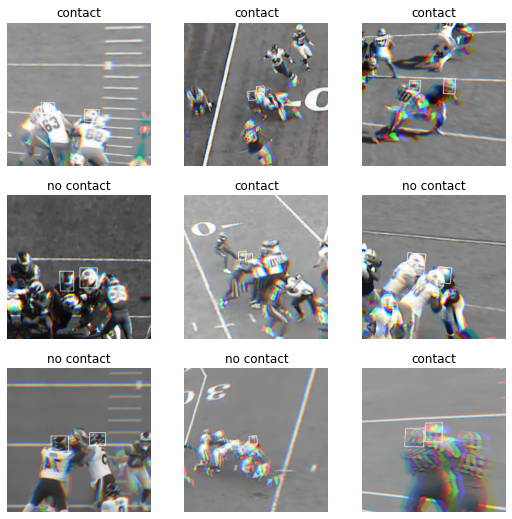

In [16]:
dls = get_dls(frames_df, img_size=224, bs=32, batch_tfms=[*aug_transforms()])
dls.rng.seed(CFG.seed)
dls.show_batch()

In [17]:
learn = get_learner('convnext_tiny', dls, metrics=[MatthewsCorrCoef()], n_in=3)

Downloading: "https://dl.fbaipublicfiles.com/convnext/convnext_tiny_1k_224_ema.pth" to /root/.cache/torch/hub/checkpoints/convnext_tiny_1k_224_ema.pth


SuggestedLRs(valley=0.00015848931798245758)

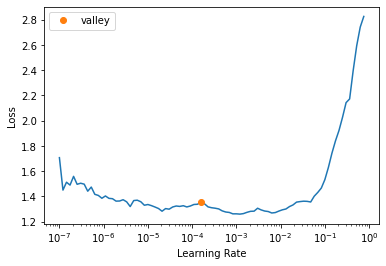

In [22]:
learn.lr_find()

In [ ]:
learn.fine_tune(30, 1e-3, cbs=SaveModelCallback(monitor='matthews_corrcoef', fname='model-5', with_opt=True))

epoch,train_loss,valid_loss,matthews_corrcoef,time
0,0.623529,0.606375,0.358952,15:29


Better model found at epoch 0 with matthews_corrcoef value: 0.3589522708343221.


epoch,train_loss,valid_loss,matthews_corrcoef,time
0,0.586358,0.567116,0.410134,16:10
1,0.546053,0.551092,0.451600,13:43
2,0.530176,0.530831,0.477570,16:33
3,0.510136,0.500745,0.503325,16:10
4,0.483633,0.503065,0.506029,16:01
5,0.483158,0.490609,0.514688,16:47
6,0.461113,0.458055,0.521893,17:32
7,0.446794,0.479421,0.537178,16:59
8,0.421700,0.481119,0.542300,17:15
9,0.452554,0.429419,0.549766,17:51


Better model found at epoch 0 with matthews_corrcoef value: 0.41013434574133595.
Better model found at epoch 1 with matthews_corrcoef value: 0.45160025676762794.
Better model found at epoch 2 with matthews_corrcoef value: 0.4775695692419575.
Better model found at epoch 3 with matthews_corrcoef value: 0.5033246806201369.
Better model found at epoch 4 with matthews_corrcoef value: 0.5060290018083969.
Better model found at epoch 5 with matthews_corrcoef value: 0.5146884692237811.
Better model found at epoch 6 with matthews_corrcoef value: 0.5218928227976423.
Better model found at epoch 7 with matthews_corrcoef value: 0.5371782956144069.
Better model found at epoch 8 with matthews_corrcoef value: 0.5422995996696742.
Better model found at epoch 9 with matthews_corrcoef value: 0.5497661467734901.
Better model found at epoch 12 with matthews_corrcoef value: 0.5534979540317603.
Better model found at epoch 13 with matthews_corrcoef value: 0.5539403469210575.
Better model found at epoch 15 with 

In [68]:
learn = learn.load('model-5')

In [104]:
frames_df = get_frames_df(df_combo_with_helmets, kf_dict, split=0, frames_path=CFG.frames_path, sample_every_n_frame=6, sample_train=0.01, sample_val=None)
val_df = frames_df.query('is_valid').copy()

val_dl = learn.dls.test_dl(val_df, with_labels=True)
preds, _ = learn.get_preds(dl=val_dl) 

val_df.loc[:, 'contact_pred'] = preds.cpu().detach().numpy()[:, 0]
val_df = add_contact_id(val_df)

val_dist = df_combo[df_combo.game_play.isin(val_df.game_play.unique())].copy()

val_dist["distance"] = val_dist["distance"].fillna(99)  # Fill player to ground with 9    
val_dist_agg = val_dist.merge(val_df.groupby('contact_id', as_index=False).contact_pred.mean(), how='left', on='contact_id')

In [105]:
from sklearn.metrics import confusion_matrix

In [119]:
out = np.where(val_dist_agg['contact_pred'].isna(),
               val_dist_agg['distance'] <= 1, 
               val_dist_agg['contact_pred'] > 0.5).astype(int)

# print('Baseline', matthews_corrcoef(val_dist_agg['contact'], (val_dist_agg['distance'] <= 1).astype(int)))
print(thresh, matthews_corrcoef(val_dist_agg['contact'], out))
print(confusion_matrix(val_dist_agg['contact'], out))

1.0 0.5983397719886848
[[931035   4723]
 [  5049   7437]]


In [114]:
from sklearn.metrics import ConfusionMatrixDisplay

In [129]:
cm = confusion_matrix(val_dist_agg['contact'], out, labels=[0, 1])
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                             display_labels=['no contact', 'contact'])

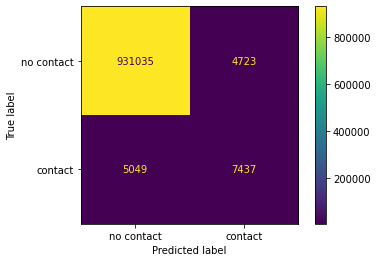

In [130]:
disp.plot();

In [131]:
cm = confusion_matrix(val_df.groupby('contact_id').contact.mean(), val_df.groupby('contact_id').contact_pred.mean() > 0.5, labels=[0, 1])
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                             display_labels=['no contact', 'contact'])

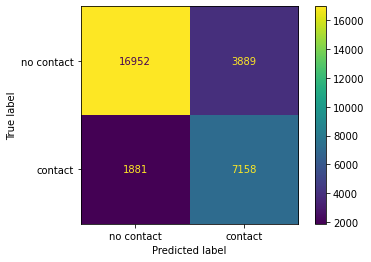

In [132]:
disp.plot();

In [123]:
interp = ClassificationInterpretation.from_learner(learn, dl=val_dl)

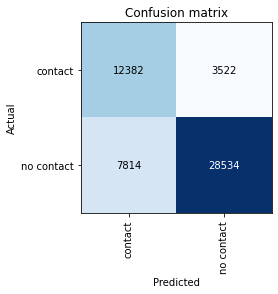

In [124]:
interp.plot_confusion_matrix()

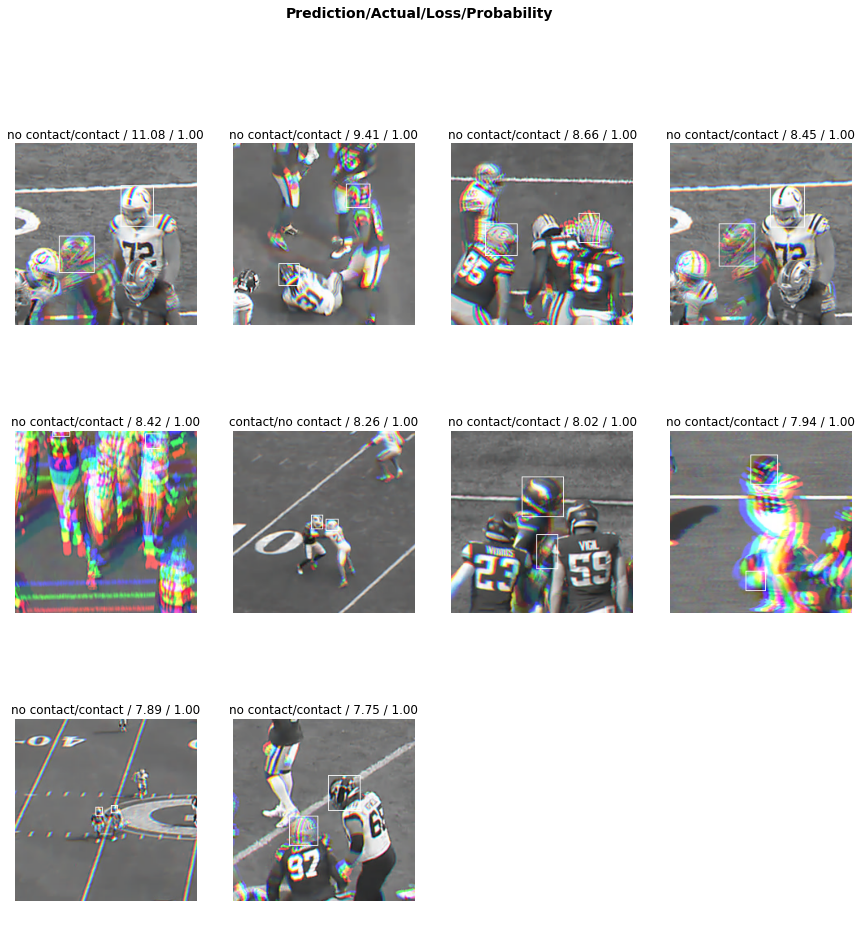

In [51]:
interp.plot_top_losses(k=10, largest=True, figsize=(15, 15))

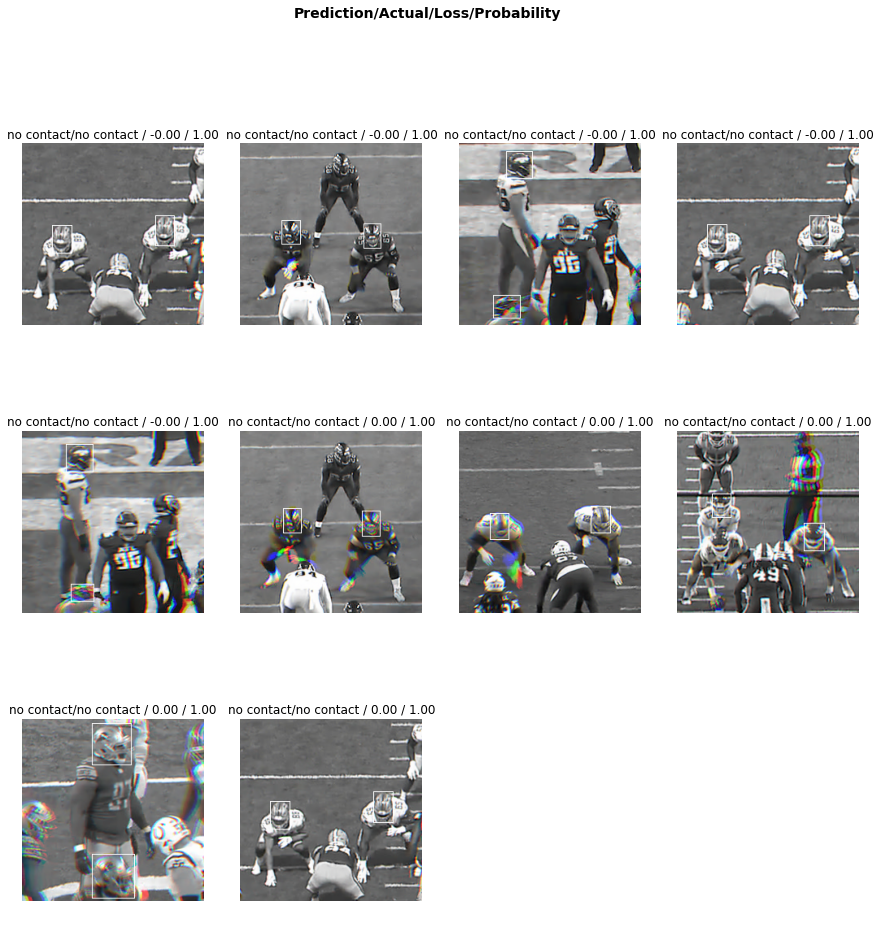

In [63]:
interp.plot_top_losses(k=10, largest=False, figsize=(15, 15))

In [64]:
learn.export('nflutils/model-5.pkl')

## Identifying the bottlneck

In [70]:
frames_df = get_frames_df(df_combo_with_helmets, kf_dict, split=0, frames_path=CFG.frames_path, sample_every_n_frame=2, sample_train=0.01, sample_val=0.07)

## Exploring the performance of the trained frame classification models

### Model 3

In [12]:
kf_dict = pickle.load(open(CFG.utils_path+'/kf_dict', 'rb'))
cpu = not torch.cuda.is_available()

frames_df = get_frames_df(df_combo_with_helmets, kf_dict, split=0, frames_path=CFG.frames_path, sample_every_n_frame=2, sample_train=0.01, sample_val=0.07)
val_df = frames_df.query('is_valid').copy()

learn = load_learner(CFG.utils_path+'/model-3.pkl', cpu=cpu)

val_dl = learn.dls.test_dl(val_df, with_labels=True)
losses = learn.get_preds(dl=val_dl, with_loss=True, with_targs=False, with_preds=False)

In [16]:
interp = ClassificationInterpretation.from_learner(learn, dl=val_dl)

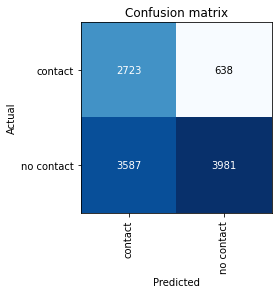

In [17]:
interp.plot_confusion_matrix()

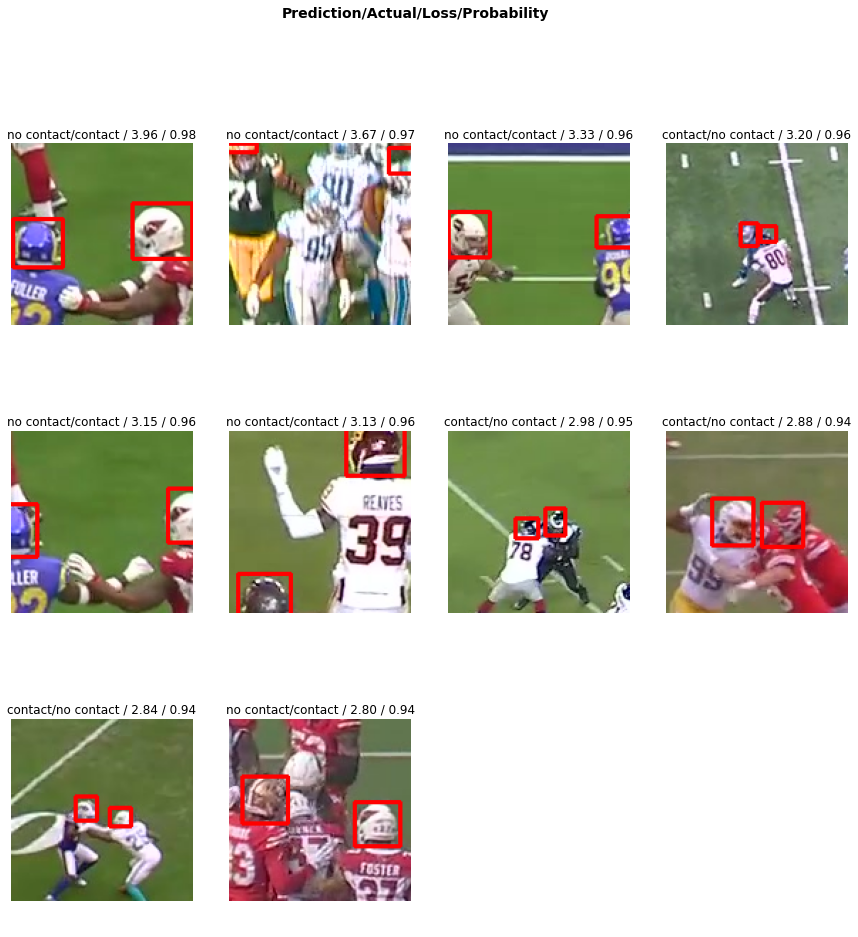

In [20]:
interp.plot_top_losses(k=10, largest=True, figsize=(15, 15))

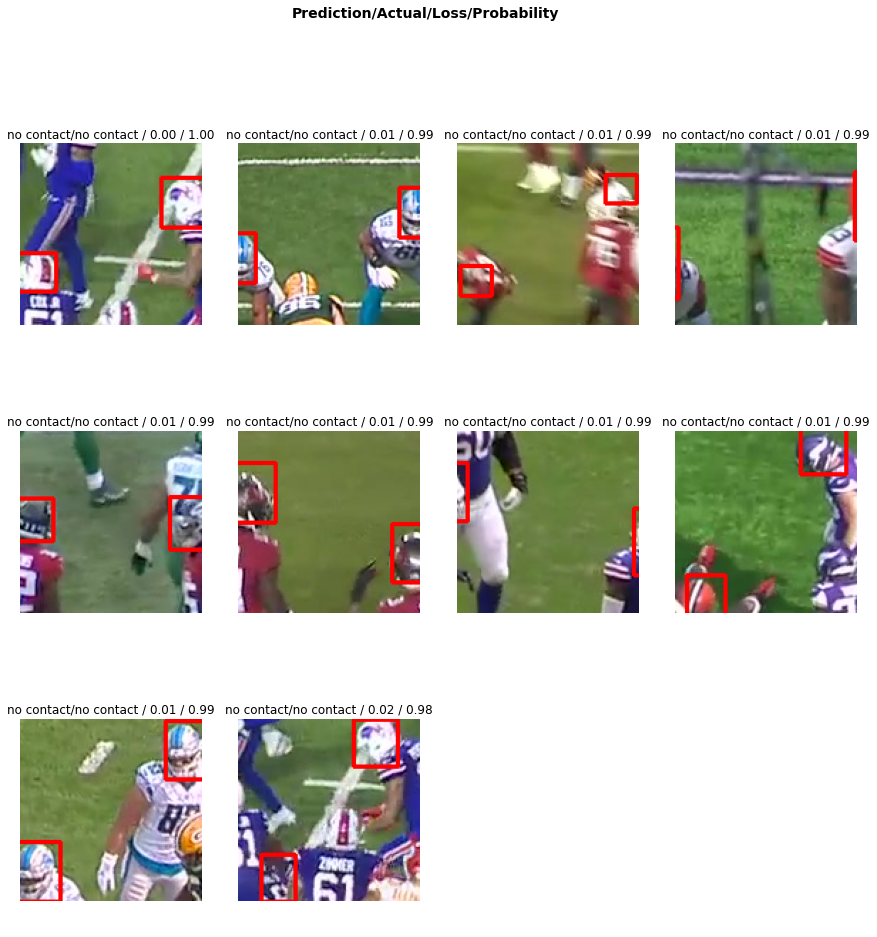

In [21]:
interp.plot_top_losses(k=10, largest=False, figsize=(15, 15))

#### Can I optimize the threshold to get better performance?

In [28]:
frames_df = get_frames_df(df_combo_with_helmets, kf_dict, split=0, frames_path=CFG.frames_path, sample_every_n_frame=1, sample_train=0.01, sample_val=0.1)
val_df = frames_df.query('is_valid').copy()

val_dl = learn.dls.test_dl(val_df, with_labels=True)
preds, _ = learn.get_preds(dl=val_dl) 

val_df.loc[:, 'contact_pred'] = preds.cpu().detach().numpy()[:, 1]
val_df = add_contact_id(val_df)

val_dist = df_combo[df_combo.game_play.isin(val_df.game_play.unique())].copy()

val_dist["distance"] = val_dist["distance"].fillna(99)  # Fill player to ground with 9    
val_dist_agg = val_dist.merge(val_df.groupby('contact_id', as_index=False).contact_pred.mean(), how='left', on='contact_id')

In [68]:
out = np.where(val_dist_agg['contact_pred'].isna() & val_dist_agg['distance'] <= 1,
               val_dist_agg['contact_pred'] > 0.7,
               val_dist['distance'] <= 1, 
               ).astype(int)
    
print('Baseline', matthews_corrcoef(val_dist_agg['contact'], (val_dist_agg['distance'] <= 1).astype(int)))
print('Model', matthews_corrcoef(val_dist_agg['contact'], out))

Baseline 0.5355998345848321
Model 0.16045169476746868


In [69]:
from sklearn.metrics import confusion_matrix

confusion_matrix(val_dist_agg['contact'], out, labels=[0, 1])

array([[928372,   7386],
       [ 10664,   1822]])

In [57]:
confusion_matrix(val_dist_agg['contact'], (val_dist_agg['distance'] <= 1).astype(int), labels=[0, 1])

array([[930054,   5704],
       [  5729,   6757]])

### Model 1

In [23]:
learn = load_learner(CFG.utils_path+'/model-1.pkl', cpu=cpu)
val_dl = learn.dls.test_dl(val_df, with_labels=True)
interp = ClassificationInterpretation.from_learner(learn, dl=val_dl)

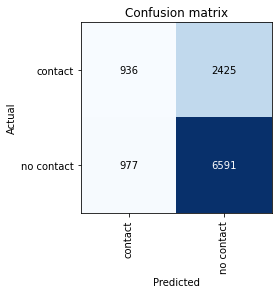

In [24]:
interp.plot_confusion_matrix()

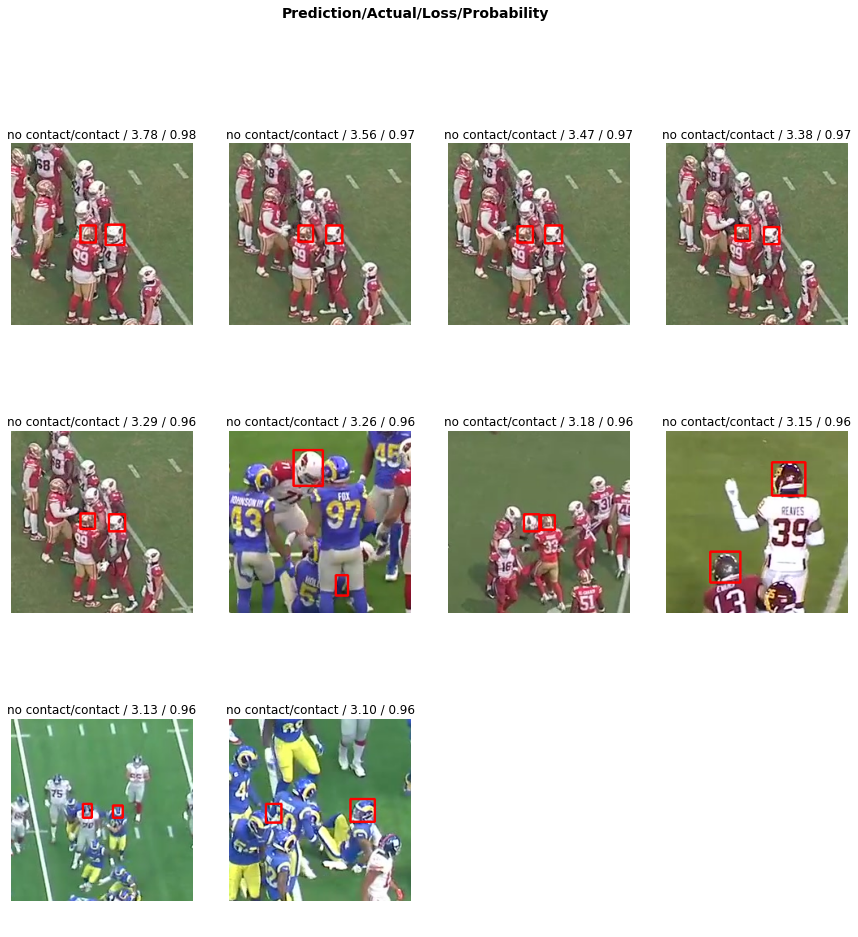

In [25]:
interp.plot_top_losses(k=10, largest=True, figsize=(15, 15))

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f7d9e5d51f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py", line 1481, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py", line 1464, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.9/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process


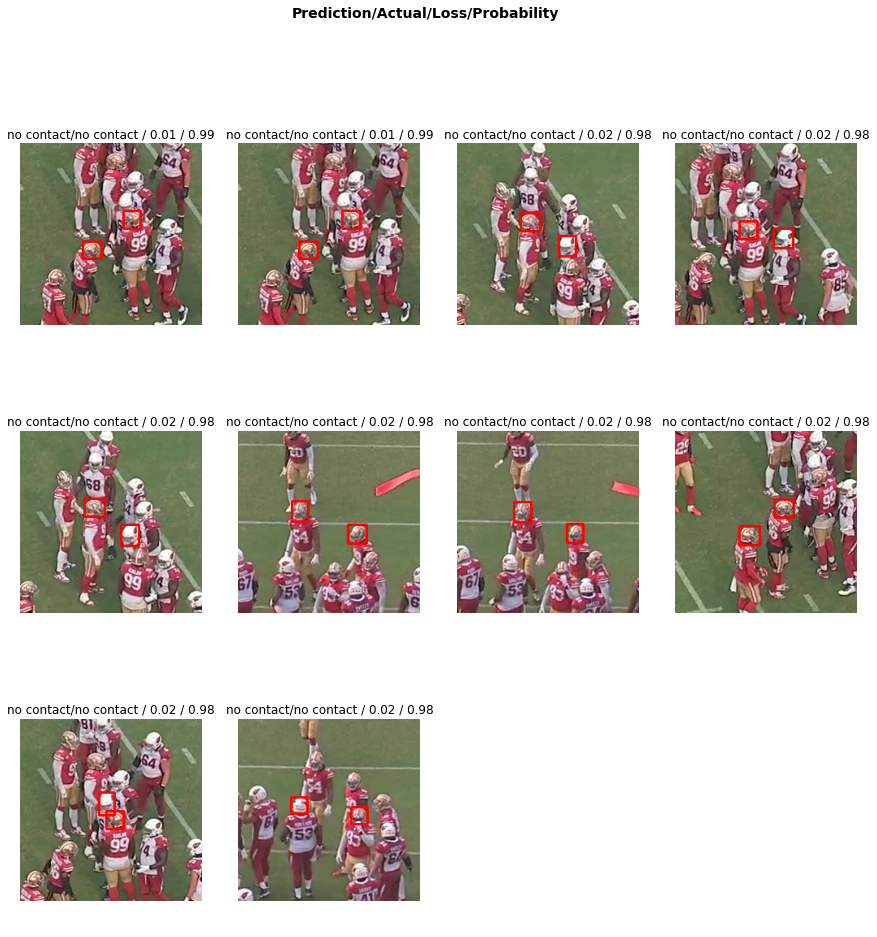

In [26]:
interp.plot_top_losses(k=10, largest=False, figsize=(15, 15))

## Validating the validation set

### Train multiple models on small training data

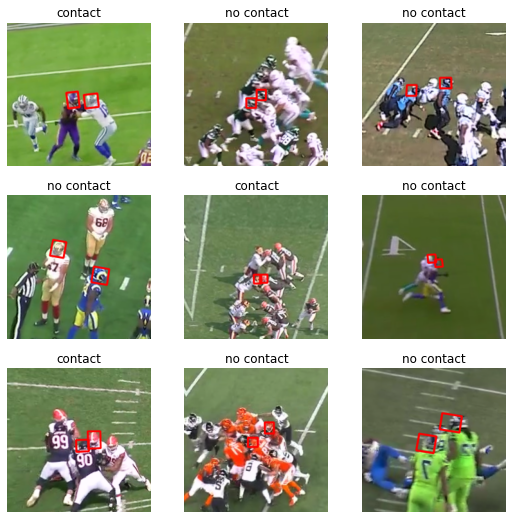

In [12]:
frames_df = get_frames_df(df_combo_with_helmets, kf_dict, split=0, frames_path=CFG.frames_path, sample_every_n_frame=3, sample_train=0.01, sample_val=0.01)
dls = get_dls(frames_df, img_size=224, batch_tfms=[*aug_transforms()])
dls.show_batch()

In [8]:
models = ['resnet18', 'convit_tiny', 'efficientnet_b0']

In [13]:
for i, model in enumerate(models):
    learn = get_learner(model, dls)
    print(model)
    learn.fine_tune(4)
    learn.export(f'nflutils/model-{i}.pkl')

resnet18


epoch,train_loss,valid_loss,accuracy,time
0,1.110089,0.807031,0.629203,00:26


epoch,train_loss,valid_loss,accuracy,time
0,0.800663,0.643330,0.678194,00:23
1,0.686186,0.582460,0.710855,00:28
2,0.601249,0.562168,0.704131,00:27
3,0.570386,0.556208,0.709894,00:24


convit_tiny


epoch,train_loss,valid_loss,accuracy,time
0,0.987439,0.642058,0.660903,00:29


epoch,train_loss,valid_loss,accuracy,time
0,0.776730,0.576529,0.710855,00:43
1,0.717986,0.572471,0.703170,00:40
2,0.650724,0.555811,0.717579,00:39
3,0.627945,0.559354,0.718540,00:42


Downloading: "https://github.com/rwightman/pytorch-image-models/releases/download/v0.1-weights/efficientnet_b0_ra-3dd342df.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_ra-3dd342df.pth


efficientnet_b0


epoch,train_loss,valid_loss,accuracy,time
0,1.165699,0.960654,0.635927,00:28


epoch,train_loss,valid_loss,accuracy,time
0,0.783672,0.747712,0.629203,00:34
1,0.687284,0.633136,0.666667,00:33
2,0.601139,0.607749,0.686840,00:38
3,0.569970,0.612889,0.673391,00:34


### Create full validation dataset

In [8]:
frames_df = get_frames_df(df_combo_with_helmets, kf_dict, split=0, frames_path=CFG.frames_path, sample_every_n_frame=1, sample_train=0.01, sample_val=None)
val_df = frames_df.query('is_valid').copy()

In [9]:
sample_val = [0.01, 0.03, 0.05, 0.07, 0.1, 0.3, 0.5, 0.7, 1]
sample_every_n_frame = [1, 2, 3, 4, 5, 6]

In [10]:
from collections import defaultdict

from sklearn.metrics import accuracy_score

In [11]:
comb_dict = {}
comb_results = defaultdict(list)
comb_results_acc = defaultdict(list)

In [12]:
models = ['resnet18', 'convit_tiny', 'efficientnet_b0']

In [13]:
for m, model in enumerate(models):
    print(model)
    cpu = not torch.cuda.is_available()
    learn = load_learner(f'nflutils/model-{m}.pkl', cpu=cpu)
    
    val_dl = learn.dls.test_dl(val_df, with_labels=True)
    preds, _ = learn.get_preds(dl=val_dl) 
    val_df.loc[:, 'contact_pred'] = preds.cpu().detach().numpy()[:, 0]
    val_df = add_contact_id(val_df)
    
    for i, sv in enumerate(tqdm(sample_val)):
        for j, se in enumerate(sample_every_n_frame):
            comb_dict[f'{i}_{j}'] = [sv, se]
            
            if sv == 1:
                val_df_sample = val_df.copy()
            else:
                val_df_sample = val_df.query('(290 - frame) % @se == 0').sample(frac=sv, random_state=CFG.seed).copy()

            val_dist = df_combo[df_combo.game_play.isin(val_df_sample.game_play.unique())].copy()
            val_dist["distance"] = val_dist["distance"].fillna(99)  # Fill player to ground with 9 

            val_dist_agg = val_dist.merge(val_df_sample.groupby('contact_id', as_index=False).contact_pred.mean(), how='left', on='contact_id')

            out = np.where(val_dist_agg['contact_pred'].isna(),
                           val_dist_agg['distance'] <= 1, 
                           val_dist_agg['contact_pred'] > 0.3).astype(int)

            comb_results[f'{i}_{j}'].append(matthews_corrcoef(val_dist_agg['contact'], out))
            comb_results_acc[f'{i}_{j}'].append(accuracy_score(val_df_sample['contact'], val_df_sample['contact_pred'] > 0.3))

resnet18


  0%|          | 0/9 [00:00<?, ?it/s]

convit_tiny


  0%|          | 0/9 [00:00<?, ?it/s]

efficientnet_b0


  0%|          | 0/9 [00:00<?, ?it/s]

In [14]:
comb_results = pd.DataFrame(comb_results, index=[models])
comb_results.to_csv('comb_results_1.csv')

comb_results_acc = pd.DataFrame(comb_results_acc, index=[models])
comb_results_acc.to_csv('comb_results_acc_1.csv')

In [15]:
comb_results.shape

(3, 54)

In [16]:
comb_results.head()

,0_0,0_1,0_2,0_3,0_4,0_5,1_0,1_1,1_2,1_3,...,7_2,7_3,7_4,7_5,8_0,8_1,8_2,8_3,8_4,8_5
resnet18,0.533623,0.533623,0.533623,0.533194,0.531479,0.533623,0.531715,0.531715,0.531715,0.533358,...,0.487948,0.510096,0.523006,0.487948,0.489995,0.489995,0.489995,0.489995,0.489995,0.489995
convit_tiny,0.533107,0.533107,0.533107,0.532747,0.531366,0.533107,0.528042,0.528042,0.528042,0.532703,...,0.458090,0.494195,0.516621,0.458090,0.456357,0.456357,0.456357,0.456357,0.456357,0.456357
efficientnet_b0,0.532975,0.532975,0.532975,0.532724,0.531415,0.532975,0.528899,0.528899,0.528899,0.531549,...,0.463610,0.493834,0.516850,0.463610,0.461774,0.461774,0.461774,0.461774,0.461774,0.461774


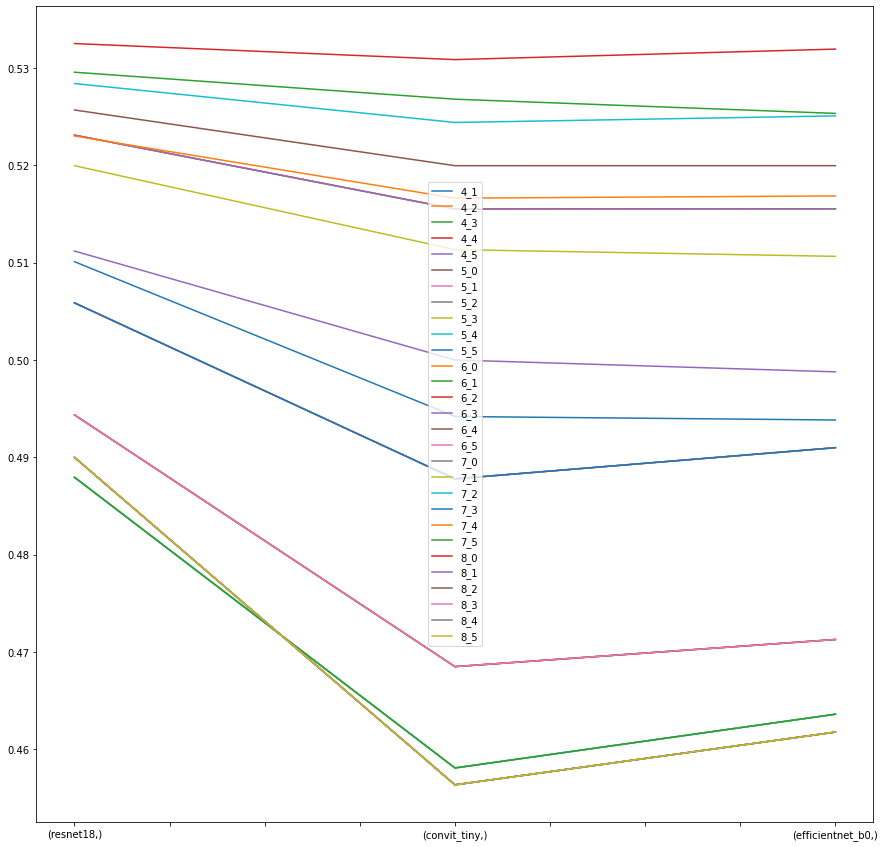

In [17]:
comb_results.iloc[:, 25:].plot(kind='line', figsize=(15, 15));

In [18]:
comb_results['LB'] = [0.393, 0.419, 0.412]

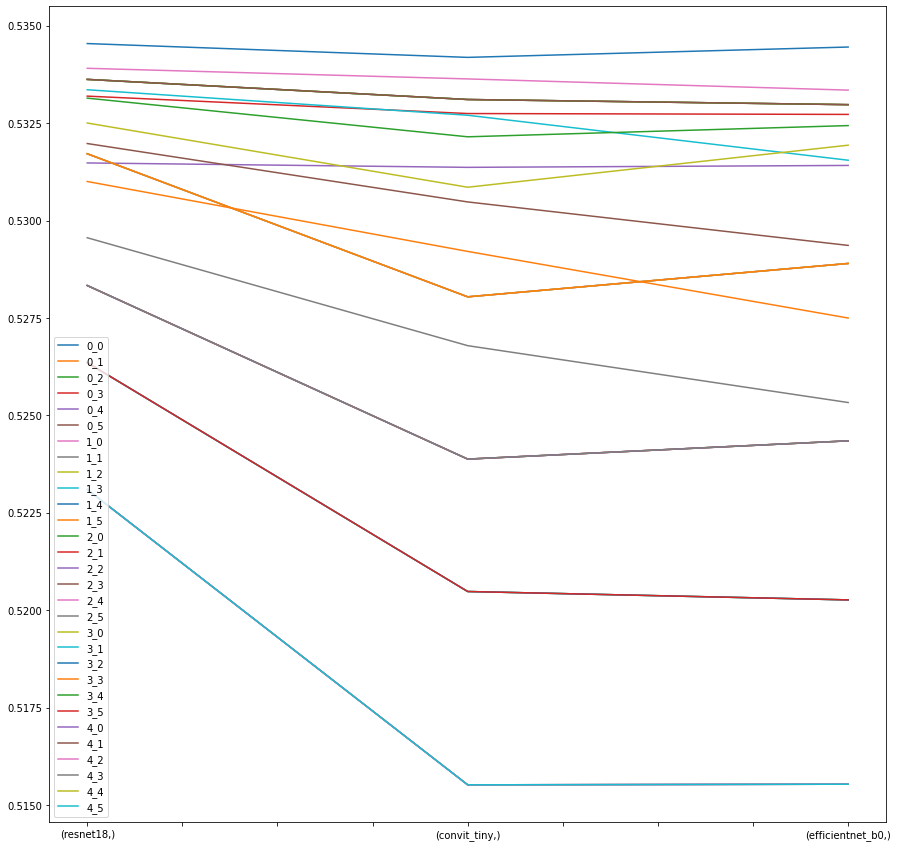

In [19]:
comb_results.iloc[:, :30].plot(kind='line', figsize=(15, 15));

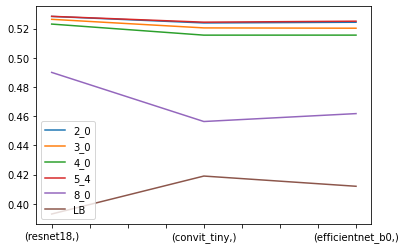

In [20]:
comb_results[['2_0', '3_0', '4_0', '5_4', '8_0', 'LB']].plot();

In [101]:
comb_dict['3_1']

[0.07, 2]

Since 4_0 is the one closest to the actual validation set and the leaderboard, I think that's the one I'll be going with for pipeline validation. 

It follows then about how I should deal with validation during training.

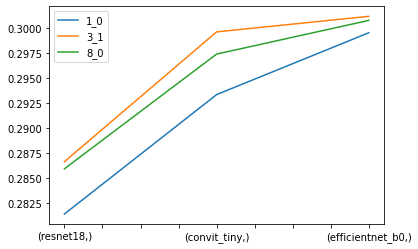

In [108]:
comb_results_acc[['1_0', '3_1', '8_0']].plot();

I guess I can use any of these while training then.